# Load our video file into memory

Welcome to foosbot

In [1]:
#!pip install keras
#!pip install numpy
#!pip install imageio
#!pip install matplotlib
#!pip install opencv-python

In [1]:
from __future__ import print_function


from video_file import *

import importlib
try:
    importlib.reload(video_file)
except:
    pass

import cv2
import sys
import os
import csv
import numpy as np
from random import randint
from random import shuffle

from PIL import Image
import imageio
import itertools as it

import tensorflow as tf
import keras
print("Keras version %s" % keras.__version__)
from keras.models import Sequential
from keras.layers import Dense, Dropout
from keras import backend as K

print("Tensorflow version %s" % tf.__version__)

import pprint
pp = pprint.PrettyPrinter(depth=6)


# Create the image transformer
transformer = VideoTransform( zoom_range=0.1, rotation_range=20, width_shift_range=0.1, height_shift_range=0.1, shear_range= 0.1, fill_mode='nearest', vertical_flip=False, horizontal_flip=True, horizontal_flip_invert_indices = [], horizontal_flip_reverse_indices = [0,1,2,3,4,5], data_format='channels_last' )


# Paths relative to current python file.
data_path  = ".\\..\\..\\TrainingData\\Processed\\\AmateurDefender\\Result\\settings.tsv"

Using TensorFlow backend.


Keras version 2.0.4
Tensorflow version 1.1.0


In [2]:
print("Opening training frames from config %s." % (data_path))
position_rel_indexes = [0, 3] # Predict current rod positions and future position in 2 frames

number_of_frames = 3
frame_rel_indexes = []
for i in range(number_of_frames):
    frame_rel_indexes += [i - number_of_frames + 1]

pp.pprint(frame_rel_indexes)
#frame_rel_indexes = [-4, -3, -2, -1, 0] # Use 5 frames as input


training = TrainingInput(transformer, data_path, position_rel_indexes, frame_rel_indexes, 0.2)


Opening training frames from config .\..\..\TrainingData\Processed\\AmateurDefender\Result\settings.tsv.
[-2, -1, 0]
Creating training chunk from .\..\..\TrainingData\Processed\\AmateurDefender\Result\chunk0.avi
.\..\..\TrainingData\Processed\\AmateurDefender\Result\chunk0.avi
added 15932 new frames for a total of 15932
Creating training chunk from .\..\..\TrainingData\Processed\\AmateurDefender\Result\chunk1.avi
.\..\..\TrainingData\Processed\\AmateurDefender\Result\chunk1.avi
added 22943 new frames for a total of 38875
Creating training chunk from .\..\..\TrainingData\Processed\\AmateurDefender\Result\chunk2.avi
.\..\..\TrainingData\Processed\\AmateurDefender\Result\chunk2.avi
added 11297 new frames for a total of 50172


In [7]:
# Define our training and validation iterators

# https://stanford.edu/~shervine/blog/keras-generator-multiprocessing.html
class threadsafe_iter(object):
  """
    Takes an iterator/generator and makes it thread-safe by
    serializing call to the `next` method of given iterator/generator.
    """
  def __init__(self, it):
      self.it = it
      self.lock = threading.Lock()

  def __iter__(self):
      return self

  def __next__(self):
      with self.lock:
          return self.it.__next__()

# https://stanford.edu/~shervine/blog/keras-generator-multiprocessing.html
def threadsafe_generator(f):
  """
    A decorator that takes a generator function and makes it thread-safe.
    """
  def g(*a, **kw):
      return threadsafe_iter(f(*a, **kw))
  return g



# Define our training and validation iterators
@threadsafe_generator
def TrainGen(model, training):
    while True:
        #print("TrainGen restarting training input.")
        model.reset_states()
        training.move_first_training_frame()
        (frames, output, reset_memory) = training.get_next_training_frame()
        while frames is not None:
            yield (frames, output)
            (frames, output, reset_memory) = training.get_next_training_frame()
            
            if reset_memory or frames is None:
                model.reset_states()
                
@threadsafe_generator
def ValidateGen(model, training):
    while True:
        #print("Validation restarting training input.")
        model.reset_states()
        training.move_first_validation_frame()
        (frames, output, reset_memory) = training.get_next_validation_frame()
        while frames is not None:
            yield (frames, output)
            (frames, output, reset_memory) = training.get_next_validation_frame()
            
            if reset_memory or frames is None:
                model.reset_states()

# Generators for training the position
@threadsafe_generator
def TrainBatchGen(batch_size, model, training):
    gen = TrainGen(model, training)
    while True:
        # Build the next batch
        batch_frames = np.zeros(shape=(batch_size, training.depth, training.height, training.width, training.channels), dtype=np.float32)
        batch_outputs = np.zeros(shape=(batch_size, 3), dtype=np.float32)
        for i in range(batch_size):
            (frames, output) = next(gen)
            batch_frames[i,:,:,:,:] = frames
            batch_outputs[i,:] = output[0:3] # Train just the 3 current rod positions as outputs
            #batch_outputs[i,:] = output[3:6] - output[0:3] # Train the difference in the three rod positions as output
            #batch_outputs[i,:] = output
            
        
        #pp.pprint("Yielding batch")
        #pp.pprint(batch_outputs)
        yield (batch_frames, batch_outputs)
        #pp.pprint("Yielded batch")

        
@threadsafe_generator
def ValidateBatchGen(batch_size, model, training):
    gen = ValidateGen(model, training)
    while True:
        # Build the next batch
        batch_frames = np.zeros(shape=(batch_size, training.depth, training.height, training.width, training.channels), dtype=np.float32)
        batch_outputs = np.zeros(shape=(batch_size, 3), dtype=np.float32)
        for i in range(batch_size):
            (frames, output) = next(gen)
            batch_frames[i,:,:,:,:] = frames
            batch_outputs[i,:] = output[0:3] # Train just the 3 current rod positions as outputs
            #batch_outputs[i,:] = output[3:6] - output[0:3] # Train the difference in the three rod positions as output
            #batch_outputs[i,:] = output
        
        #pp.pprint("Yielding batch")
        #pp.pprint(batch_outputs)
        yield (batch_frames, batch_outputs)
        #pp.pprint("Yielded batch")

        
@threadsafe_generator
def TrainBatchGenDpos(batch_size, model, training):
    gen = TrainGen(model, training)
    while True:
        # Build the next batch
        batch_frames = np.zeros(shape=(batch_size, training.depth, training.height, training.width, training.channels), dtype=np.float32)
        batch_outputs = np.zeros(shape=(batch_size, 3), dtype=np.float32)
        for i in range(batch_size):
            (frames, output) = next(gen)
            batch_frames[i,:,:,:,:] = frames
            batch_outputs[i,0] = output[3] - output[0] # Train the difference in the three rod positions as output
            batch_outputs[i,1] = output[4] - output[1]
            batch_outputs[i,2] = output[5] - output[2]
            #batch_outputs[i,:] = output[3:6] - output[0:3] # Train the difference in the three rod positions as output
            #batch_outputs[i,:] = output
            
        
        #pp.pprint("Yielding batch")
        #pp.pprint(batch_outputs)
        yield (batch_frames, batch_outputs)
        #pp.pprint("Yielded batch")

        
@threadsafe_generator
def ValidateBatchGenDpos(batch_size, model, training):
    gen = ValidateGen(model, training)
    while True:
        # Build the next batch
        batch_frames = np.zeros(shape=(batch_size, training.depth, training.height, training.width, training.channels), dtype=np.float32)
        batch_outputs = np.zeros(shape=(batch_size, 3), dtype=np.float32)
        for i in range(batch_size):
            (frames, output) = next(gen)
            batch_frames[i,:,:,:,:] = frames
            batch_outputs[i,0] = output[3] - output[0] # Train the difference in the three rod positions as output
            batch_outputs[i,1] = output[4] - output[1]
            batch_outputs[i,2] = output[5] - output[2]
            #batch_outputs[i,:] = output[3:6] - output[0:3] # Train the difference in the three rod positions as output
            #batch_outputs[i,:] = output
        
        #pp.pprint("Yielding batch")
        #pp.pprint(batch_outputs)
        yield (batch_frames, batch_outputs)
        #pp.pprint("Yielded batch")

    
# Helper function to plot our validation result
import matplotlib
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import cv2
import pandas as pd
%matplotlib inline


def plot_validate(generator, model, count, name):
    #plot_validate(ValidateBatchGen(batch_size, model), model, 2000, "Position prediction")
    
    outputs_predicted = None
    outputs_true = None
    
    while outputs_predicted is None or outputs_predicted.shape[0] < count:
        
        (new_frames, new_outputs_true) = next(generator)
        if outputs_true is None:
            outputs_true = new_outputs_true
        else:
            outputs_true = np.concatenate( (outputs_true, new_outputs_true), axis=0 )
        
        
        new_outputs_predicted = model.predict(new_frames, batch_size=new_frames.shape[0], verbose=0)
        if outputs_predicted is None:
            outputs_predicted = new_outputs_predicted
        else:
            outputs_predicted = np.concatenate( (outputs_predicted, new_outputs_predicted), axis=0 )
    
    #(frames, outputs_true) = next(ValidateBatchGen(2000))
    #frames = np.squeeze(frames, axis=(1,))
    #validate_in, validate_out
    #frames = validate_in
    #outputs_true =validate_out
    
    print("Predicted.")
    
    
    pp.pprint(outputs_true)
    pp.pprint(outputs_predicted)
    
    
    plt.figure(figsize=(8,30))
    
    plt.subplot(611)
    plt.plot(range(count),outputs_true[0:count,0], range(count),outputs_predicted[0:count,0] )
    plt.ylabel("Rod 1: %s" % name)
    plt.title("First 200 output recordings")
    plt.grid(True)
    
    plt.subplot(612)
    plt.plot(range(count),outputs_true[0:count,1], range(count),outputs_predicted[0:count,1] )
    plt.ylabel("Rod 2: %s" % name)
    plt.title("First output recordings")
    plt.grid(True)
    
    plt.subplot(613)
    plt.plot(range(count),outputs_true[0:count,2], range(count),outputs_predicted[0:count,2] )
    plt.ylabel("Rod 3: %s" % name)
    plt.title("First output recordings")
    plt.grid(True)
    
    
    
    plt.figure(figsize=(8,30))
    plt.subplot(611)
    
    true, predicted = zip(*sorted(zip(outputs_true[0:count,0], outputs_predicted[0:count,0])))
    plt.plot(range(count),true, range(count),predicted )
    plt.ylabel("Rod 1: %s" % name)
    plt.title("First 200 output recordings")
    plt.grid(True)
    
    plt.subplot(612)
    true, predicted = zip(*sorted(zip(outputs_true[0:count,1], outputs_predicted[0:count,1])))
    plt.plot(range(count),true, range(count),predicted, marker='.', markersize = 2, linewidth =0.1, markerfacecolor='black')
    plt.ylabel("Rod 2: %s" % name)
    plt.grid(True)
    
    plt.subplot(613)
    true, predicted = zip(*sorted(zip(outputs_true[0:count,2], outputs_predicted[0:count,2])))
    plt.plot(range(count),true, range(count),predicted, marker='.', markersize = 2, linewidth =0.1, markerfacecolor='black')
    plt.ylabel("Rod 3: %s" % name)
    plt.grid(True)
    
    
    plt.show()
          
def mse(y_true, y_pred):
    return K.square(y_pred - y_true)*0.001 # Hackjob so Keras iterations show exponential value of MSE to get precision.


# Input training frame

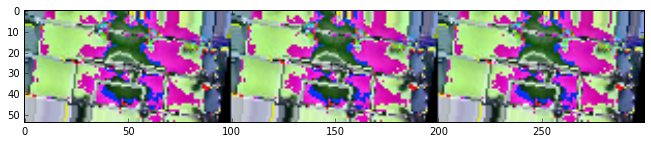

[0.9818181818181818,
 0.9918032786885246,
 0.9891891891891892,
 0.9818181818181818,
 0.9918032786885246,
 0.9567567567567568]


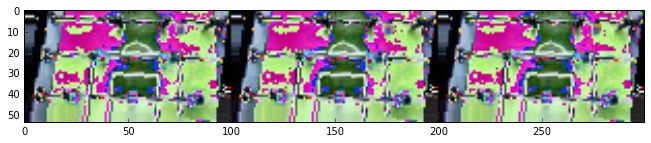

[0.41818181818181815,
 0.42780748663101603,
 0.5773195876288659,
 0.41818181818181815,
 0.48128342245989303,
 0.570446735395189]


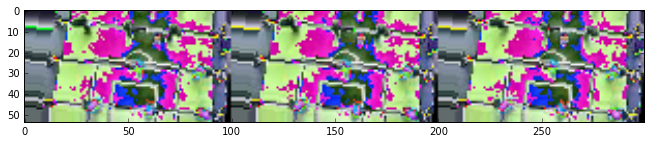

[0.6121212121212121,
 0.7662337662337663,
 0.12420382165605096,
 0.38181818181818183,
 0.6926406926406926,
 0.19745222929936307]


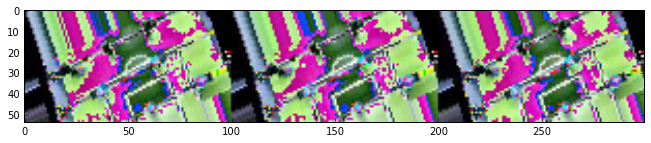

[0.4303030303030303,
 0.28342245989304815,
 0.07216494845360824,
 0.43636363636363634,
 0.27807486631016043,
 0.07216494845360824]


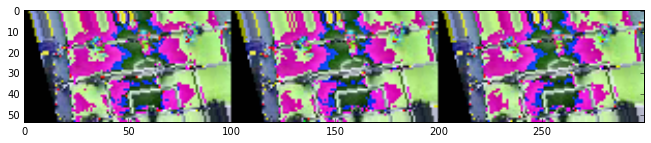

[0.32727272727272727,
 0.38524590163934425,
 0.508108108108108,
 0.2787878787878788,
 0.4590163934426229,
 0.4864864864864865]


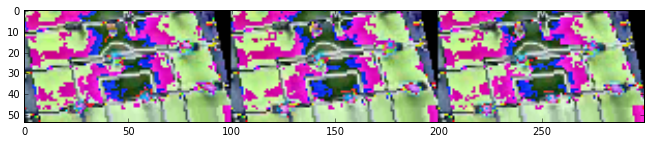

[0.6,
 0.7532467532467533,
 0.44904458598726116,
 0.37575757575757573,
 0.5930735930735931,
 0.4267515923566879]


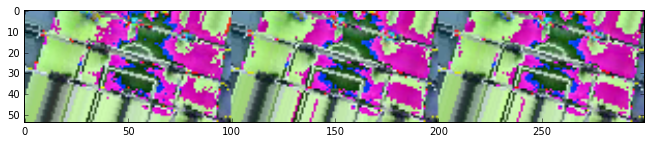

[0.5454545454545454,
 0.45901639344262296,
 0.372972972972973,
 0.5454545454545454,
 0.3975409836065574,
 0.3621621621621622]


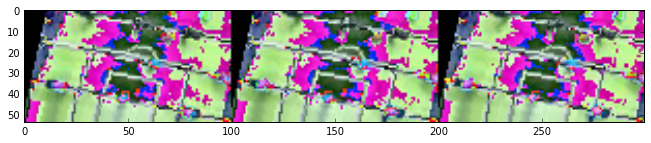

[0.3090909090909091,
 1,
 0.6178343949044586,
 0.406060606060606,
 1,
 0.5159235668789809]


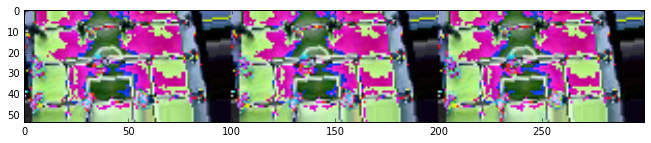

[0.024242424242424288,
 0.04278074866310155,
 0.4192439862542955,
 0.024242424242424288,
 0.04278074866310155,
 0.4192439862542955]


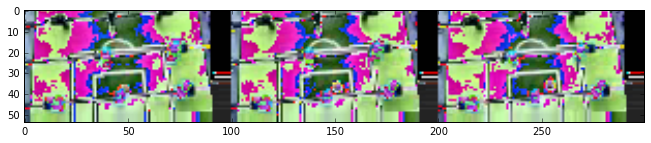

[0.4303030303030303,
 0.7165775401069518,
 0.7285223367697594,
 0.42424242424242425,
 0.6684491978609626,
 0.718213058419244]
Shape of training input:
(3, 54, 100, 3)
Shape of training output:
(6,)
Corresponding Positions:
[0.4303030303030303,
 0.7165775401069518,
 0.7285223367697594,
 0.42424242424242425,
 0.6684491978609626,
 0.718213058419244]


In [4]:
import matplotlib
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import cv2
import pandas as pd
%matplotlib inline

training.move_first_training_frame()

for k in range(10):
    (frame, position, reset) = training.get_next_training_frame()
    data = np.zeros(shape=(np.shape(frame)[1], np.shape(frame)[2] * np.shape(frame)[0], 3), dtype=np.float32)
    for i in range(np.shape(frame)[0]):
        tmp = frame[i,:,:,:]
        data[:,i*np.shape(frame)[2]:(i+1)*np.shape(frame)[2],:] = tmp


    fig, ax = plt.subplots(figsize=(18, 2))
    plt.imshow(data)
    plt.show()
    pp.pprint(position)

training.move_first_training_frame()

print("Shape of training input:")
pp.pprint(np.shape(frame))

print("Shape of training output:")
pp.pprint(np.shape(position))

print("Corresponding Positions:")
pd.DataFrame(position)
pp.pprint(position)




# Specify the model structure we will use

In [5]:
from keras.models import Sequential
from keras.layers import *
from keras.models import Model



image_height       = training.height
image_width        = training.width
image_depth        = training.depth
image_channels     = training.channels
output_size        = 3

# Model options
batch_size = 10
lstm_output_size = 300
cnn_kernel_count = 60

# Build the model
pp.pprint("Input shape without batches:")
pp.pprint((image_depth, image_height, image_width, image_channels))

# Used to give fixed names to the layers for transferring the model
conv_num = 0 
pool_num = 0
dense_num = 0

# Build a functional model design
inputs = Input(shape=(number_of_frames, image_height, image_width, image_channels,),
              name="Input")
x = Conv3D(cnn_kernel_count,
           kernel_size = (3, 3, 3),
           padding = "same",
           activation = "relu",
           name = "conv3d_%i"%conv_num)(inputs)
conv_num+=1

x = Conv3D(cnn_kernel_count,
           kernel_size = (3, 3, 3),
           padding = "same",
           activation = "relu",
           name = "conv3d_%i"%conv_num)(x)
conv_num+=1

# Split into a horizontal detail and vertical detailed CNN paths
x = MaxPooling3D( pool_size=(1, 2, 2),
                  name = "max_pooling3d_%i"%pool_num)(x) # (?, 1, 54, 100, 128, 3 )
pool_num+=1

x = Conv3D(cnn_kernel_count,
           kernel_size = (3, 3, 3),
           padding = "same",
           activation = "relu",
           name = "conv3d_%i"%conv_num)(x)
conv_num+=1
x = Conv3D(cnn_kernel_count,
           kernel_size = (3, 3, 3),
           padding = "same",
           activation = "relu",
           name = "conv3d_%i"%conv_num)(x)
conv_num+=1

x = MaxPooling3D( pool_size=(3, 2, 2),
                  name = "max_pooling3d_%i"%pool_num)(x) # (?, 1, 54, 100, 128, 3 )
pool_num+=1

x = Conv3D(cnn_kernel_count,
           kernel_size = (1, 3, 3),
           padding = "same",
           activation = "relu",
           name = "conv3d_%i"%conv_num)(x)
conv_num+=1
x = Conv3D(cnn_kernel_count,
           kernel_size = (1, 3, 3),
           padding = "same",
           activation = "relu",
           name = "conv3d_%i"%conv_num)(x)
conv_num+=1
x = MaxPooling3D( pool_size=(1, 2, 2),
                  name = "max_pooling3d_%i"%pool_num)(x) # (?, 1, 54, 100, 128, 3 )
pool_num+=1

x = Conv3D(cnn_kernel_count,
           kernel_size = (1, 3, 3),
           padding = "same",
           activation = "relu",
           name = "conv3d_%i"%conv_num)(x)
conv_num+=1
x = Conv3D(cnn_kernel_count,
           kernel_size = (1, 3, 3),
           padding = "same",
           activation = "relu",
           name = "conv3d_%i"%conv_num)(x)
conv_num+=1
x = MaxPooling3D( pool_size=(1, 1, 2),
                  name = "max_pooling3d_%i"%pool_num)(x) # (?, 1, 54, 100, 128, 3 )
pool_num+=1




#x = Flatten()(x)
#x = Reshape((number_of_frames,6*6*cnn_kernel_count))(x)
x = Flatten()(x)


x = Dense(128, activation='relu',name="dense_%i"%dense_num)(x)
dense_num+=1
x = Dropout(0.5)(x)
x = Dense(64, activation='relu',name="dense_%i"%dense_num)(x)
dense_num+=1
x = Dropout(0.5)(x)
x = Dense(64, activation='relu',name="dense_%i"%dense_num)(x)
dense_num+=1
x = Dropout(0.5)(x)
predictions = Dense(3, activation='linear',name="dense_%i"%dense_num)(x)
dense_num+=1

model = Model(inputs=inputs, outputs=predictions)


# For a multi-class classification problem
model.compile(optimizer=keras.optimizers.RMSprop(lr=0.0001),
              loss='mean_squared_error',
              metrics=['accuracy'])


model.summary()


'Input shape without batches:'
(3, 54, 100, 3)
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
Input (InputLayer)           (None, 3, 54, 100, 3)     0         
_________________________________________________________________
conv3d_0 (Conv3D)            (None, 3, 54, 100, 60)    4920      
_________________________________________________________________
conv3d_1 (Conv3D)            (None, 3, 54, 100, 60)    97260     
_________________________________________________________________
max_pooling3d_0 (MaxPooling3 (None, 3, 27, 50, 60)     0         
_________________________________________________________________
conv3d_2 (Conv3D)            (None, 3, 27, 50, 60)     97260     
_________________________________________________________________
conv3d_3 (Conv3D)            (None, 3, 27, 50, 60)     97260     
_________________________________________________________________
max_pooling3d_1 (MaxPooling3 

# Train our model to identify the rod positions

Updated learner.
Batch size 10: 4013 training batches, 1001 validation batches
Epoch 1/1
4013/4013 [==============================] - 741s - loss: 0.0961 - mse: 9.6141e-05 - val_loss: 0.0442 - val_mse: 4.4220e-05
Wrote model to pos_cnn_weights_0.hdf
Predicted.
array([[ 0.40606061,  0.78074867,  0.19243987],
       [ 0.43030304,  0.13368984,  0.09965636],
       [ 0.43030304,  0.5026738 ,  0.57731956],
       ..., 
       [ 0.43030304,  0.78074867,  1.        ],
       [ 0.58181816,  0.16042781,  0.28522336],
       [ 0.43030304,  0.96256685,  0.30927834]], dtype=float32)
array([[ 0.54237479,  0.63074183,  0.54047531],
       [ 0.31768197,  0.18837868,  0.33897567],
       [ 0.48171246,  0.50947785,  0.47123405],
       ..., 
       [ 0.52378768,  0.5693419 ,  0.56850761],
       [ 0.38592961,  0.27414951,  0.4138872 ],
       [ 0.5860762 ,  0.69018281,  0.56873369]], dtype=float32)


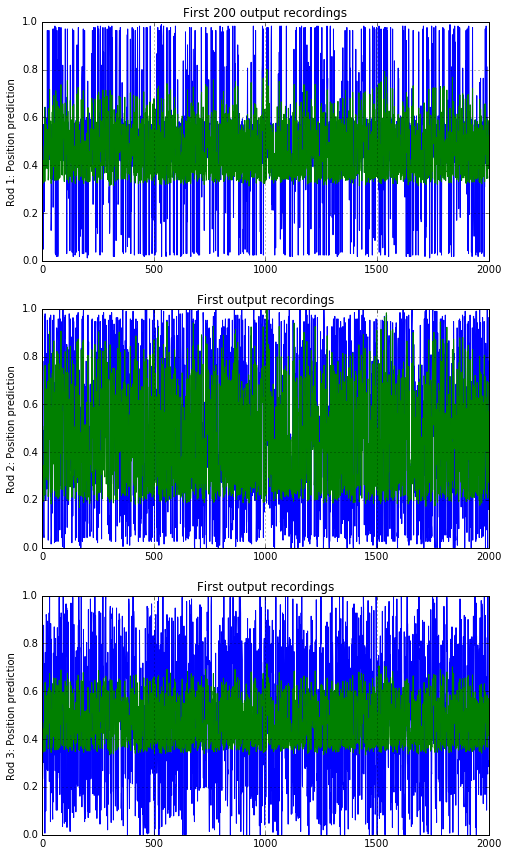

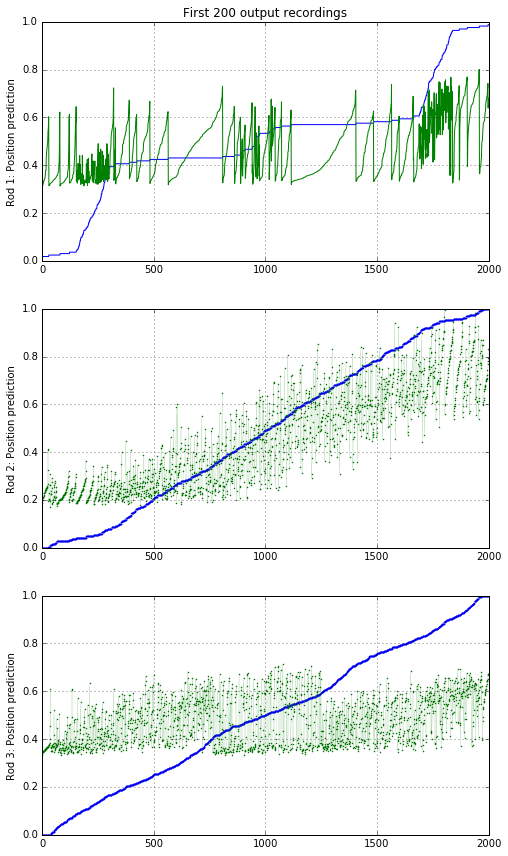

Epoch 2/2
4013/4013 [==============================] - 720s - loss: 0.0500 - mse: 4.9954e-05 - val_loss: 0.0303 - val_mse: 3.0337e-05
Wrote model to pos_cnn_weights_1.hdf
Predicted.
array([[ 0.43030304,  0.36065573,  0.32432431],
       [ 0.56969696,  0.44672132,  0.40000001],
       [ 0.9818182 ,  0.5942623 ,  0.56216216],
       ..., 
       [ 0.56969696,  0.49180329,  0.51891893],
       [ 0.55757576,  0.68032789,  0.1027027 ],
       [ 0.5030303 ,  0.61885244,  0.26486486]], dtype=float32)
array([[ 0.34878737,  0.2608861 ,  0.3567318 ],
       [ 0.48351496,  0.39318401,  0.50928944],
       [ 0.68510681,  0.52820212,  0.6314519 ],
       ..., 
       [ 0.57621086,  0.53429025,  0.51534218],
       [ 0.44175023,  0.59227073,  0.41608256],
       [ 0.46120781,  0.64338285,  0.4181937 ]], dtype=float32)


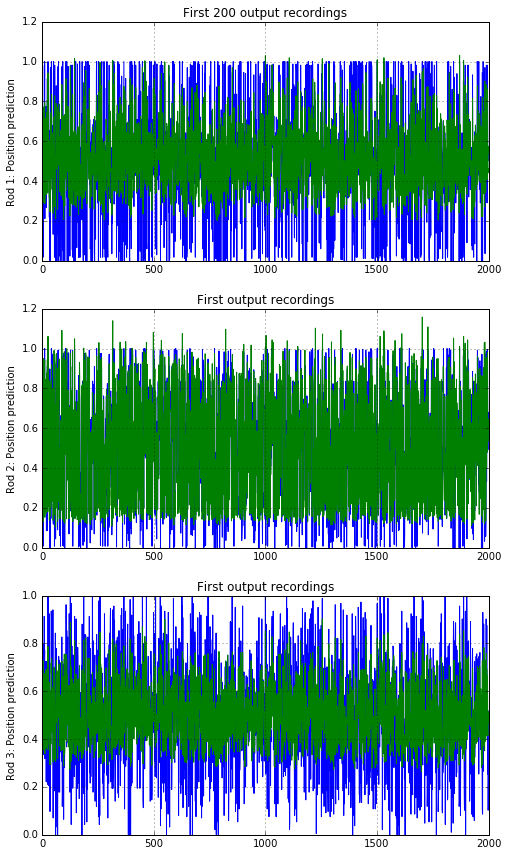

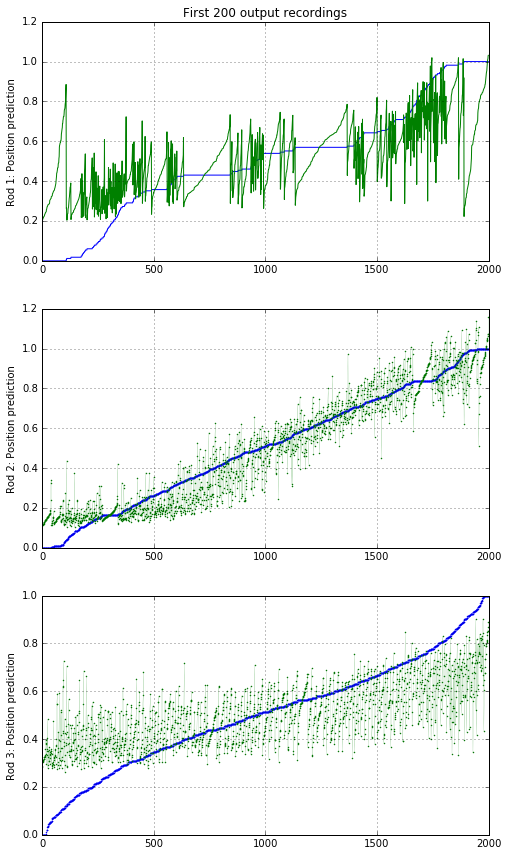

Epoch 3/3
4013/4013 [==============================] - 721s - loss: 0.0411 - mse: 4.1136e-05 - val_loss: 0.0315 - val_mse: 3.1515e-05
Wrote model to pos_cnn_weights_2.hdf
Predicted.
array([[ 0.56969696,  0.63934427,  0.67567569],
       [ 0.56969696,  0.44672132,  0.40000001],
       [ 0.9818182 ,  0.5942623 ,  0.56216216],
       ..., 
       [ 0.43030304,  0.50819671,  0.48108107],
       [ 0.44242424,  0.31967214,  0.89729732],
       [ 0.5030303 ,  0.61885244,  0.26486486]], dtype=float32)
array([[ 0.61528814,  0.62574148,  0.6425463 ],
       [ 0.53179425,  0.46542656,  0.49918434],
       [ 0.65143049,  0.58264291,  0.54252833],
       ..., 
       [ 0.47672576,  0.53446537,  0.438631  ],
       [ 0.46524346,  0.37111065,  0.49607331],
       [ 0.47864884,  0.59514004,  0.40655494]], dtype=float32)


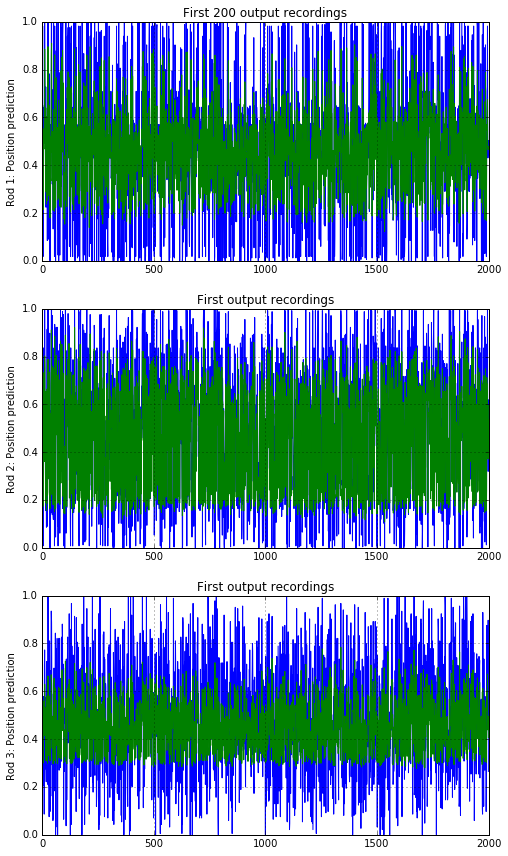

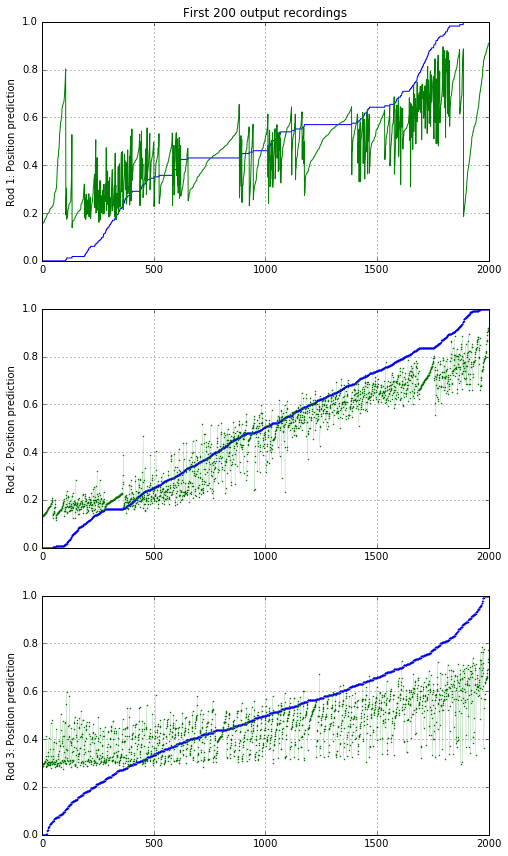

Epoch 4/4
4013/4013 [==============================] - 721s - loss: 0.0362 - mse: 3.6187e-05 - val_loss: 0.0238 - val_mse: 2.3772e-05
Wrote model to pos_cnn_weights_3.hdf
Predicted.
array([[ 0.40606061,  0.78074867,  0.19243987],
       [ 0.43030304,  0.13368984,  0.09965636],
       [ 0.56969696,  0.4973262 ,  0.42268041],
       ..., 
       [ 0.43030304,  0.78074867,  1.        ],
       [ 0.58181816,  0.16042781,  0.28522336],
       [ 0.56969696,  0.03743315,  0.69072163]], dtype=float32)
array([[ 0.47291476,  0.6823743 ,  0.37116393],
       [ 0.33392233,  0.22788358,  0.31119862],
       [ 0.55992031,  0.52262819,  0.67288303],
       ..., 
       [ 0.41519451,  0.65291107,  0.57838356],
       [ 0.55355334,  0.15169179,  0.49200314],
       [ 0.52862632,  0.16822341,  0.45548251]], dtype=float32)


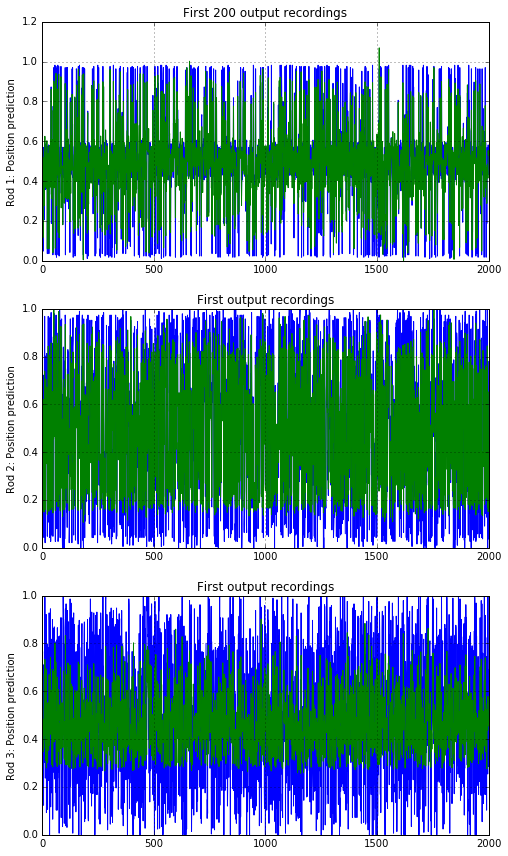

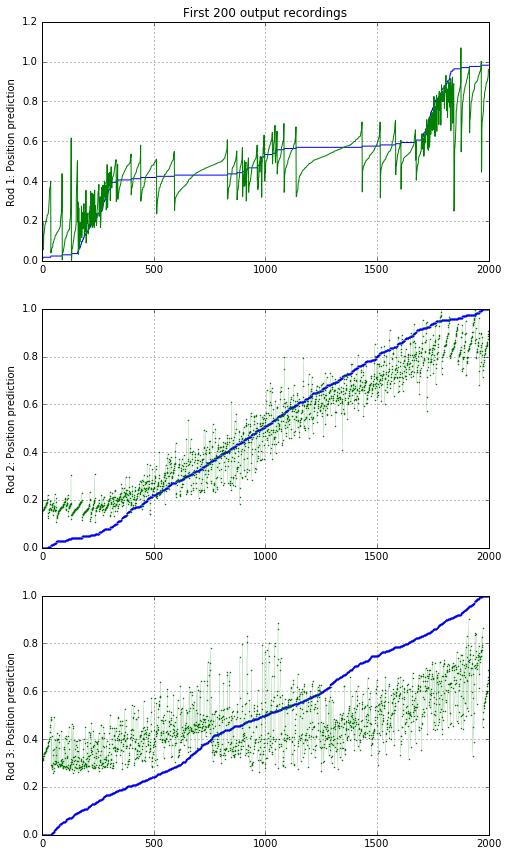

Epoch 5/5
4013/4013 [==============================] - 720s - loss: 0.0330 - mse: 3.2989e-05 - val_loss: 0.0190 - val_mse: 1.8982e-05
Wrote model to pos_cnn_weights_4.hdf
Predicted.
array([[ 0.56969696,  0.63934427,  0.67567569],
       [ 0.43030304,  0.55327868,  0.60000002],
       [ 0.9818182 ,  0.5942623 ,  0.56216216],
       ..., 
       [ 0.56969696,  0.49180329,  0.51891893],
       [ 0.55757576,  0.68032789,  0.1027027 ],
       [ 0.4969697 ,  0.38114753,  0.73513514]], dtype=float32)
array([[ 0.65561599,  0.62461197,  0.66637814],
       [ 0.49755564,  0.53157914,  0.47492784],
       [ 0.67766124,  0.59893209,  0.63956499],
       ..., 
       [ 0.54258186,  0.39914238,  0.56985068],
       [ 0.59965998,  0.65558749,  0.51154876],
       [ 0.51977414,  0.42208666,  0.63729393]], dtype=float32)


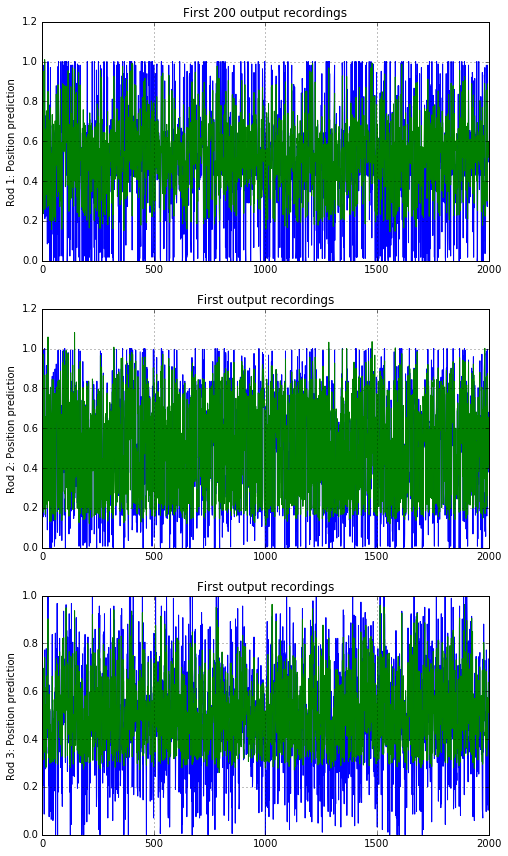

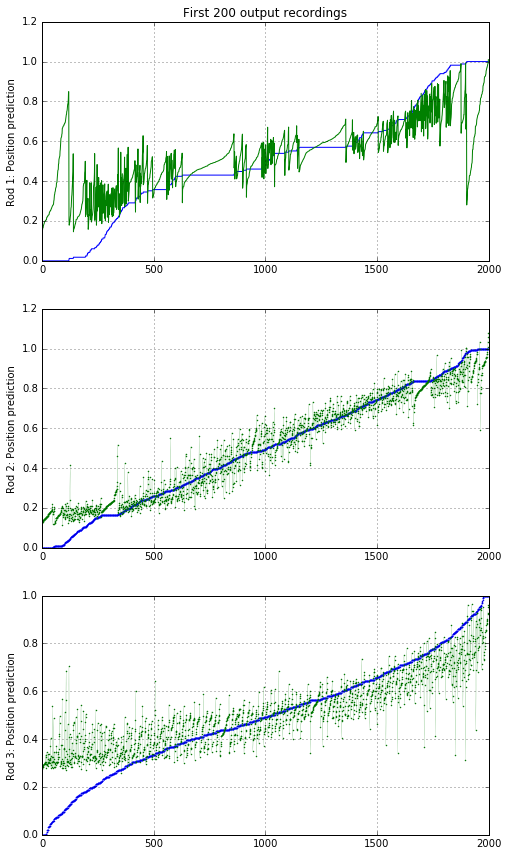

Epoch 6/6
4013/4013 [==============================] - 721s - loss: 0.0308 - mse: 3.0769e-05 - val_loss: 0.0214 - val_mse: 2.1442e-05
Wrote model to pos_cnn_weights_5.hdf
Predicted.
array([[ 0.58787876,  0.65367967,  0.91082805],
       [ 0.63636363,  0.33766234,  0.18471338],
       [ 0.21212122,  0.06493507,  0.74522293],
       ..., 
       [ 0.16969697,  0.94372296,  0.46496814],
       [ 0.66666669,  0.63636363,  0.80573249],
       [ 0.01212121,  0.5714286 ,  0.52229297]], dtype=float32)
array([[ 0.55163336,  0.63736737,  0.70630544],
       [ 0.51446545,  0.2722578 ,  0.38906014],
       [ 0.2352227 ,  0.16361049,  0.50537324],
       ..., 
       [ 0.32042527,  0.84670538,  0.447914  ],
       [ 0.61098659,  0.60990286,  0.5176791 ],
       [ 0.27793083,  0.46599463,  0.33777481]], dtype=float32)


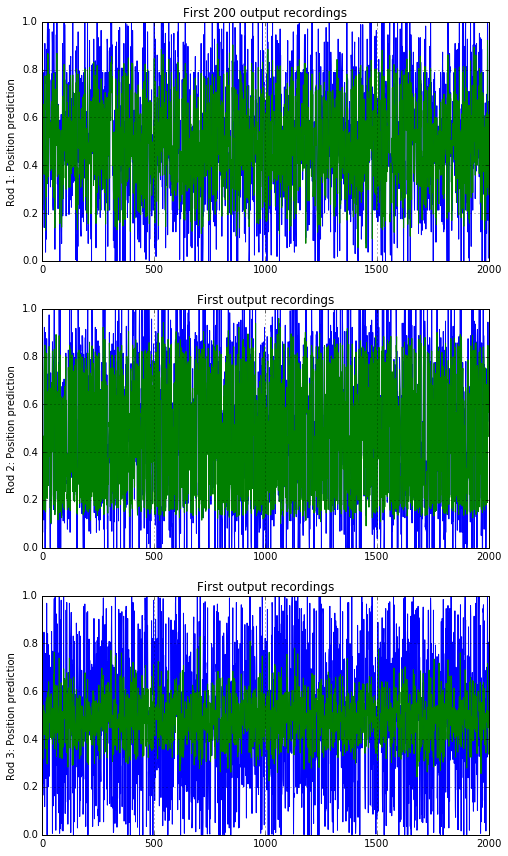

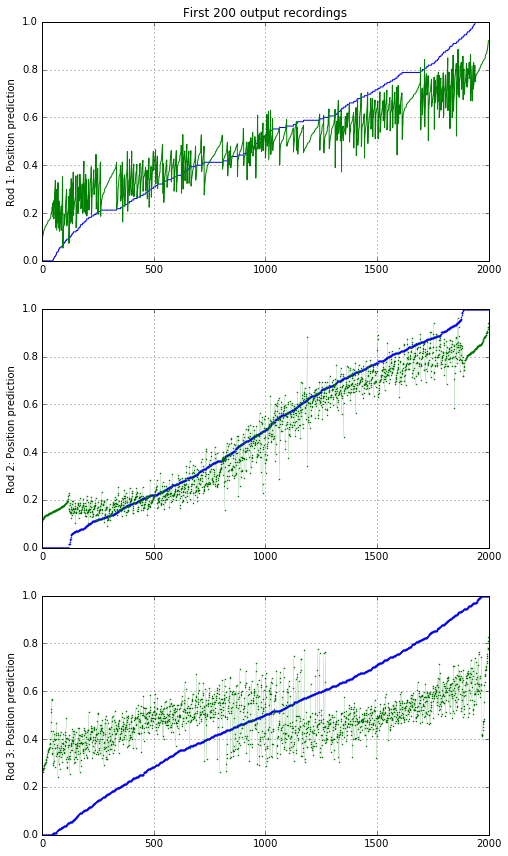

Epoch 7/7
4013/4013 [==============================] - 720s - loss: 0.0291 - mse: 2.9120e-05 - val_loss: 0.0181 - val_mse: 1.8111e-05
Wrote model to pos_cnn_weights_6.hdf
Predicted.
array([[ 0.41212121,  0.34632036,  0.08917198],
       [ 0.36363637,  0.66233766,  0.81528664],
       [ 0.21212122,  0.06493507,  0.74522293],
       ..., 
       [ 0.16969697,  0.94372296,  0.46496814],
       [ 0.66666669,  0.63636363,  0.80573249],
       [ 0.9878788 ,  0.42857143,  0.477707  ]], dtype=float32)
array([[ 0.3863107 ,  0.33536071,  0.16705965],
       [ 0.39453769,  0.69791394,  0.61992264],
       [ 0.21385726,  0.17044017,  0.51451731],
       ..., 
       [ 0.24479611,  0.91413867,  0.50246572],
       [ 0.6590088 ,  0.66685104,  0.51360887],
       [ 1.04454398,  0.66351241,  0.70706666]], dtype=float32)


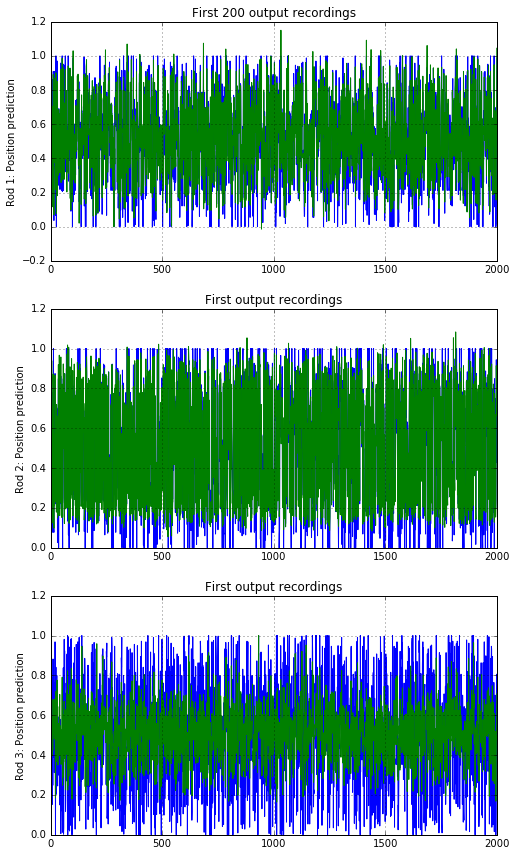

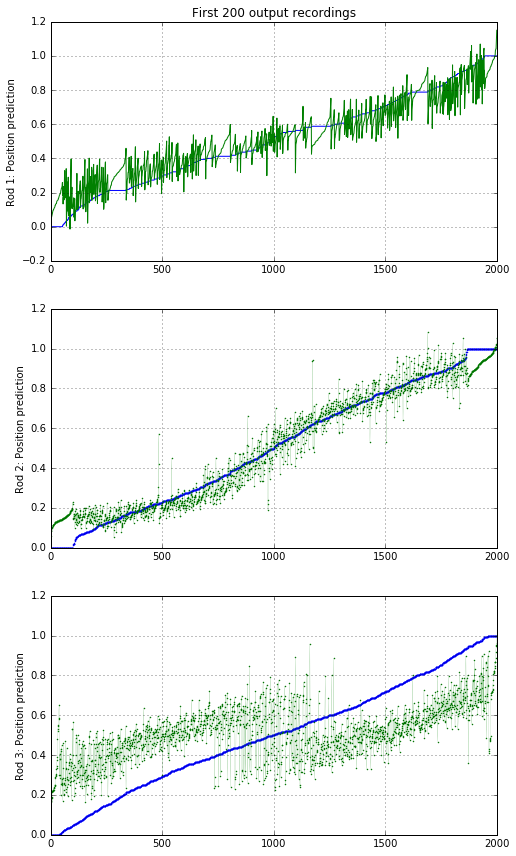

Epoch 8/8
4013/4013 [==============================] - 720s - loss: 0.0284 - mse: 2.8363e-05 - val_loss: 0.0175 - val_mse: 1.7515e-05
Wrote model to pos_cnn_weights_7.hdf
Predicted.
array([[ 0.56969696,  0.63934427,  0.67567569],
       [ 0.43030304,  0.55327868,  0.60000002],
       [ 0.9818182 ,  0.5942623 ,  0.56216216],
       ..., 
       [ 0.56969696,  0.49180329,  0.51891893],
       [ 0.44242424,  0.31967214,  0.89729732],
       [ 0.4969697 ,  0.38114753,  0.73513514]], dtype=float32)
array([[ 0.55089802,  0.61719191,  0.67508566],
       [ 0.47825569,  0.56430912,  0.63059151],
       [ 0.68591392,  0.58061683,  0.5598523 ],
       ..., 
       [ 0.55718434,  0.46371007,  0.59279621],
       [ 0.39170796,  0.34145921,  0.53172046],
       [ 0.49989021,  0.37682015,  0.70255411]], dtype=float32)


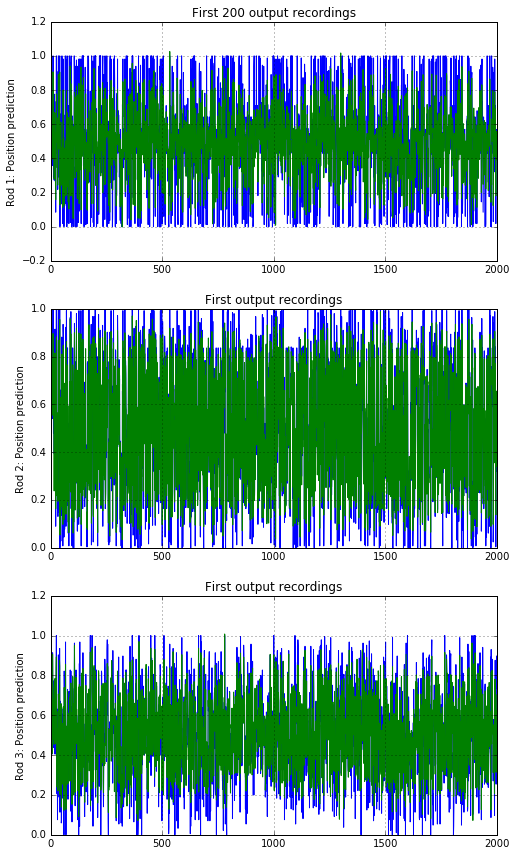

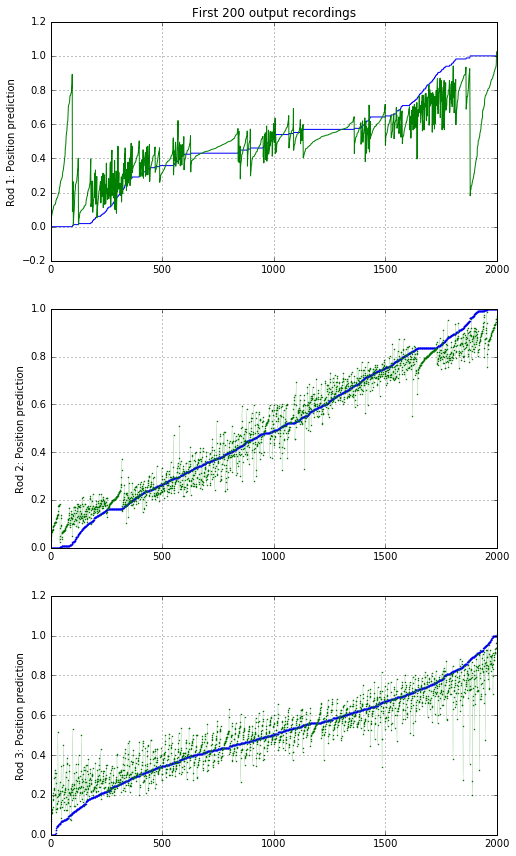

Epoch 9/9
4013/4013 [==============================] - 721s - loss: 0.0274 - mse: 2.7371e-05 - val_loss: 0.0165 - val_mse: 1.6503e-05
Wrote model to pos_cnn_weights_8.hdf
Predicted.
array([[ 0.40606061,  0.78074867,  0.19243987],
       [ 0.43030304,  0.13368984,  0.09965636],
       [ 0.43030304,  0.5026738 ,  0.57731956],
       ..., 
       [ 0.43030304,  0.78074867,  1.        ],
       [ 0.41818181,  0.83957219,  0.71477664],
       [ 0.56969696,  0.03743315,  0.69072163]], dtype=float32)
array([[ 0.44873589,  0.62318516,  0.28714257],
       [ 0.4516665 ,  0.2050949 ,  0.27015156],
       [ 0.44839799,  0.57387483,  0.20180282],
       ..., 
       [ 0.41136539,  0.72633564,  0.66465354],
       [ 0.44718239,  0.82525009,  0.4179509 ],
       [ 0.52813959,  0.1682146 ,  0.50969988]], dtype=float32)


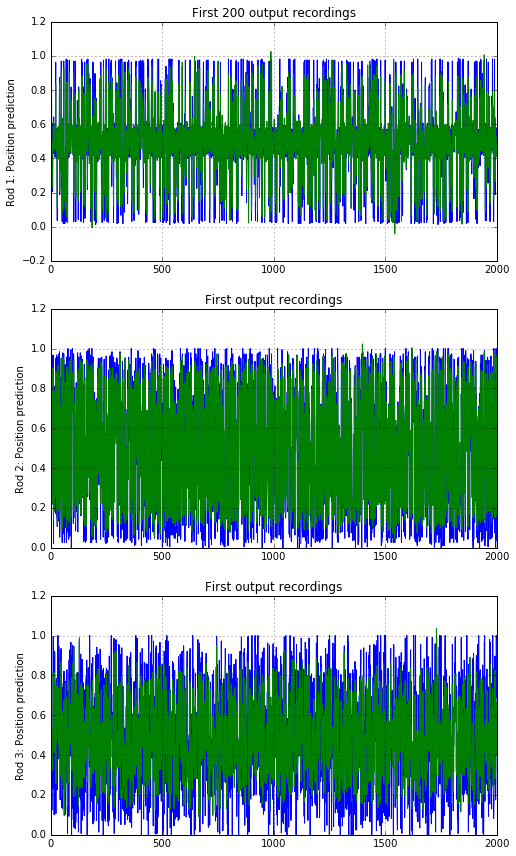

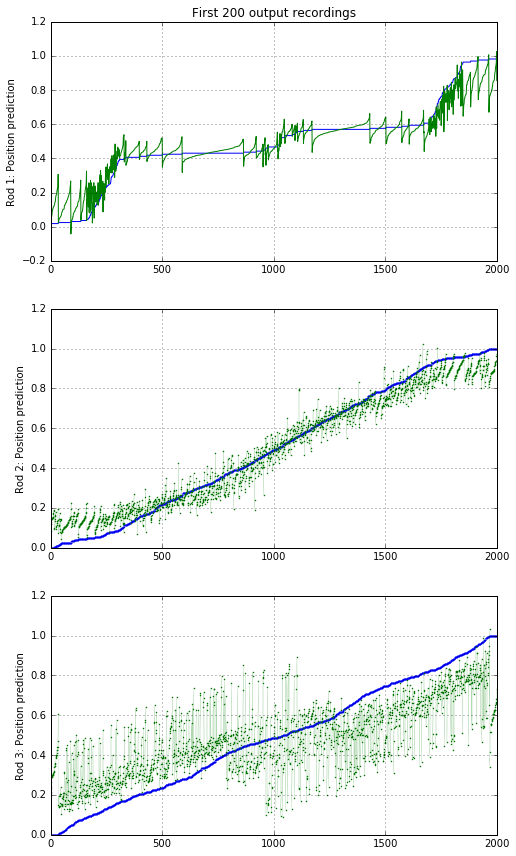

Epoch 10/10
4013/4013 [==============================] - 721s - loss: 0.0265 - mse: 2.6519e-05 - val_loss: 0.0176 - val_mse: 1.7584e-05
Wrote model to pos_cnn_weights_9.hdf
Predicted.
array([[ 0.59393942,  0.21925133,  0.80756015],
       [ 0.56969696,  0.86631018,  0.90034366],
       [ 0.43030304,  0.5026738 ,  0.57731956],
       ..., 
       [ 0.56969696,  0.21925133,  0.        ],
       [ 0.41818181,  0.83957219,  0.71477664],
       [ 0.43030304,  0.96256685,  0.30927834]], dtype=float32)
array([[ 0.54760116,  0.25229502,  0.66262352],
       [ 0.59514743,  0.76610792,  0.73511088],
       [ 0.34857601,  0.49902183,  0.2655724 ],
       ..., 
       [ 0.49904281,  0.24505685,  0.36243927],
       [ 0.42008656,  0.82358801,  0.38071856],
       [ 0.39611056,  0.85062331,  0.38618645]], dtype=float32)


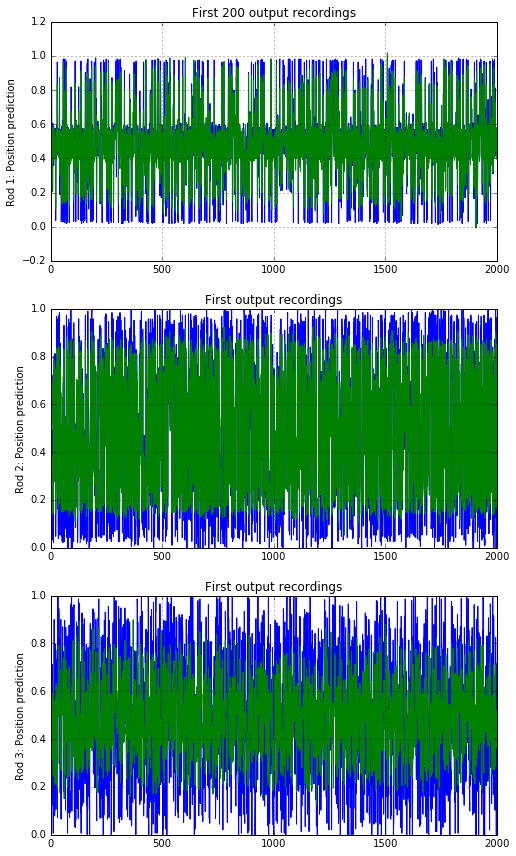

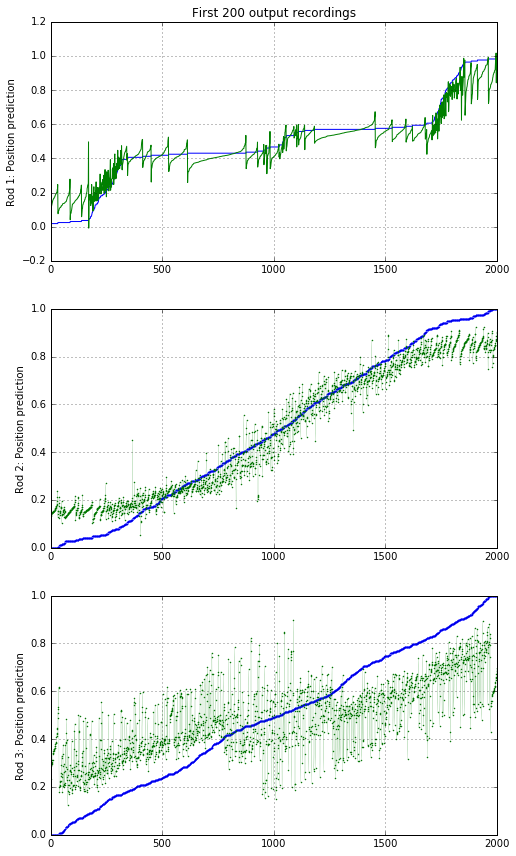

Epoch 11/11
4013/4013 [==============================] - 720s - loss: 0.0262 - mse: 2.6159e-05 - val_loss: 0.0196 - val_mse: 1.9579e-05
Wrote model to pos_cnn_weights_10.hdf
Predicted.
array([[ 0.43030304,  0.36065573,  0.32432431],
       [ 0.56969696,  0.44672132,  0.40000001],
       [ 0.9818182 ,  0.5942623 ,  0.56216216],
       ..., 
       [ 0.56969696,  0.49180329,  0.51891893],
       [ 0.55757576,  0.68032789,  0.1027027 ],
       [ 0.4969697 ,  0.38114753,  0.73513514]], dtype=float32)
array([[ 0.47777361,  0.29195356,  0.33577147],
       [ 0.57817894,  0.47974294,  0.45909405],
       [ 0.73707002,  0.60676175,  0.55556953],
       ..., 
       [ 0.55381411,  0.49813944,  0.50306314],
       [ 0.55682063,  0.61565804,  0.34775287],
       [ 0.45611221,  0.33851147,  0.60598582]], dtype=float32)


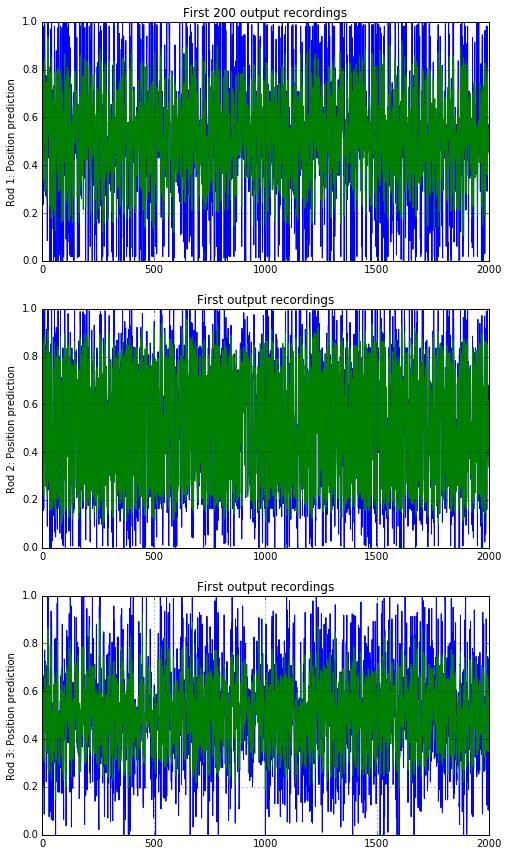

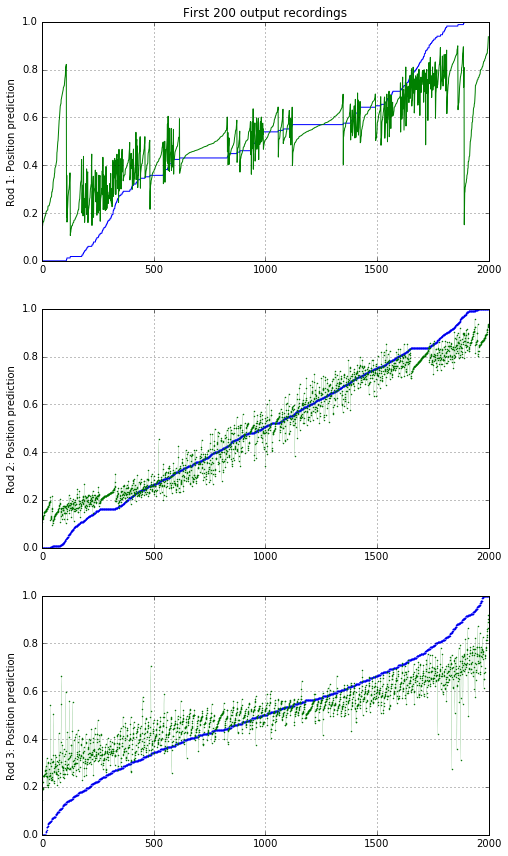

Epoch 12/12
4013/4013 [==============================] - 720s - loss: 0.0258 - mse: 2.5773e-05 - val_loss: 0.0165 - val_mse: 1.6523e-05
Wrote model to pos_cnn_weights_11.hdf
Predicted.
array([[ 0.43030304,  0.36065573,  0.32432431],
       [ 0.43030304,  0.55327868,  0.60000002],
       [ 0.9818182 ,  0.5942623 ,  0.56216216],
       ..., 
       [ 0.43030304,  0.50819671,  0.48108107],
       [ 0.44242424,  0.31967214,  0.89729732],
       [ 0.4969697 ,  0.38114753,  0.73513514]], dtype=float32)
array([[ 0.3872878 ,  0.30404413,  0.31889307],
       [ 0.47728708,  0.5892033 ,  0.52755159],
       [ 0.71845764,  0.5794    ,  0.53943729],
       ..., 
       [ 0.44025075,  0.55929613,  0.55575812],
       [ 0.45777839,  0.33871755,  0.69973052],
       [ 0.4958967 ,  0.4611561 ,  0.69075406]], dtype=float32)


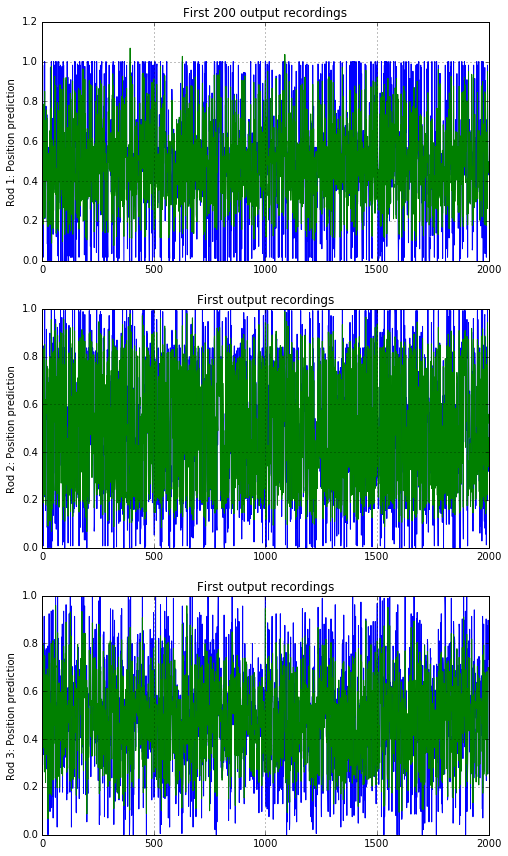

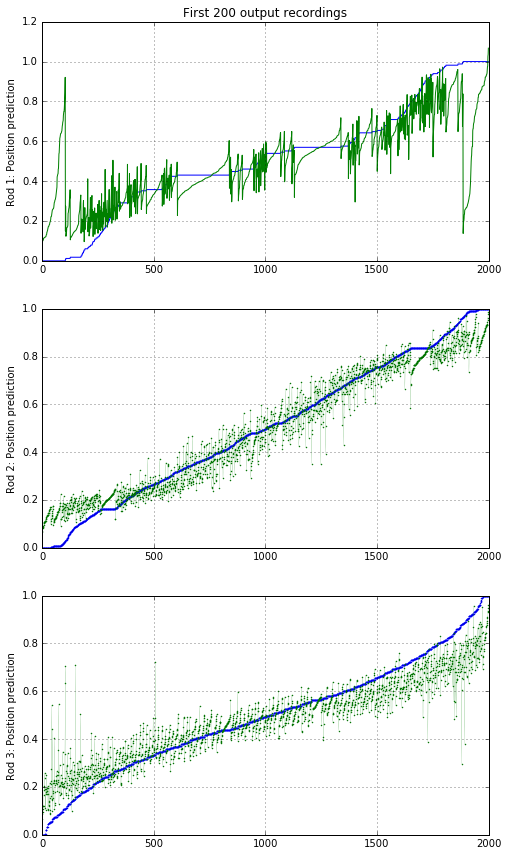

Epoch 13/13
4013/4013 [==============================] - 720s - loss: 0.0253 - mse: 2.5268e-05 - val_loss: 0.0168 - val_mse: 1.6812e-05
Wrote model to pos_cnn_weights_12.hdf
Predicted.
array([[ 0.40606061,  0.78074867,  0.19243987],
       [ 0.56969696,  0.86631018,  0.90034366],
       [ 0.56969696,  0.4973262 ,  0.42268041],
       ..., 
       [ 0.56969696,  0.21925133,  0.        ],
       [ 0.58181816,  0.16042781,  0.28522336],
       [ 0.56969696,  0.03743315,  0.69072163]], dtype=float32)
array([[ 0.44756675,  0.72906047,  0.1992799 ],
       [ 0.5578227 ,  0.77116358,  0.67765713],
       [ 0.53206176,  0.42914376,  0.74354815],
       ..., 
       [ 0.56144726,  0.22815329,  0.3832399 ],
       [ 0.53873456,  0.19662814,  0.5007875 ],
       [ 0.56702638,  0.1702227 ,  0.5111686 ]], dtype=float32)


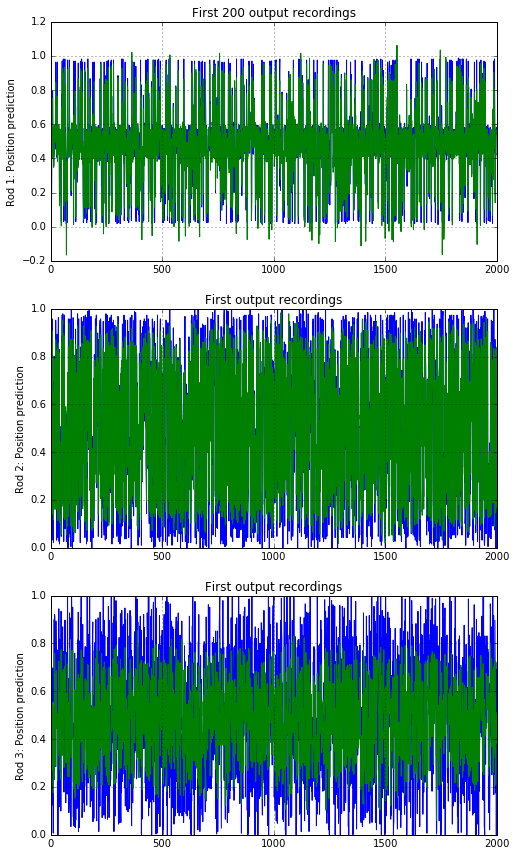

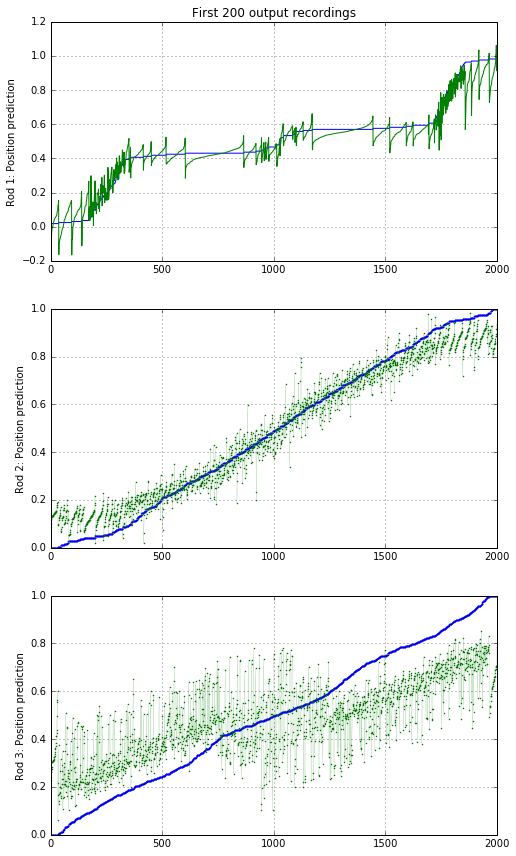

Epoch 14/14
4013/4013 [==============================] - 720s - loss: 0.0253 - mse: 2.5286e-05 - val_loss: 0.0164 - val_mse: 1.6411e-05
Wrote model to pos_cnn_weights_13.hdf
Predicted.
array([[ 0.56969696,  0.63934427,  0.67567569],
       [ 0.43030304,  0.55327868,  0.60000002],
       [ 0.01818182,  0.4057377 ,  0.43783784],
       ..., 
       [ 0.43030304,  0.50819671,  0.48108107],
       [ 0.55757576,  0.68032789,  0.1027027 ],
       [ 0.5030303 ,  0.61885244,  0.26486486]], dtype=float32)
array([[ 0.55155939,  0.62015778,  0.63621521],
       [ 0.45518187,  0.58136576,  0.63048351],
       [ 0.20941371,  0.42456552,  0.44799402],
       ..., 
       [ 0.41913629,  0.5000447 ,  0.43812829],
       [ 0.51022339,  0.65361023,  0.28259391],
       [ 0.55733621,  0.64135087,  0.29703566]], dtype=float32)


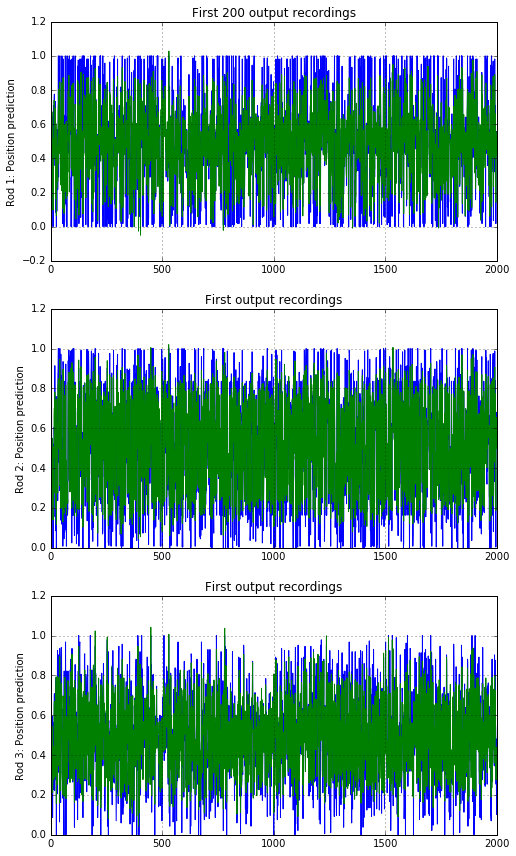

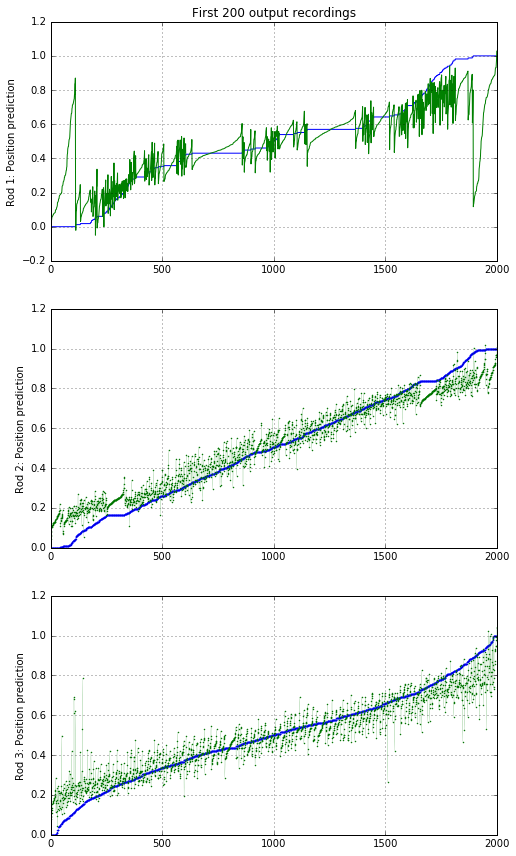

Epoch 15/15
4013/4013 [==============================] - 720s - loss: 0.0247 - mse: 2.4700e-05 - val_loss: 0.0159 - val_mse: 1.5860e-05
Wrote model to pos_cnn_weights_14.hdf
Predicted.
array([[ 0.43030304,  0.36065573,  0.32432431],
       [ 0.43030304,  0.55327868,  0.60000002],
       [ 0.9818182 ,  0.5942623 ,  0.56216216],
       ..., 
       [ 0.56969696,  0.49180329,  0.51891893],
       [ 0.55757576,  0.68032789,  0.1027027 ],
       [ 0.5030303 ,  0.61885244,  0.26486486]], dtype=float32)
array([[ 0.40988111,  0.30124411,  0.30362299],
       [ 0.41519815,  0.58057046,  0.67225552],
       [ 0.69859731,  0.60784137,  0.53589362],
       ..., 
       [ 0.63844061,  0.50793809,  0.44787908],
       [ 0.56150573,  0.68052357,  0.2343604 ],
       [ 0.56064057,  0.64529443,  0.2710517 ]], dtype=float32)


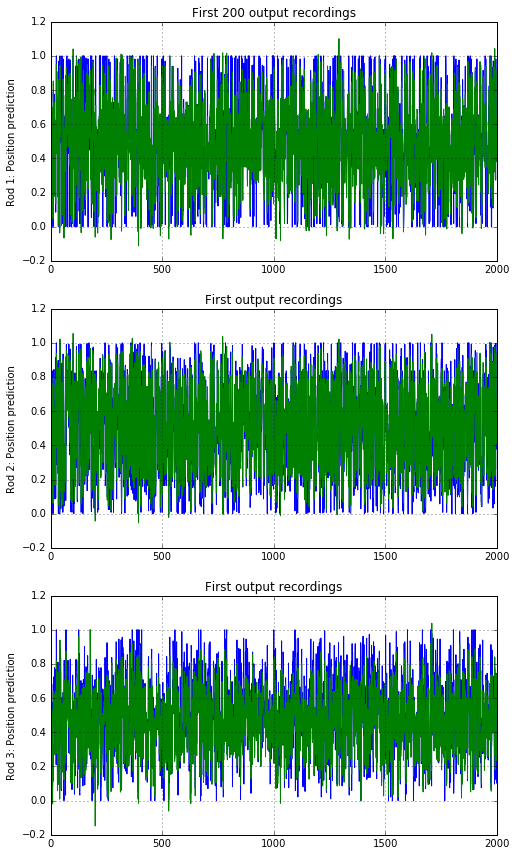

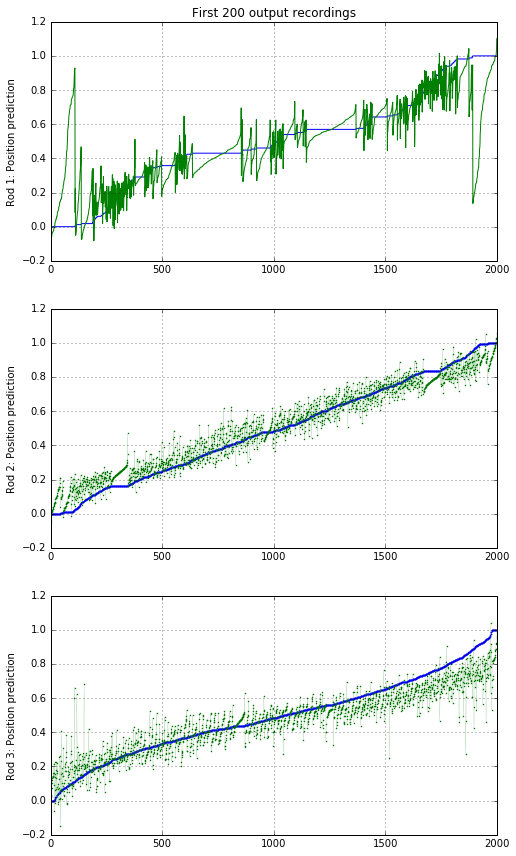

Epoch 16/16
4013/4013 [==============================] - 720s - loss: 0.0247 - mse: 2.4650e-05 - val_loss: 0.0145 - val_mse: 1.4544e-05
Wrote model to pos_cnn_weights_15.hdf
Predicted.
array([[ 0.40606061,  0.78074867,  0.19243987],
       [ 0.43030304,  0.13368984,  0.09965636],
       [ 0.43030304,  0.5026738 ,  0.57731956],
       ..., 
       [ 0.43030304,  0.78074867,  1.        ],
       [ 0.58181816,  0.16042781,  0.28522336],
       [ 0.43030304,  0.96256685,  0.30927834]], dtype=float32)
array([[ 0.43071014,  0.76141512,  0.24308649],
       [ 0.43285611,  0.21431376,  0.22183484],
       [ 0.40839007,  0.48984775,  0.1607464 ],
       ..., 
       [ 0.47135028,  0.76553434,  0.70443624],
       [ 0.57946074,  0.12142584,  0.5072006 ],
       [ 0.44844055,  0.97751057,  0.41446349]], dtype=float32)


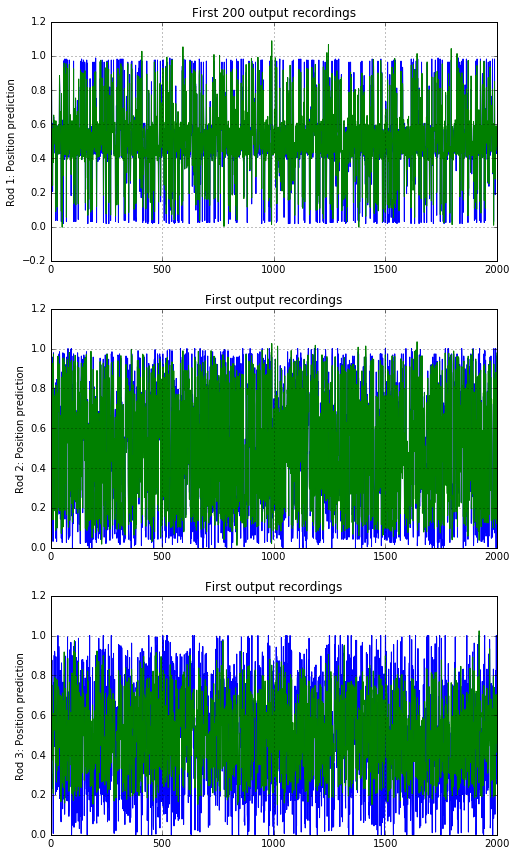

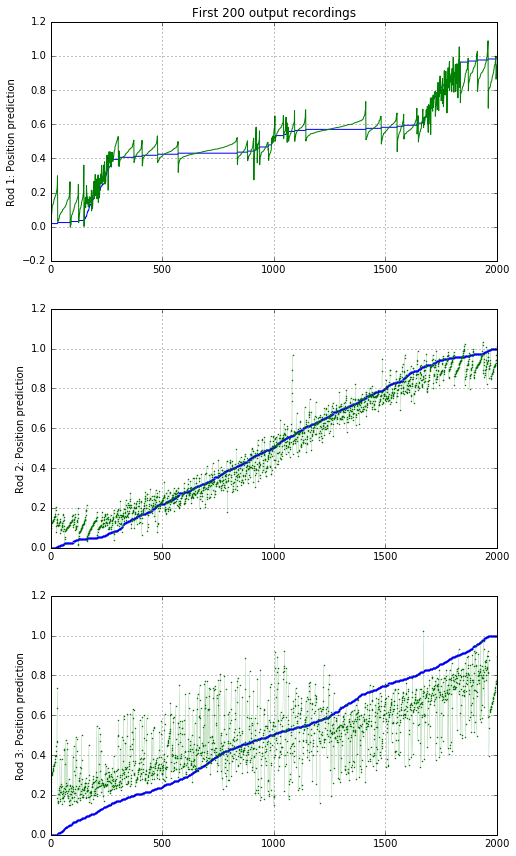

Epoch 17/17
4013/4013 [==============================] - 721s - loss: 0.0245 - mse: 2.4514e-05 - val_loss: 0.0146 - val_mse: 1.4605e-05
Wrote model to pos_cnn_weights_16.hdf
Predicted.
array([[ 0.40606061,  0.78074867,  0.19243987],
       [ 0.43030304,  0.13368984,  0.09965636],
       [ 0.56969696,  0.4973262 ,  0.42268041],
       ..., 
       [ 0.43030304,  0.78074867,  1.        ],
       [ 0.58181816,  0.16042781,  0.28522336],
       [ 0.43030304,  0.96256685,  0.30927834]], dtype=float32)
array([[ 0.42487797,  0.7791087 ,  0.25058085],
       [ 0.41471156,  0.19062325,  0.1535244 ],
       [ 0.58256894,  0.51840204,  0.77505744],
       ..., 
       [ 0.43422139,  0.78458202,  0.55574089],
       [ 0.59068179,  0.1542275 ,  0.5870446 ],
       [ 0.42730075,  0.9766736 ,  0.39627081]], dtype=float32)


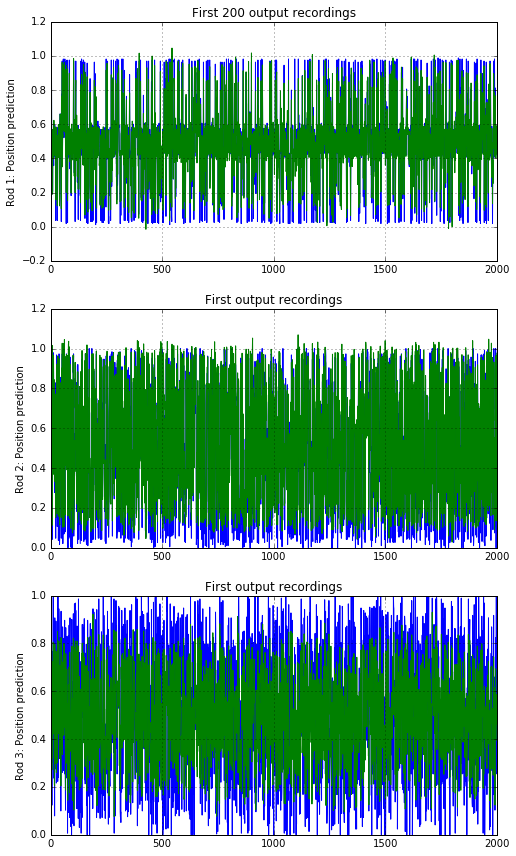

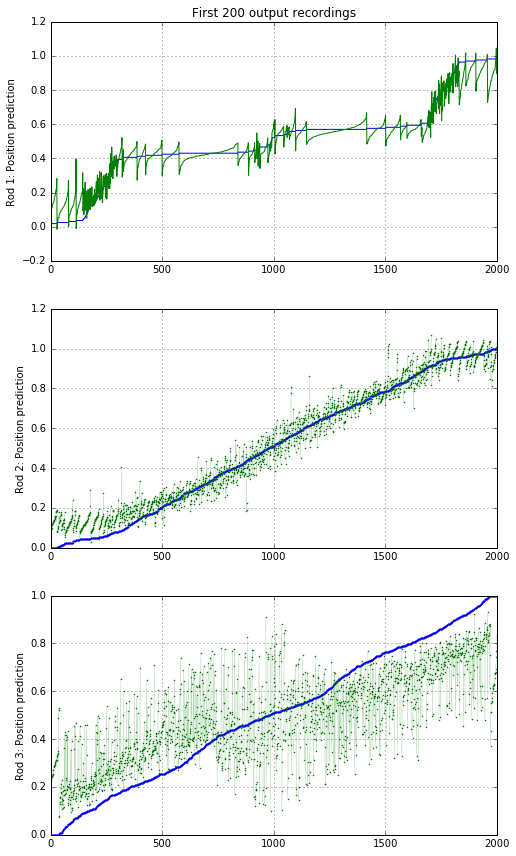

Epoch 18/18
4013/4013 [==============================] - 721s - loss: 0.0242 - mse: 2.4222e-05 - val_loss: 0.0179 - val_mse: 1.7931e-05
Wrote model to pos_cnn_weights_17.hdf
Predicted.
array([[ 0.41212121,  0.34632036,  0.08917198],
       [ 0.63636363,  0.33766234,  0.18471338],
       [ 0.21212122,  0.06493507,  0.74522293],
       ..., 
       [ 0.83030301,  0.05627706,  0.53503186],
       [ 0.33333334,  0.36363637,  0.19426751],
       [ 0.9878788 ,  0.42857143,  0.477707  ]], dtype=float32)
array([[ 0.40938175,  0.33754554,  0.24072862],
       [ 0.53851813,  0.31494033,  0.2677882 ],
       [ 0.24695328,  0.20142312,  0.50682956],
       ..., 
       [ 0.71713746,  0.1351144 ,  0.50880623],
       [ 0.30524433,  0.33956432,  0.44701511],
       [ 0.78773546,  0.40926677,  0.57549012]], dtype=float32)


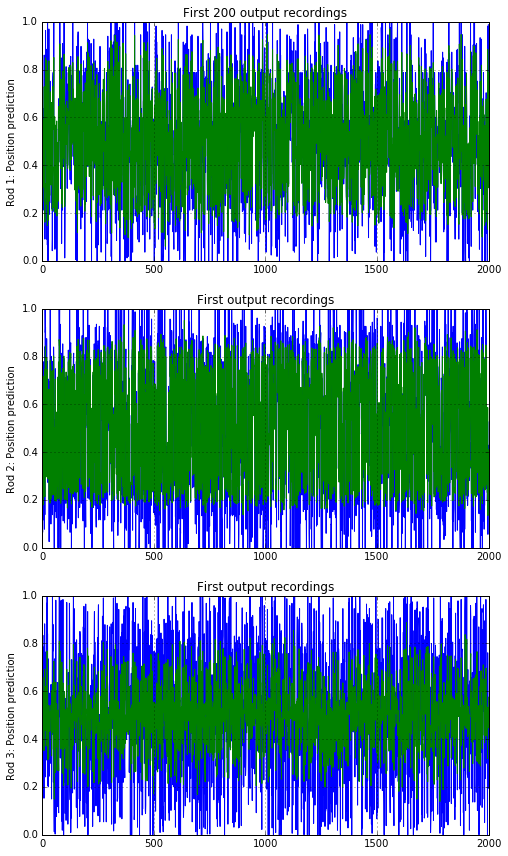

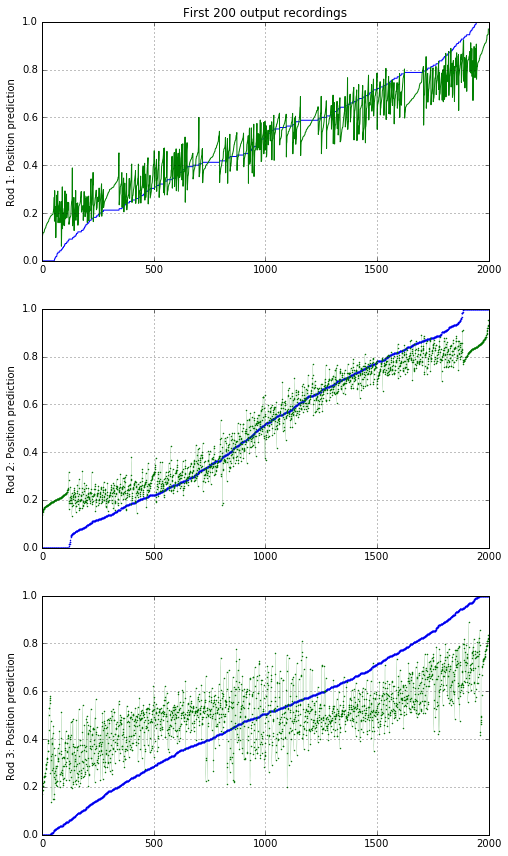

Epoch 19/19
4013/4013 [==============================] - 720s - loss: 0.0240 - mse: 2.3964e-05 - val_loss: 0.0157 - val_mse: 1.5691e-05
Wrote model to pos_cnn_weights_18.hdf
Predicted.
array([[ 0.41212121,  0.34632036,  0.08917198],
       [ 0.36363637,  0.66233766,  0.81528664],
       [ 0.21212122,  0.06493507,  0.74522293],
       ..., 
       [ 0.83030301,  0.05627706,  0.53503186],
       [ 0.66666669,  0.63636363,  0.80573249],
       [ 0.01212121,  0.5714286 ,  0.52229297]], dtype=float32)
array([[ 0.31614071,  0.31298649,  0.27681208],
       [ 0.41015077,  0.67997158,  0.73135132],
       [ 0.16796747,  0.17095178,  0.49648556],
       ..., 
       [ 0.68068528,  0.24158654,  0.43444151],
       [ 0.68377125,  0.54853344,  0.51982188],
       [ 0.11170718,  0.44576776,  0.37465525]], dtype=float32)


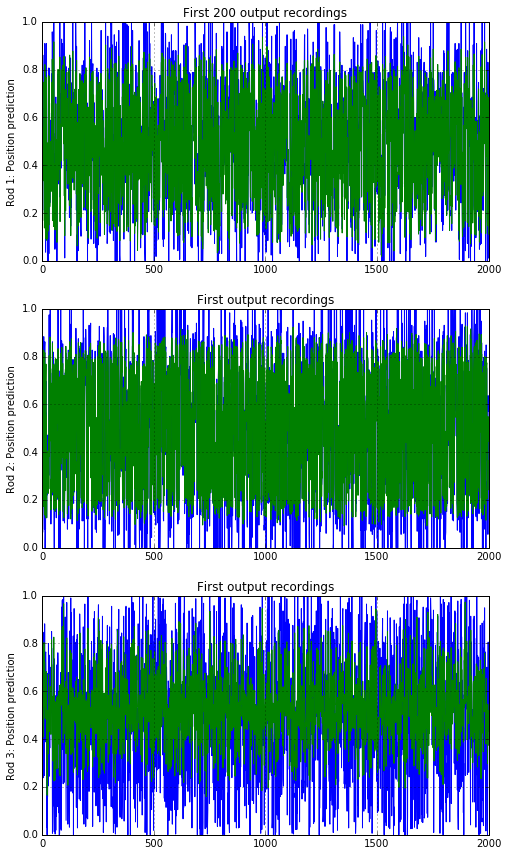

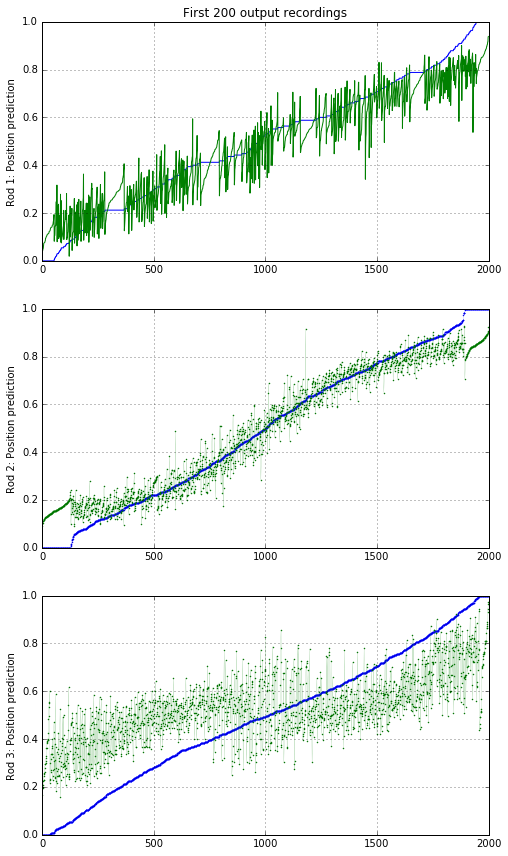

Epoch 20/20
4013/4013 [==============================] - 720s - loss: 0.0239 - mse: 2.3899e-05 - val_loss: 0.0149 - val_mse: 1.4927e-05
Wrote model to pos_cnn_weights_19.hdf
Predicted.
array([[ 0.43030304,  0.36065573,  0.32432431],
       [ 0.56969696,  0.44672132,  0.40000001],
       [ 0.01818182,  0.4057377 ,  0.43783784],
       ..., 
       [ 0.56969696,  0.49180329,  0.51891893],
       [ 0.44242424,  0.31967214,  0.89729732],
       [ 0.4969697 ,  0.38114753,  0.73513514]], dtype=float32)
array([[ 0.32619566,  0.29350001,  0.36104634],
       [ 0.51735592,  0.32441941,  0.36644161],
       [ 0.25686777,  0.36699301,  0.4082689 ],
       ..., 
       [ 0.56436765,  0.33521849,  0.45591748],
       [ 0.40444231,  0.35686487,  0.7843169 ],
       [ 0.47643119,  0.34825614,  0.70413232]], dtype=float32)


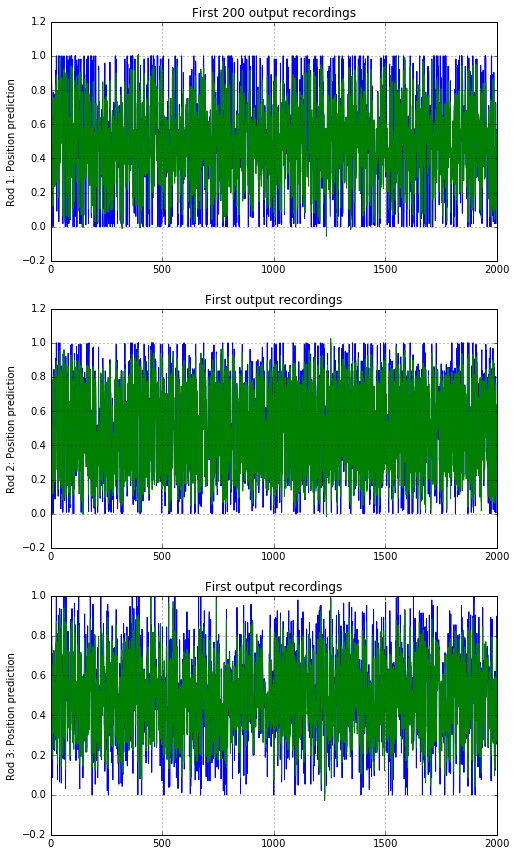

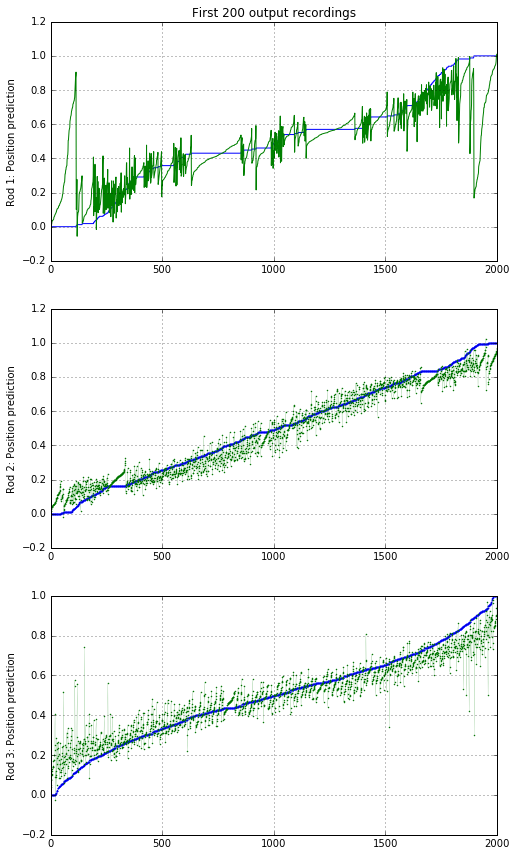

Epoch 21/21
4013/4013 [==============================] - 720s - loss: 0.0237 - mse: 2.3690e-05 - val_loss: 0.0154 - val_mse: 1.5416e-05
Wrote model to pos_cnn_weights_20.hdf
Predicted.
array([[ 0.43030304,  0.36065573,  0.32432431],
       [ 0.56969696,  0.44672132,  0.40000001],
       [ 0.01818182,  0.4057377 ,  0.43783784],
       ..., 
       [ 0.43030304,  0.50819671,  0.48108107],
       [ 0.55757576,  0.68032789,  0.1027027 ],
       [ 0.4969697 ,  0.38114753,  0.73513514]], dtype=float32)
array([[ 0.37292749,  0.32971895,  0.30156296],
       [ 0.53895313,  0.39159921,  0.36721268],
       [ 0.21845445,  0.32869342,  0.52572578],
       ..., 
       [ 0.40712592,  0.49625355,  0.49476215],
       [ 0.53108817,  0.55900264,  0.36066747],
       [ 0.43862224,  0.39431962,  0.71004766]], dtype=float32)


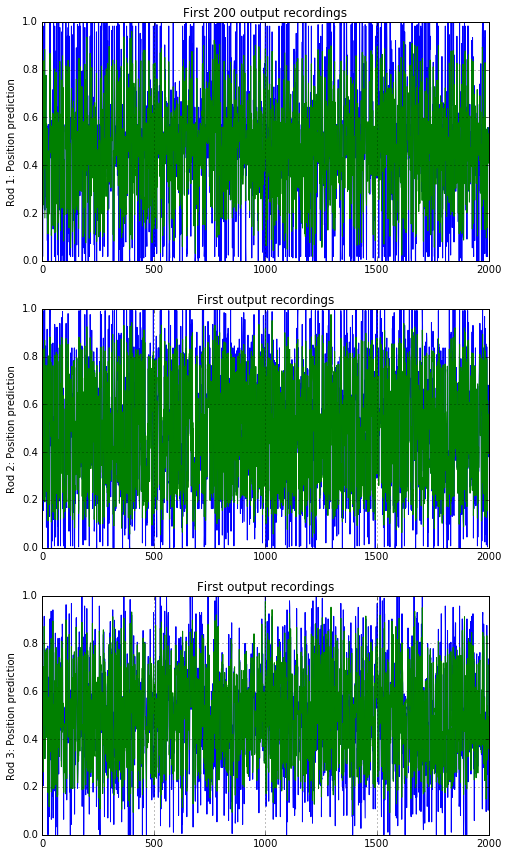

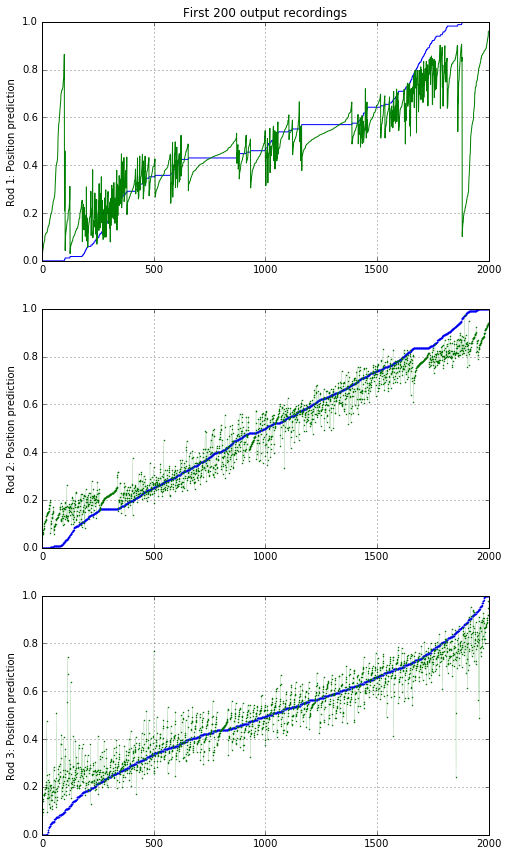

Epoch 22/22
4013/4013 [==============================] - 720s - loss: 0.0237 - mse: 2.3675e-05 - val_loss: 0.0780 - val_mse: 7.8002e-05
Wrote model to pos_cnn_weights_21.hdf
Predicted.
array([[ 0.59393942,  0.21925133,  0.80756015],
       [ 0.56969696,  0.86631018,  0.90034366],
       [ 0.43030304,  0.5026738 ,  0.57731956],
       ..., 
       [ 0.56969696,  0.21925133,  0.        ],
       [ 0.58181816,  0.16042781,  0.28522336],
       [ 0.43030304,  0.96256685,  0.30927834]], dtype=float32)
array([[ 0.57610524,  0.21512344,  0.59935755],
       [ 0.57354504,  0.78648609,  0.76175952],
       [ 0.45155197,  0.45822352,  0.21245348],
       ..., 
       [ 0.53727049,  0.24683663,  0.33968931],
       [ 0.5728144 ,  0.13268065,  0.47598612],
       [ 0.45765805,  0.8965624 ,  0.450308  ]], dtype=float32)


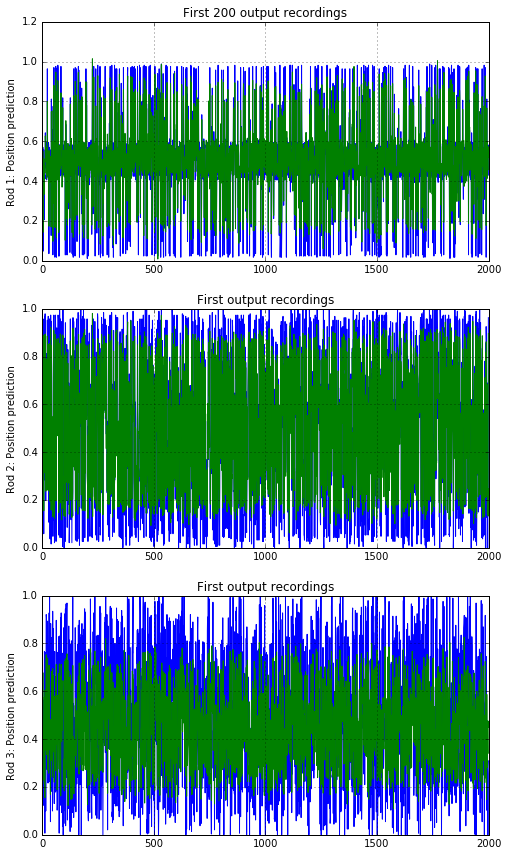

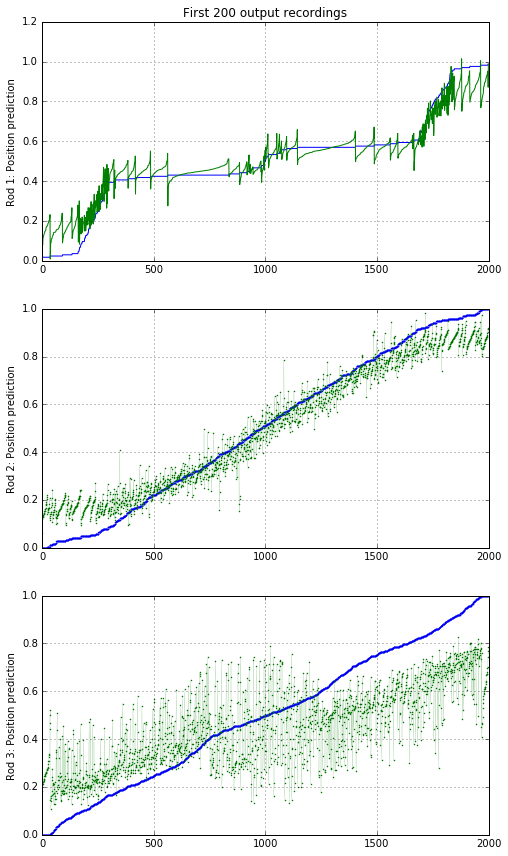

Epoch 23/23
4013/4013 [==============================] - 720s - loss: 0.0236 - mse: 2.3564e-05 - val_loss: 0.0172 - val_mse: 1.7192e-05
Wrote model to pos_cnn_weights_22.hdf
Predicted.
array([[ 0.58787876,  0.65367967,  0.91082805],
       [ 0.36363637,  0.66233766,  0.81528664],
       [ 0.21212122,  0.06493507,  0.74522293],
       ..., 
       [ 0.16969697,  0.94372296,  0.46496814],
       [ 0.66666669,  0.63636363,  0.80573249],
       [ 0.01212121,  0.5714286 ,  0.52229297]], dtype=float32)
array([[ 0.52797318,  0.6937722 ,  0.78880596],
       [ 0.46087781,  0.66593134,  0.7187649 ],
       [ 0.29731959,  0.20845777,  0.49272552],
       ..., 
       [ 0.25253201,  0.844818  ,  0.59588504],
       [ 0.56467307,  0.55384928,  0.49977809],
       [ 0.18326733,  0.5237003 ,  0.52780527]], dtype=float32)


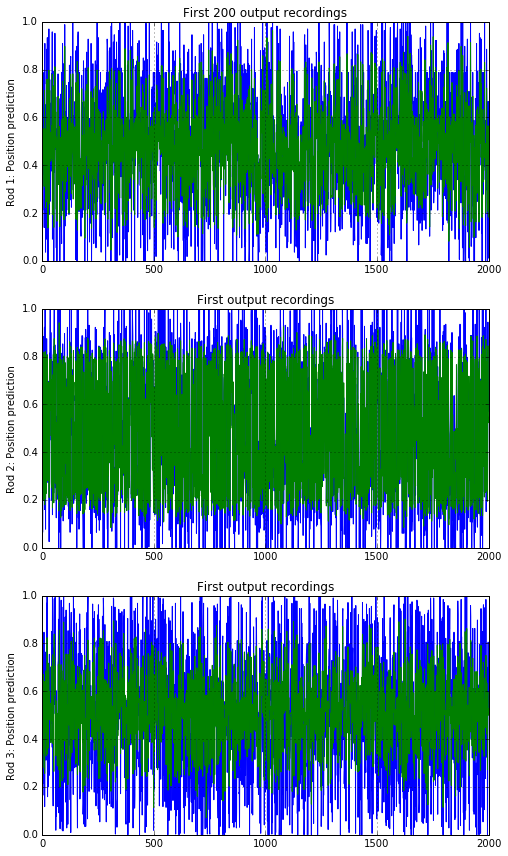

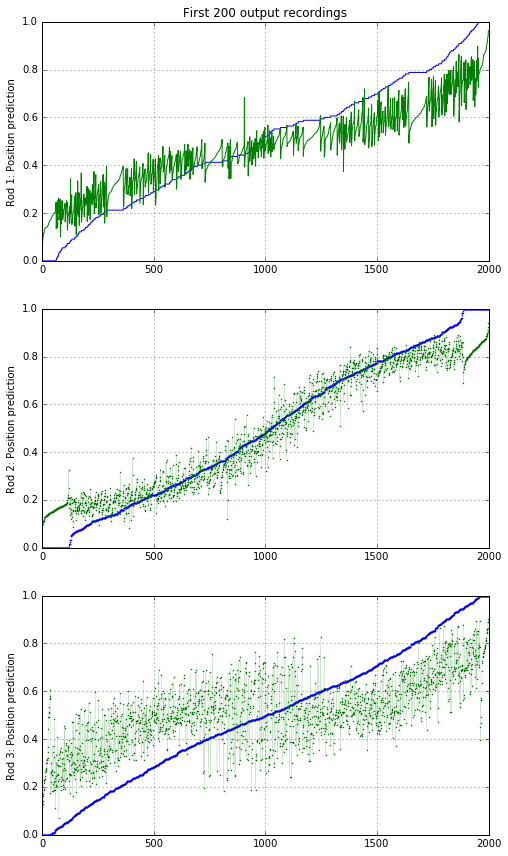

Epoch 24/24
4013/4013 [==============================] - 720s - loss: 0.0232 - mse: 2.3155e-05 - val_loss: 0.0141 - val_mse: 1.4087e-05
Wrote model to pos_cnn_weights_23.hdf
Predicted.
array([[ 0.56969696,  0.63934427,  0.67567569],
       [ 0.56969696,  0.44672132,  0.40000001],
       [ 0.9818182 ,  0.5942623 ,  0.56216216],
       ..., 
       [ 0.56969696,  0.49180329,  0.51891893],
       [ 0.55757576,  0.68032789,  0.1027027 ],
       [ 0.5030303 ,  0.61885244,  0.26486486]], dtype=float32)
array([[ 0.55324101,  0.67796111,  0.76806772],
       [ 0.60894561,  0.44796383,  0.5223344 ],
       [ 0.71812052,  0.67517924,  0.64820403],
       ..., 
       [ 0.47143662,  0.41908684,  0.6674962 ],
       [ 0.50728983,  0.70500994,  0.1455332 ],
       [ 0.49154252,  0.69191784,  0.24927884]], dtype=float32)


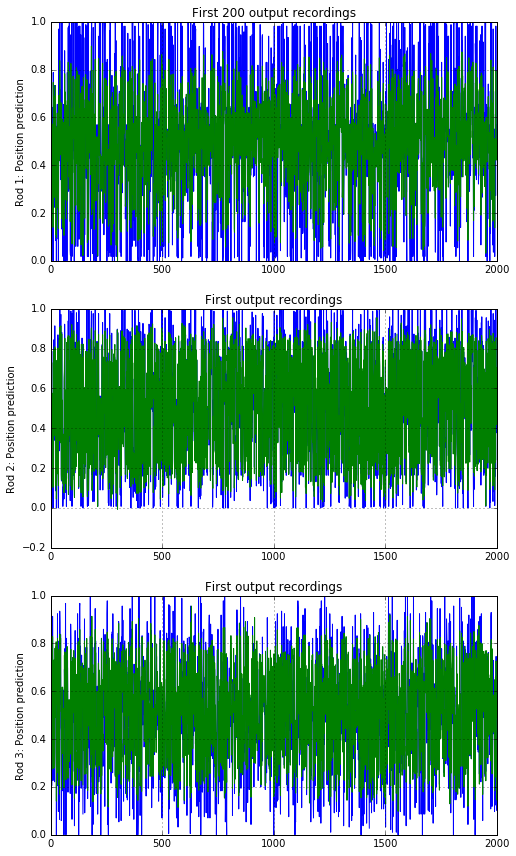

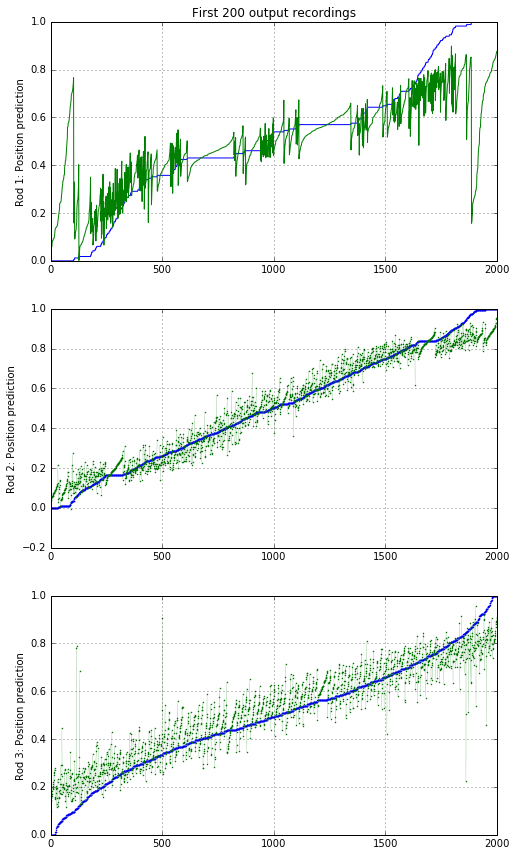

Epoch 25/25
4013/4013 [==============================] - 720s - loss: 0.0231 - mse: 2.3073e-05 - val_loss: 0.0143 - val_mse: 1.4326e-05
Wrote model to pos_cnn_weights_24.hdf
Predicted.
array([[ 0.41212121,  0.34632036,  0.08917198],
       [ 0.63636363,  0.33766234,  0.18471338],
       [ 0.21212122,  0.06493507,  0.74522293],
       ..., 
       [ 0.83030301,  0.05627706,  0.53503186],
       [ 0.66666669,  0.63636363,  0.80573249],
       [ 0.9878788 ,  0.42857143,  0.477707  ]], dtype=float32)
array([[ 0.34557056,  0.22958763,  0.14533073],
       [ 0.53345752,  0.28819281,  0.24591851],
       [ 0.27479511,  0.18716882,  0.52324724],
       ..., 
       [ 0.72343588,  0.13701233,  0.54705876],
       [ 0.59789246,  0.60105836,  0.50328344],
       [ 0.78817087,  0.58444953,  0.62704206]], dtype=float32)


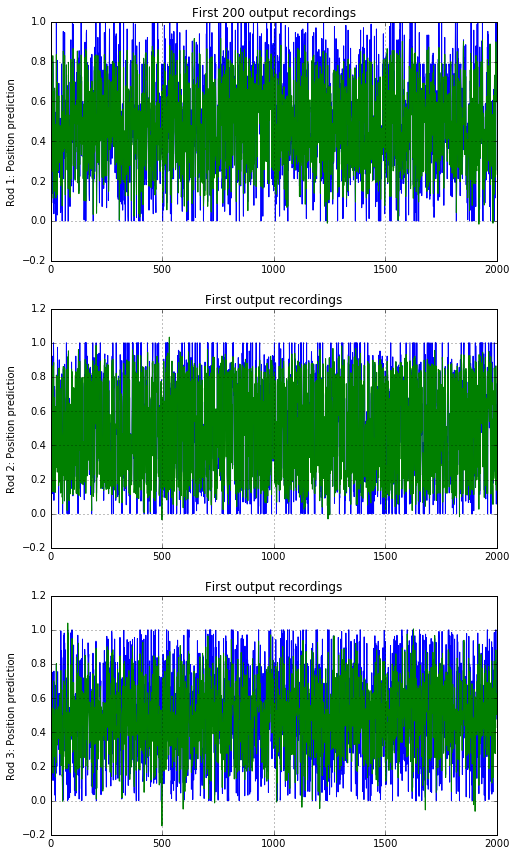

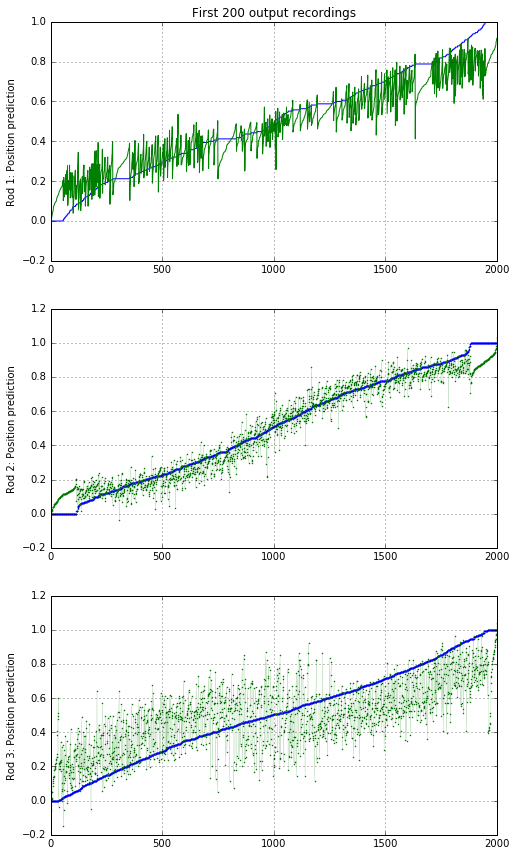

Epoch 26/26
4013/4013 [==============================] - 720s - loss: 0.0229 - mse: 2.2855e-05 - val_loss: 0.0148 - val_mse: 1.4846e-05
Wrote model to pos_cnn_weights_25.hdf
Predicted.
array([[ 0.43030304,  0.36065573,  0.32432431],
       [ 0.43030304,  0.55327868,  0.60000002],
       [ 0.9818182 ,  0.5942623 ,  0.56216216],
       ..., 
       [ 0.56969696,  0.49180329,  0.51891893],
       [ 0.55757576,  0.68032789,  0.1027027 ],
       [ 0.4969697 ,  0.38114753,  0.73513514]], dtype=float32)
array([[ 0.35030079,  0.32819289,  0.37300271],
       [ 0.35360494,  0.5458169 ,  0.55531013],
       [ 0.71079159,  0.66247553,  0.56070936],
       ..., 
       [ 0.61818528,  0.52470744,  0.4999575 ],
       [ 0.5364455 ,  0.5967536 ,  0.27709848],
       [ 0.47309279,  0.32291466,  0.65895671]], dtype=float32)


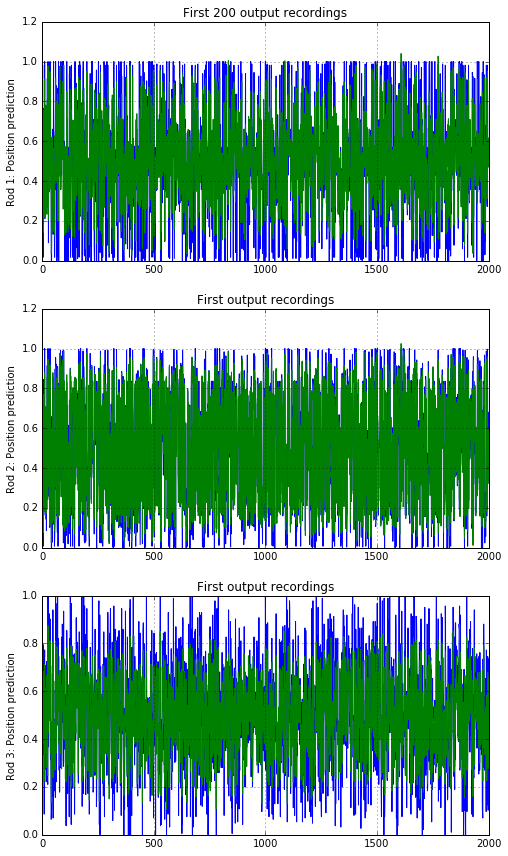

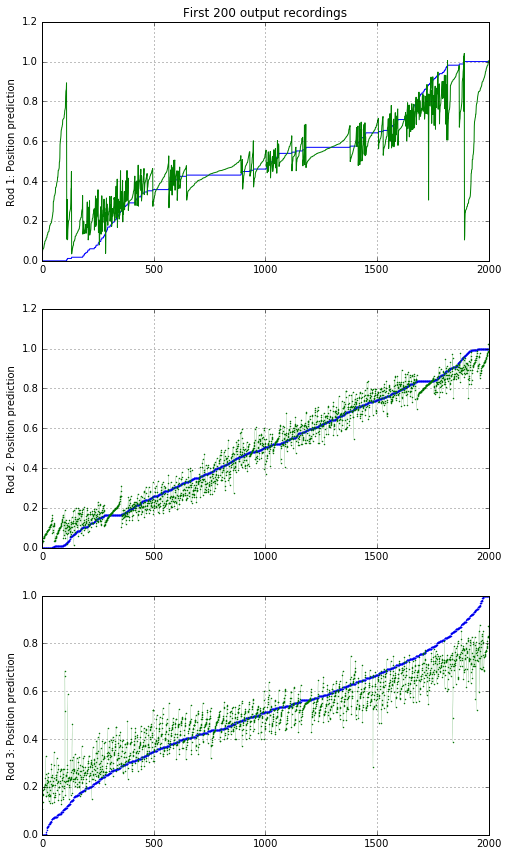

Epoch 27/27
4013/4013 [==============================] - 720s - loss: 0.0227 - mse: 2.2736e-05 - val_loss: 0.0151 - val_mse: 1.5062e-05
Wrote model to pos_cnn_weights_26.hdf
Predicted.
array([[ 0.43030304,  0.36065573,  0.32432431],
       [ 0.43030304,  0.55327868,  0.60000002],
       [ 0.9818182 ,  0.5942623 ,  0.56216216],
       ..., 
       [ 0.56969696,  0.49180329,  0.51891893],
       [ 0.55757576,  0.68032789,  0.1027027 ],
       [ 0.5030303 ,  0.61885244,  0.26486486]], dtype=float32)
array([[ 0.47551838,  0.2957207 ,  0.33775836],
       [ 0.40256584,  0.47229967,  0.56715268],
       [ 0.66141063,  0.58302528,  0.54008442],
       ..., 
       [ 0.58326149,  0.45211068,  0.48210731],
       [ 0.48265564,  0.60965967,  0.31791186],
       [ 0.59108061,  0.67751694,  0.27922761]], dtype=float32)


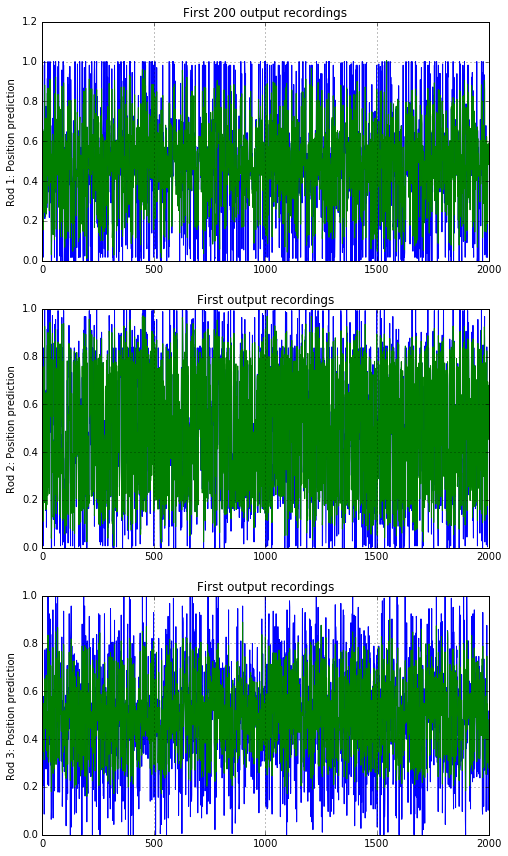

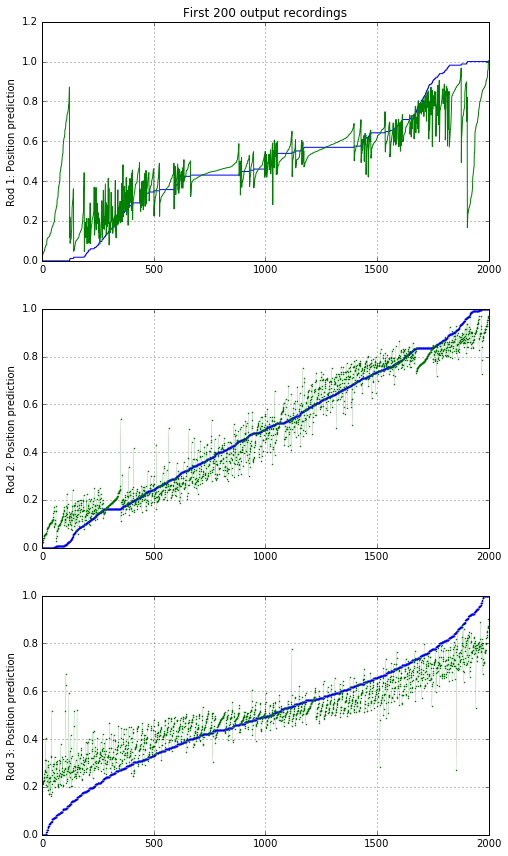

Epoch 28/28
4013/4013 [==============================] - 720s - loss: 0.0229 - mse: 2.2916e-05 - val_loss: 0.0156 - val_mse: 1.5649e-05
Wrote model to pos_cnn_weights_27.hdf
Predicted.
array([[ 0.41212121,  0.34632036,  0.08917198],
       [ 0.63636363,  0.33766234,  0.18471338],
       [ 0.78787881,  0.93506491,  0.25477707],
       ..., 
       [ 0.16969697,  0.94372296,  0.46496814],
       [ 0.66666669,  0.63636363,  0.80573249],
       [ 0.01212121,  0.5714286 ,  0.52229297]], dtype=float32)
array([[ 0.38772762,  0.3560755 ,  0.19507718],
       [ 0.55397666,  0.29340255,  0.33888865],
       [ 0.71012056,  0.80583155,  0.47892788],
       ..., 
       [ 0.2217945 ,  0.84821022,  0.44223365],
       [ 0.68159151,  0.60881114,  0.63019568],
       [ 0.14060479,  0.37998396,  0.5247041 ]], dtype=float32)


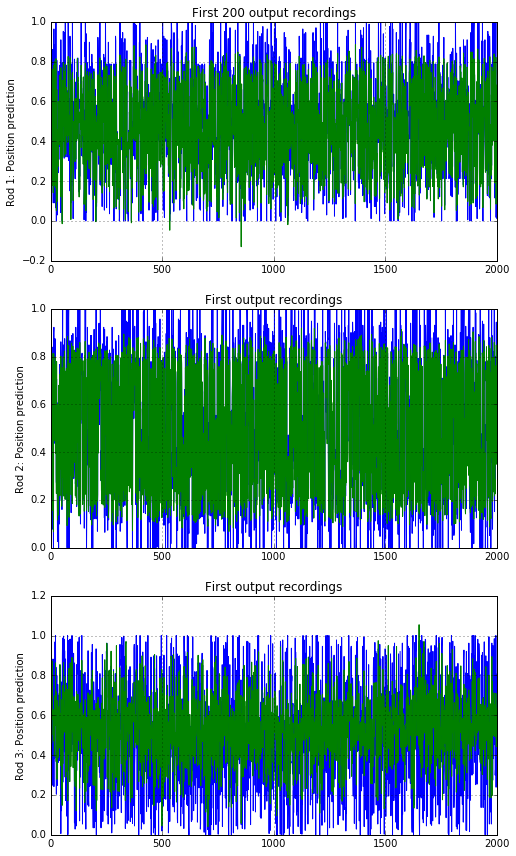

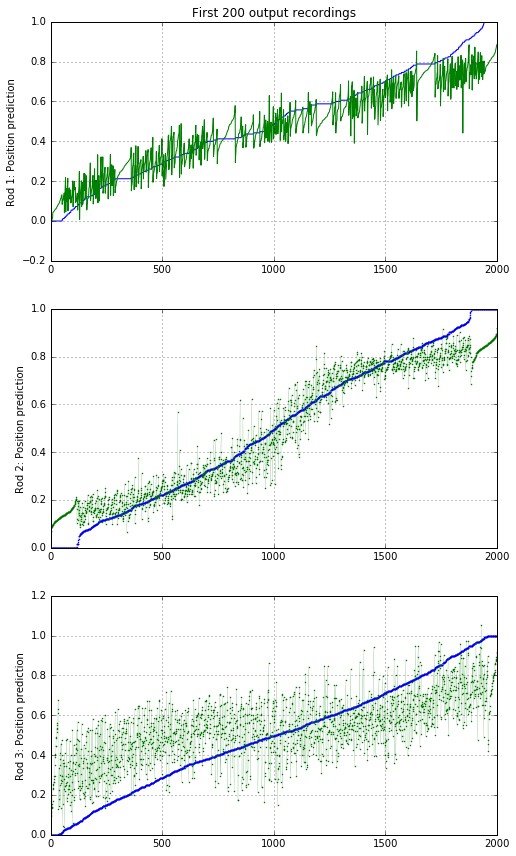

Epoch 29/29
4013/4013 [==============================] - 720s - loss: 0.0230 - mse: 2.2983e-05 - val_loss: 0.0143 - val_mse: 1.4258e-05
Wrote model to pos_cnn_weights_28.hdf
Predicted.
array([[ 0.43030304,  0.36065573,  0.32432431],
       [ 0.56969696,  0.44672132,  0.40000001],
       [ 0.9818182 ,  0.5942623 ,  0.56216216],
       ..., 
       [ 0.43030304,  0.50819671,  0.48108107],
       [ 0.55757576,  0.68032789,  0.1027027 ],
       [ 0.5030303 ,  0.61885244,  0.26486486]], dtype=float32)
array([[ 0.38289356,  0.34702617,  0.30653015],
       [ 0.48044127,  0.34566393,  0.29568899],
       [ 0.52593184,  0.51437926,  0.53875291],
       ..., 
       [ 0.37101066,  0.56652826,  0.56028318],
       [ 0.58484769,  0.6276232 ,  0.26157987],
       [ 0.48661616,  0.63478231,  0.26328903]], dtype=float32)


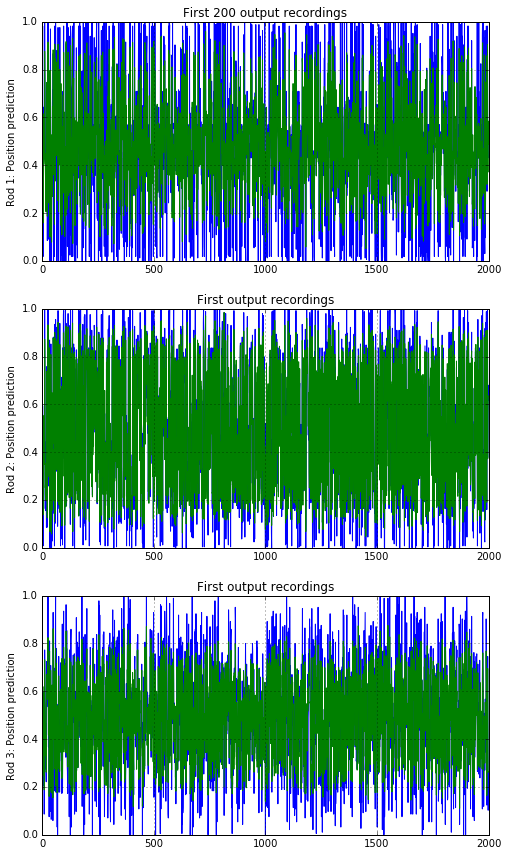

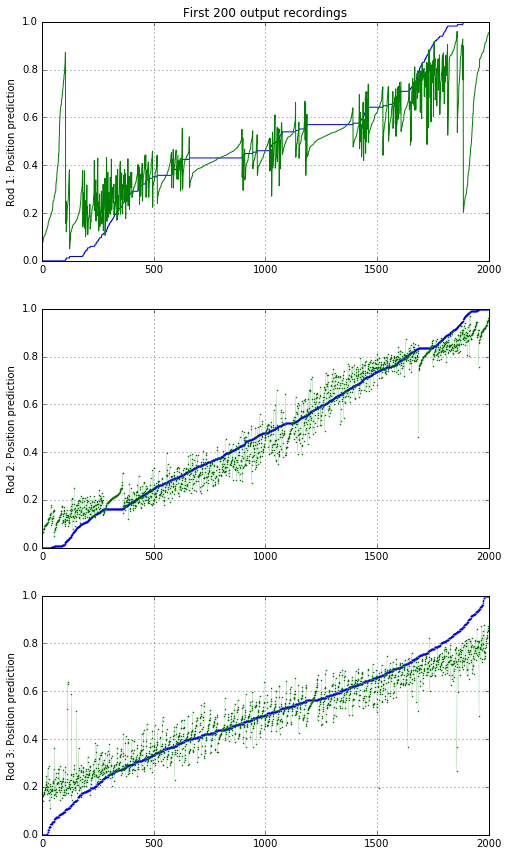

Epoch 30/30
4013/4013 [==============================] - 720s - loss: 0.0227 - mse: 2.2709e-05 - val_loss: 0.0162 - val_mse: 1.6166e-05
Wrote model to pos_cnn_weights_29.hdf
Predicted.
array([[ 0.59393942,  0.21925133,  0.80756015],
       [ 0.56969696,  0.86631018,  0.90034366],
       [ 0.43030304,  0.5026738 ,  0.57731956],
       ..., 
       [ 0.56969696,  0.21925133,  0.        ],
       [ 0.41818181,  0.83957219,  0.71477664],
       [ 0.56969696,  0.03743315,  0.69072163]], dtype=float32)
array([[ 0.56463295,  0.23312613,  0.5323475 ],
       [ 0.59265995,  0.80722743,  0.75414622],
       [ 0.4241285 ,  0.49866915,  0.25907892],
       ..., 
       [ 0.58683389,  0.32107463,  0.46983925],
       [ 0.48112568,  0.82298058,  0.5299204 ],
       [ 0.58457994,  0.13950309,  0.53116864]], dtype=float32)


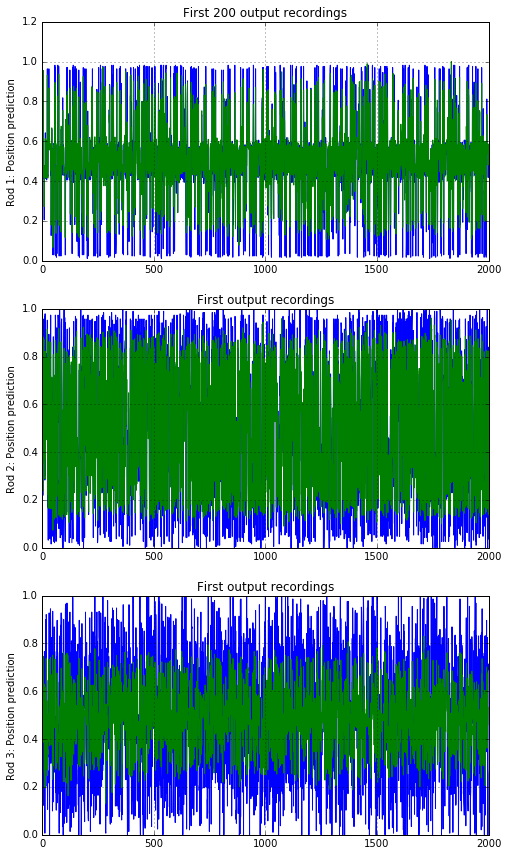

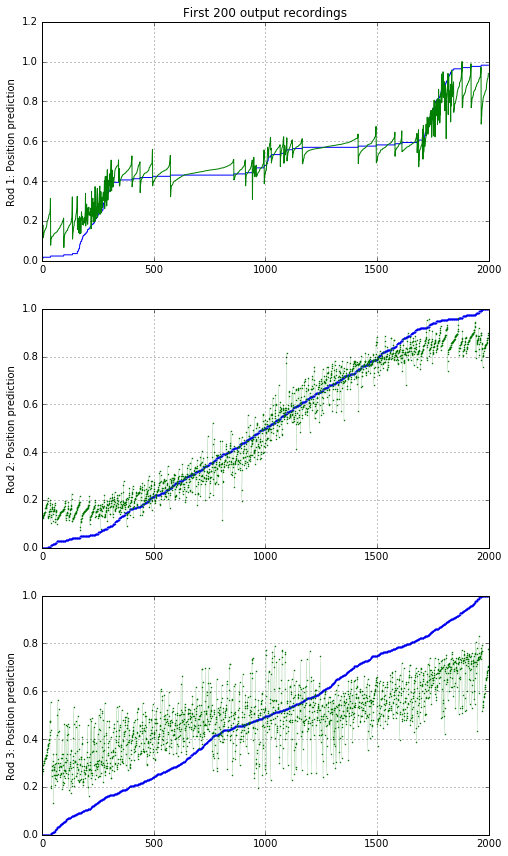

Epoch 1/1
4013/4013 [==============================] - 720s - loss: 0.0209 - mse: 2.0950e-05 - val_loss: 0.0131 - val_mse: 1.3064e-05
Wrote model to pos_cnn_weights_0.hdf
Predicted.
array([[ 0.41212121,  0.34632036,  0.08917198],
       [ 0.36363637,  0.66233766,  0.81528664],
       [ 0.78787881,  0.93506491,  0.25477707],
       ..., 
       [ 0.16969697,  0.94372296,  0.46496814],
       [ 0.33333334,  0.36363637,  0.19426751],
       [ 0.9878788 ,  0.42857143,  0.477707  ]], dtype=float32)
array([[ 0.37599865,  0.35607249,  0.08713341],
       [ 0.44445822,  0.68100429,  0.70501566],
       [ 0.82203496,  0.85149193,  0.41811368],
       ..., 
       [ 0.17258912,  0.96618545,  0.47109658],
       [ 0.39188573,  0.39723635,  0.42670187],
       [ 0.84302914,  0.58225167,  0.49274111]], dtype=float32)


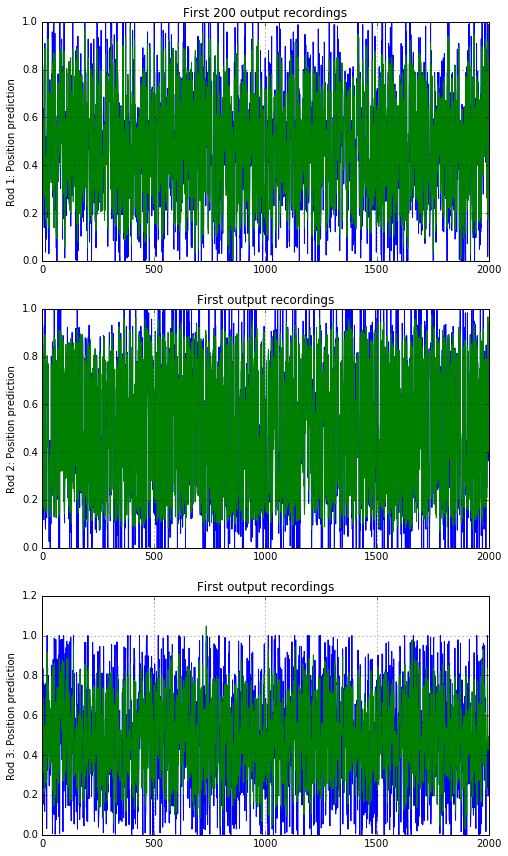

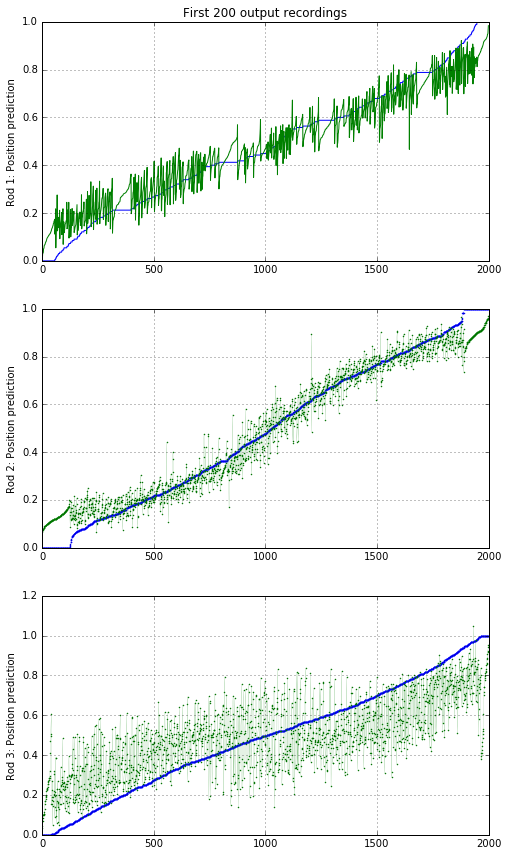

Epoch 2/2
4013/4013 [==============================] - 719s - loss: 0.0206 - mse: 2.0597e-05 - val_loss: 0.0123 - val_mse: 1.2267e-05
Wrote model to pos_cnn_weights_1.hdf
Predicted.
array([[ 0.41212121,  0.34632036,  0.08917198],
       [ 0.36363637,  0.66233766,  0.81528664],
       [ 0.78787881,  0.93506491,  0.25477707],
       ..., 
       [ 0.16969697,  0.94372296,  0.46496814],
       [ 0.66666669,  0.63636363,  0.80573249],
       [ 0.9878788 ,  0.42857143,  0.477707  ]], dtype=float32)
array([[ 0.37258467,  0.34575391,  0.13401133],
       [ 0.39822823,  0.66990036,  0.75272274],
       [ 0.81207514,  0.85449111,  0.41886446],
       ..., 
       [ 0.24344546,  0.87649834,  0.44922376],
       [ 0.72377133,  0.63244414,  0.57109249],
       [ 0.84254873,  0.52208352,  0.59011745]], dtype=float32)


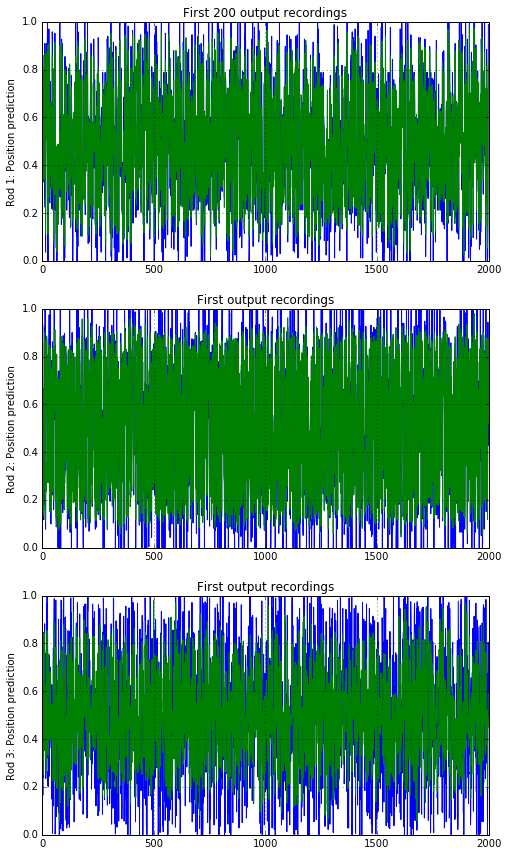

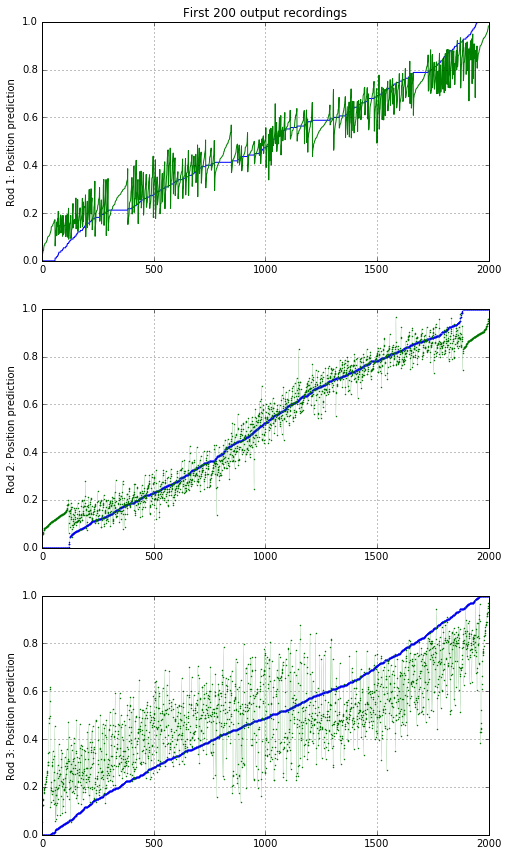

Epoch 3/3
4013/4013 [==============================] - 720s - loss: 0.0203 - mse: 2.0301e-05 - val_loss: 0.0130 - val_mse: 1.2991e-05
Wrote model to pos_cnn_weights_2.hdf
Predicted.
array([[ 0.43030304,  0.36065573,  0.32432431],
       [ 0.43030304,  0.55327868,  0.60000002],
       [ 0.9818182 ,  0.5942623 ,  0.56216216],
       ..., 
       [ 0.56969696,  0.49180329,  0.51891893],
       [ 0.55757576,  0.68032789,  0.1027027 ],
       [ 0.4969697 ,  0.38114753,  0.73513514]], dtype=float32)
array([[ 0.4321335 ,  0.37521136,  0.28231943],
       [ 0.39759508,  0.53789163,  0.58119369],
       [ 0.64147282,  0.5655396 ,  0.55718017],
       ..., 
       [ 0.56874913,  0.49640006,  0.52014405],
       [ 0.50342584,  0.62640905,  0.22815397],
       [ 0.42477015,  0.40701494,  0.7324214 ]], dtype=float32)


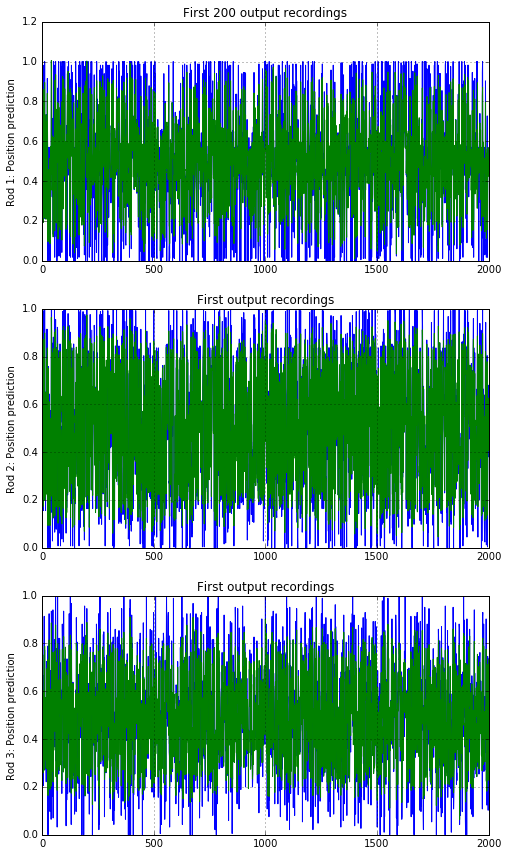

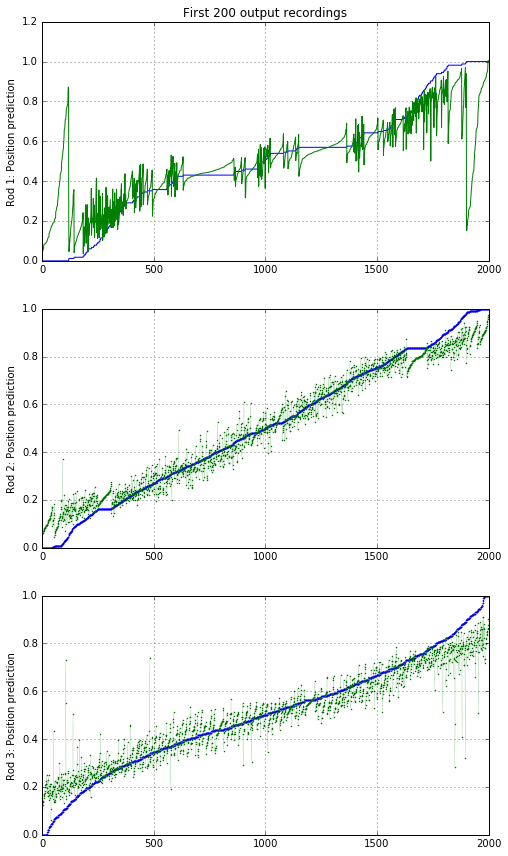

Epoch 4/4
4013/4013 [==============================] - 719s - loss: 0.0205 - mse: 2.0499e-05 - val_loss: 0.0122 - val_mse: 1.2239e-05
Wrote model to pos_cnn_weights_3.hdf
Predicted.
array([[ 0.41212121,  0.34632036,  0.08917198],
       [ 0.36363637,  0.66233766,  0.81528664],
       [ 0.78787881,  0.93506491,  0.25477707],
       ..., 
       [ 0.16969697,  0.94372296,  0.46496814],
       [ 0.66666669,  0.63636363,  0.80573249],
       [ 0.01212121,  0.5714286 ,  0.52229297]], dtype=float32)
array([[ 0.4265869 ,  0.33689266,  0.17803571],
       [ 0.40478715,  0.70230103,  0.74088776],
       [ 0.76783645,  0.83094263,  0.43327212],
       ..., 
       [ 0.2270309 ,  0.91286254,  0.51508826],
       [ 0.63331568,  0.62537658,  0.54813516],
       [ 0.07750821,  0.51653254,  0.49313101]], dtype=float32)


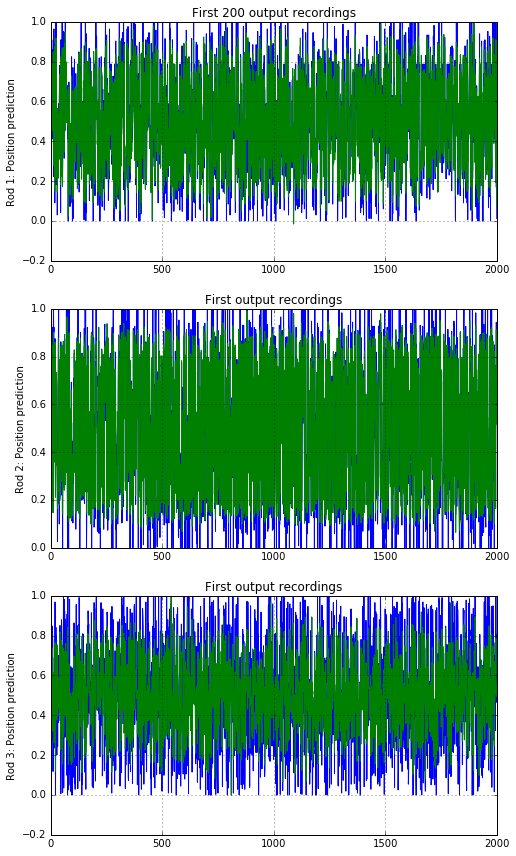

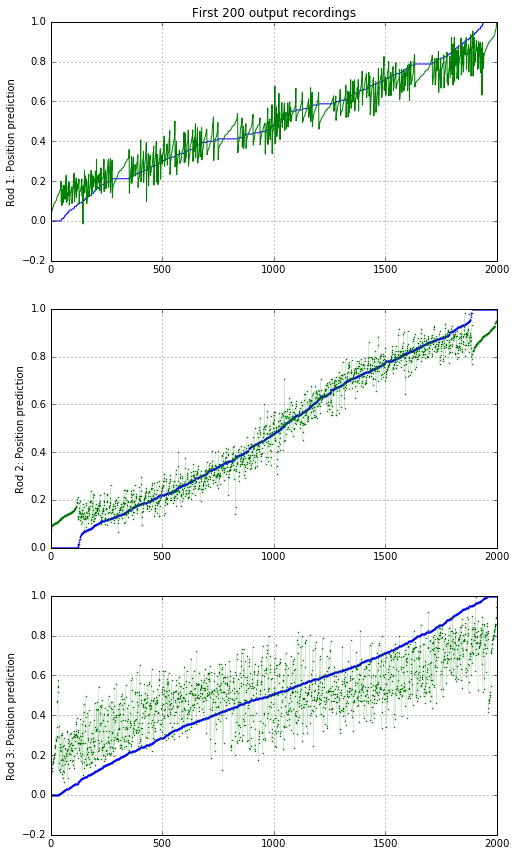

Epoch 5/5
4013/4013 [==============================] - 719s - loss: 0.0202 - mse: 2.0247e-05 - val_loss: 0.0127 - val_mse: 1.2704e-05
Wrote model to pos_cnn_weights_4.hdf
Predicted.
array([[ 0.58787876,  0.65367967,  0.91082805],
       [ 0.63636363,  0.33766234,  0.18471338],
       [ 0.21212122,  0.06493507,  0.74522293],
       ..., 
       [ 0.83030301,  0.05627706,  0.53503186],
       [ 0.66666669,  0.63636363,  0.80573249],
       [ 0.01212121,  0.5714286 ,  0.52229297]], dtype=float32)
array([[ 0.53739643,  0.65671456,  0.78666699],
       [ 0.52931505,  0.3163026 ,  0.25171262],
       [ 0.2318082 ,  0.18932995,  0.5151791 ],
       ..., 
       [ 0.72621769,  0.16732906,  0.60302293],
       [ 0.64566475,  0.58251679,  0.56776386],
       [ 0.156533  ,  0.45249748,  0.41729578]], dtype=float32)


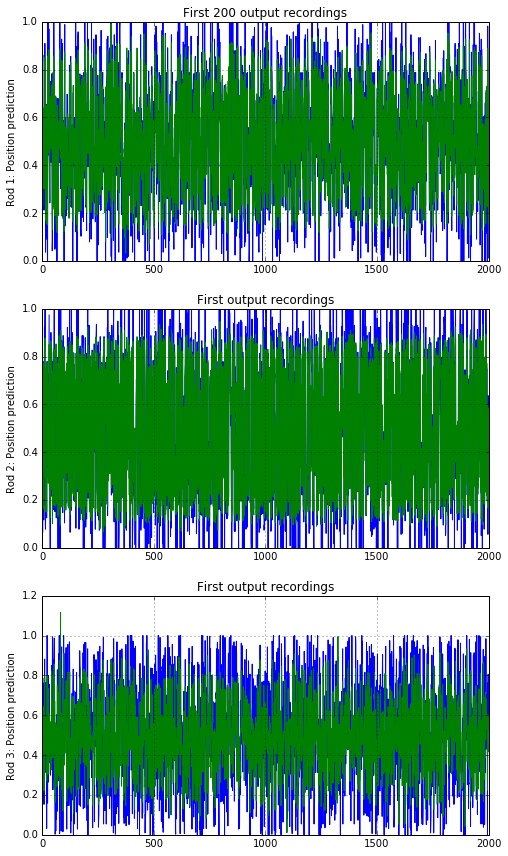

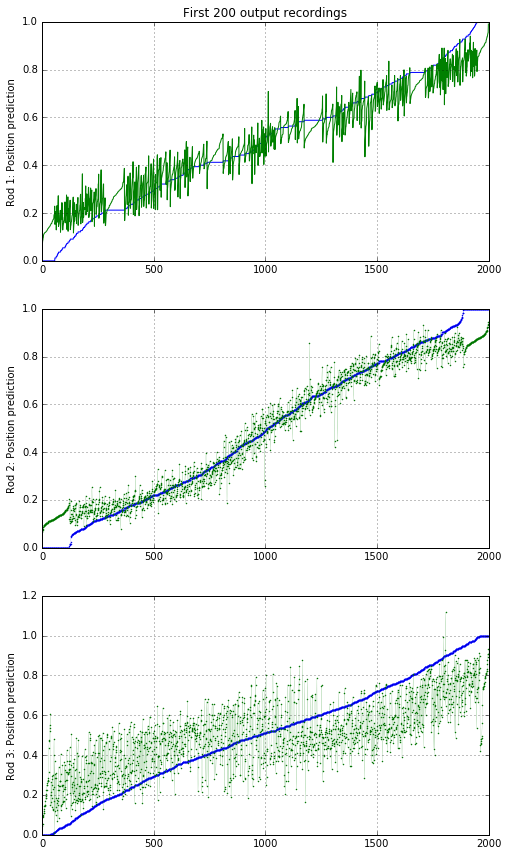

Epoch 6/6
4013/4013 [==============================] - 719s - loss: 0.0203 - mse: 2.0295e-05 - val_loss: 0.0128 - val_mse: 1.2834e-05
Wrote model to pos_cnn_weights_5.hdf
Predicted.
array([[ 0.59393942,  0.21925133,  0.80756015],
       [ 0.43030304,  0.13368984,  0.09965636],
       [ 0.43030304,  0.5026738 ,  0.57731956],
       ..., 
       [ 0.43030304,  0.78074867,  1.        ],
       [ 0.41818181,  0.83957219,  0.71477664],
       [ 0.43030304,  0.96256685,  0.30927834]], dtype=float32)
array([[ 0.56272525,  0.26036757,  0.74963993],
       [ 0.43692544,  0.24099104,  0.24599648],
       [ 0.44177181,  0.44192293,  0.2340731 ],
       ..., 
       [ 0.45549858,  0.79820383,  0.62242842],
       [ 0.45348653,  0.84178245,  0.41981414],
       [ 0.47013804,  0.91031647,  0.40940896]], dtype=float32)


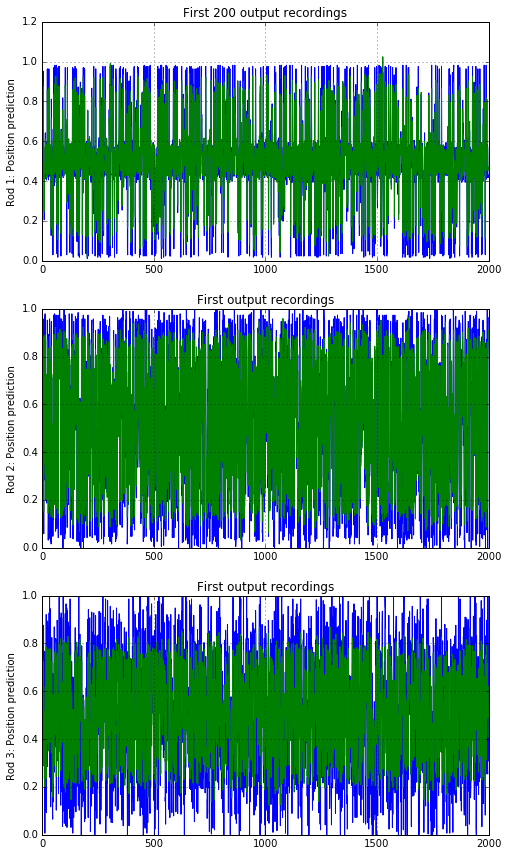

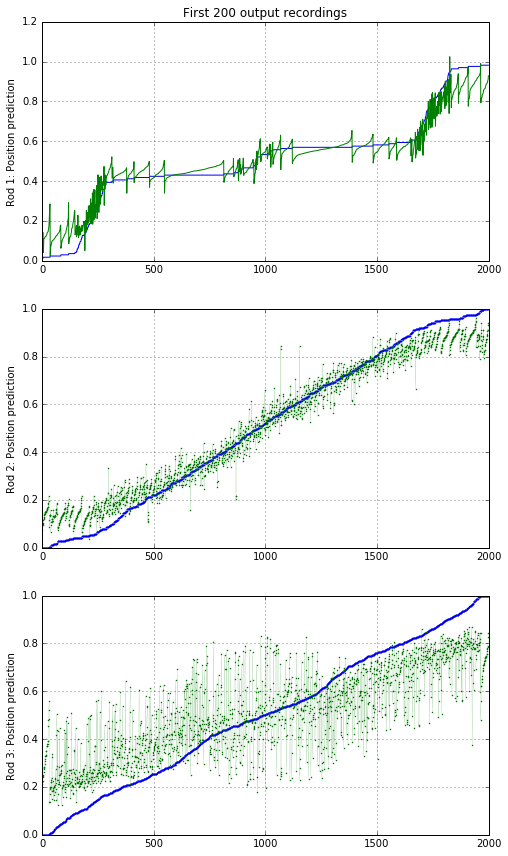

Epoch 7/7
4013/4013 [==============================] - 719s - loss: 0.0208 - mse: 2.0754e-05 - val_loss: 0.0126 - val_mse: 1.2581e-05
Wrote model to pos_cnn_weights_6.hdf
Predicted.
array([[ 0.41212121,  0.34632036,  0.08917198],
       [ 0.63636363,  0.33766234,  0.18471338],
       [ 0.21212122,  0.06493507,  0.74522293],
       ..., 
       [ 0.16969697,  0.94372296,  0.46496814],
       [ 0.33333334,  0.36363637,  0.19426751],
       [ 0.01212121,  0.5714286 ,  0.52229297]], dtype=float32)
array([[ 0.39559343,  0.33033672,  0.09866542],
       [ 0.56353742,  0.30548874,  0.23791134],
       [ 0.27399722,  0.20212469,  0.62309366],
       ..., 
       [ 0.17205456,  0.922418  ,  0.54735392],
       [ 0.31925467,  0.36524242,  0.44997168],
       [ 0.19391924,  0.42058384,  0.39846641]], dtype=float32)


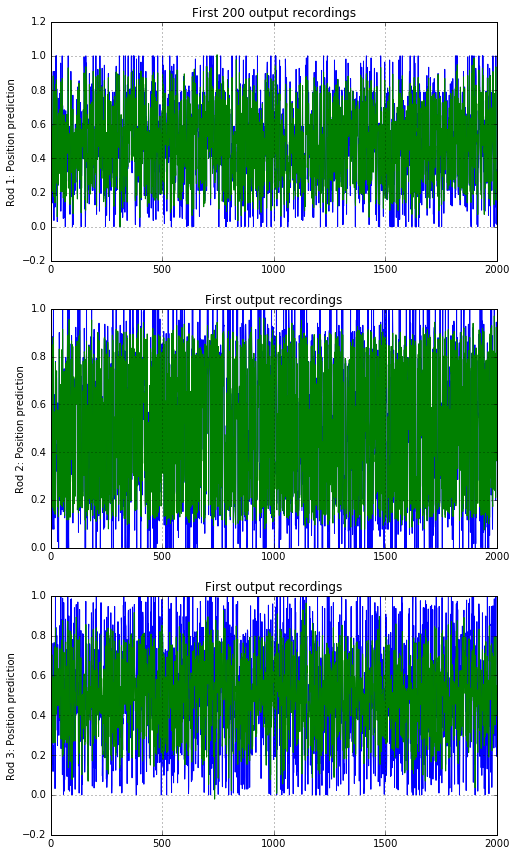

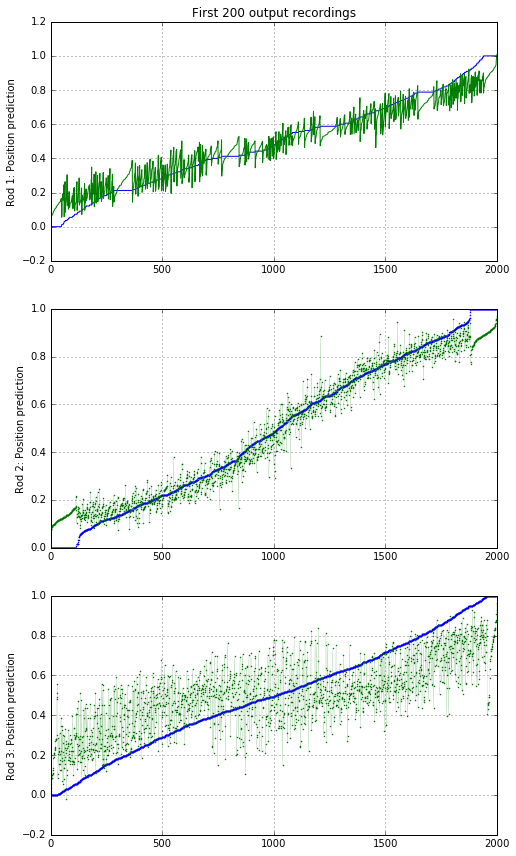

Epoch 8/8
4013/4013 [==============================] - 719s - loss: 0.0202 - mse: 2.0207e-05 - val_loss: 0.0127 - val_mse: 1.2694e-05
Wrote model to pos_cnn_weights_7.hdf
Predicted.
array([[ 0.43030304,  0.36065573,  0.32432431],
       [ 0.56969696,  0.44672132,  0.40000001],
       [ 0.9818182 ,  0.5942623 ,  0.56216216],
       ..., 
       [ 0.43030304,  0.50819671,  0.48108107],
       [ 0.44242424,  0.31967214,  0.89729732],
       [ 0.5030303 ,  0.61885244,  0.26486486]], dtype=float32)
array([[ 0.43784887,  0.3414129 ,  0.31477463],
       [ 0.5863238 ,  0.44550723,  0.45797241],
       [ 0.65583718,  0.60142326,  0.57113469],
       ..., 
       [ 0.48778352,  0.53498119,  0.51450026],
       [ 0.48114276,  0.3391681 ,  0.71847767],
       [ 0.50687897,  0.59780538,  0.25486016]], dtype=float32)


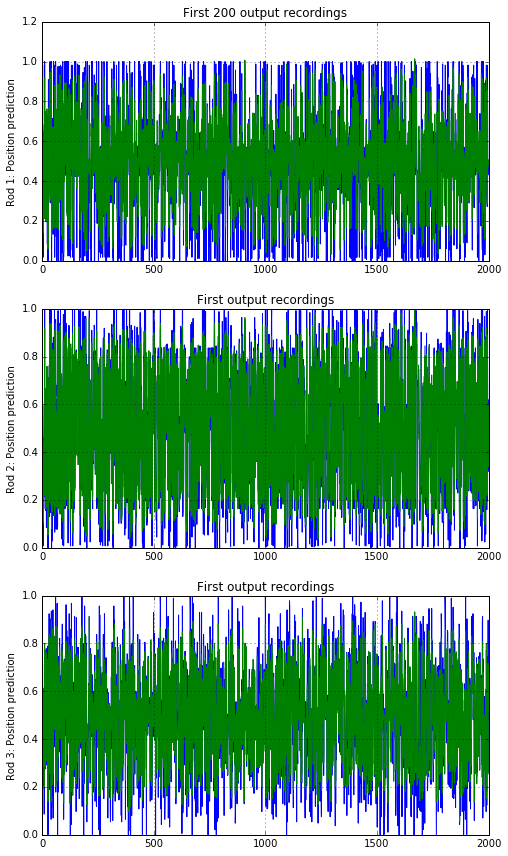

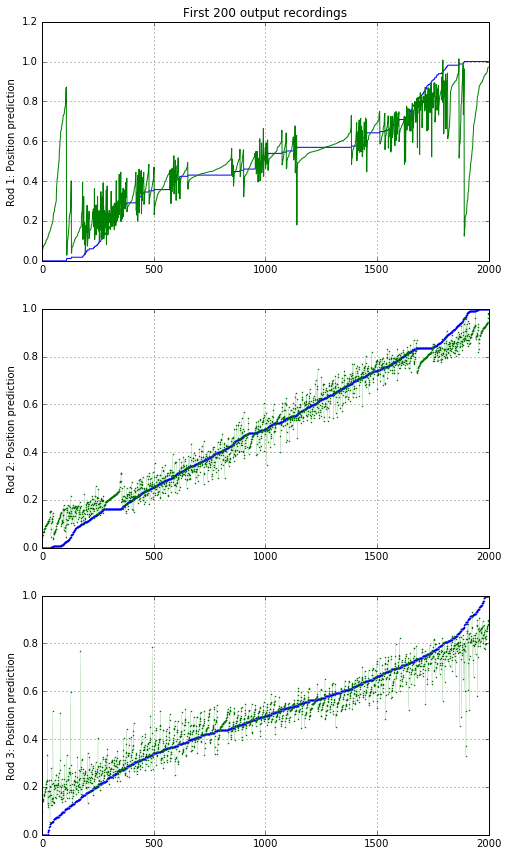

Epoch 9/9
4013/4013 [==============================] - 719s - loss: 0.0202 - mse: 2.0191e-05 - val_loss: 0.0117 - val_mse: 1.1723e-05
Wrote model to pos_cnn_weights_8.hdf
Predicted.
array([[ 0.59393942,  0.21925133,  0.80756015],
       [ 0.56969696,  0.86631018,  0.90034366],
       [ 0.56969696,  0.4973262 ,  0.42268041],
       ..., 
       [ 0.43030304,  0.78074867,  1.        ],
       [ 0.41818181,  0.83957219,  0.71477664],
       [ 0.43030304,  0.96256685,  0.30927834]], dtype=float32)
array([[ 0.54450411,  0.21762195,  0.69132853],
       [ 0.53078061,  0.82058984,  0.7456398 ],
       [ 0.53534108,  0.47567549,  0.75497735],
       ..., 
       [ 0.4222199 ,  0.81084305,  0.61330992],
       [ 0.45184812,  0.87909162,  0.46753281],
       [ 0.48145065,  0.85783589,  0.36855942]], dtype=float32)


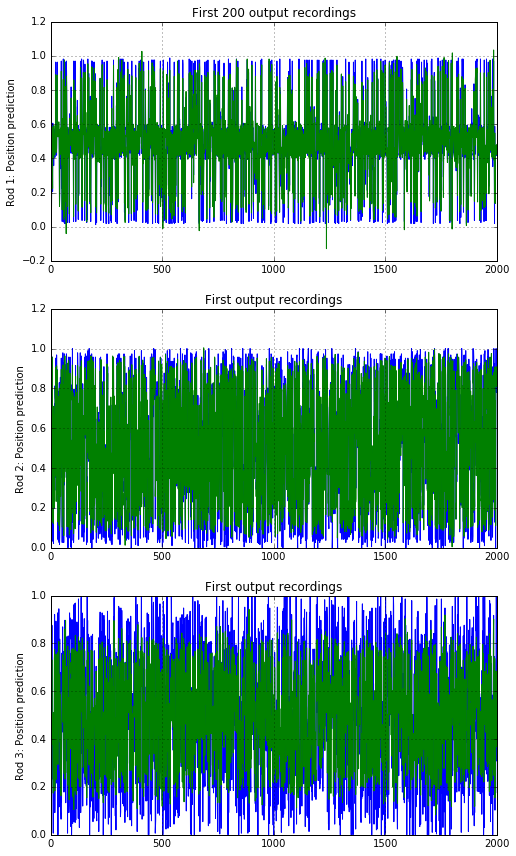

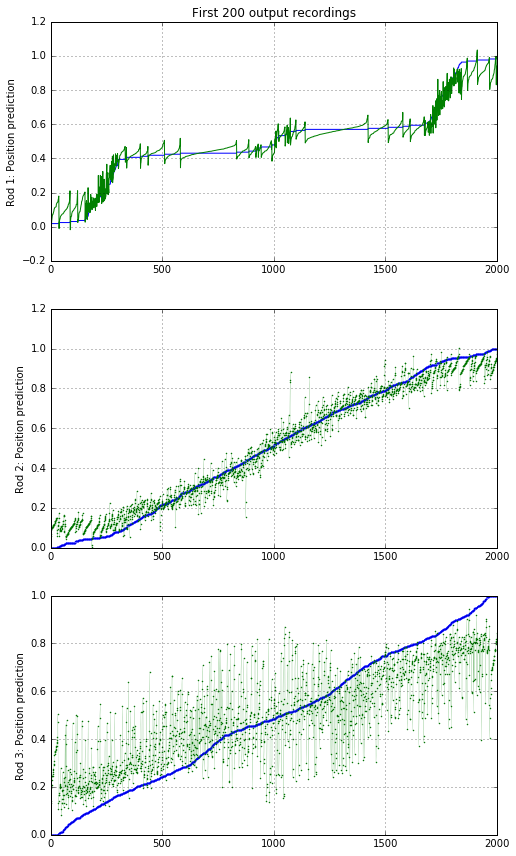

Epoch 10/10
4013/4013 [==============================] - 719s - loss: 0.0199 - mse: 1.9890e-05 - val_loss: 0.0128 - val_mse: 1.2784e-05
Wrote model to pos_cnn_weights_9.hdf
Predicted.
array([[ 0.40606061,  0.78074867,  0.19243987],
       [ 0.43030304,  0.13368984,  0.09965636],
       [ 0.56969696,  0.4973262 ,  0.42268041],
       ..., 
       [ 0.56969696,  0.21925133,  0.        ],
       [ 0.58181816,  0.16042781,  0.28522336],
       [ 0.43030304,  0.96256685,  0.30927834]], dtype=float32)
array([[ 0.45999059,  0.73891169,  0.21135136],
       [ 0.42510673,  0.21729334,  0.20289817],
       [ 0.54147196,  0.49072379,  0.77673477],
       ..., 
       [ 0.50748289,  0.33862621,  0.3183324 ],
       [ 0.56965536,  0.11840522,  0.42833209],
       [ 0.42555606,  0.88221192,  0.38530272]], dtype=float32)


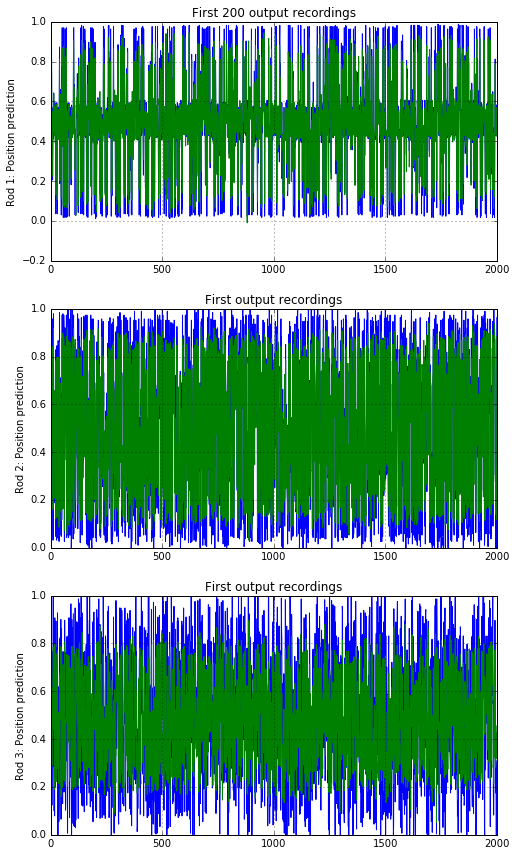

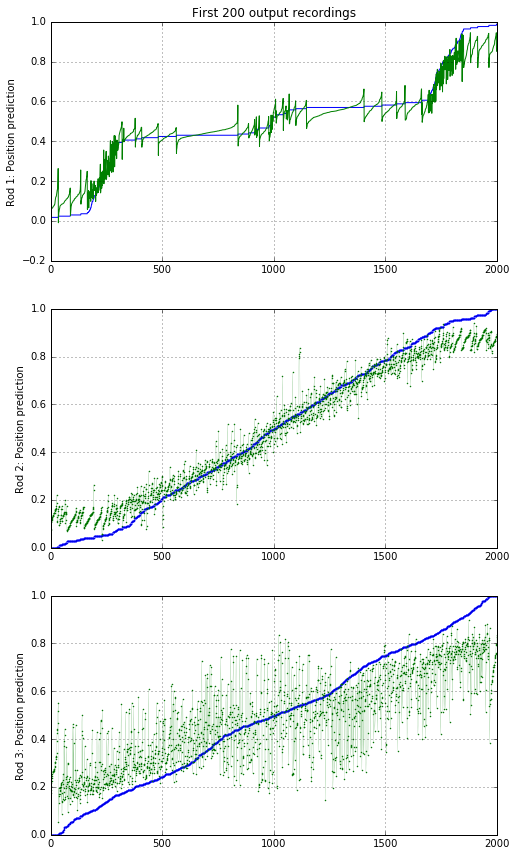

Epoch 11/11
4013/4013 [==============================] - 720s - loss: 0.0200 - mse: 2.0021e-05 - val_loss: 0.0125 - val_mse: 1.2471e-05
Wrote model to pos_cnn_weights_10.hdf
Predicted.
array([[ 0.59393942,  0.21925133,  0.80756015],
       [ 0.43030304,  0.13368984,  0.09965636],
       [ 0.43030304,  0.5026738 ,  0.57731956],
       ..., 
       [ 0.43030304,  0.78074867,  1.        ],
       [ 0.41818181,  0.83957219,  0.71477664],
       [ 0.43030304,  0.96256685,  0.30927834]], dtype=float32)
array([[ 0.53421849,  0.26865619,  0.65296847],
       [ 0.4272567 ,  0.1961351 ,  0.24961834],
       [ 0.43781129,  0.48582816,  0.23671263],
       ..., 
       [ 0.42419595,  0.77703381,  0.5512262 ],
       [ 0.47004625,  0.88716865,  0.45760432],
       [ 0.43179426,  0.87512887,  0.43306711]], dtype=float32)


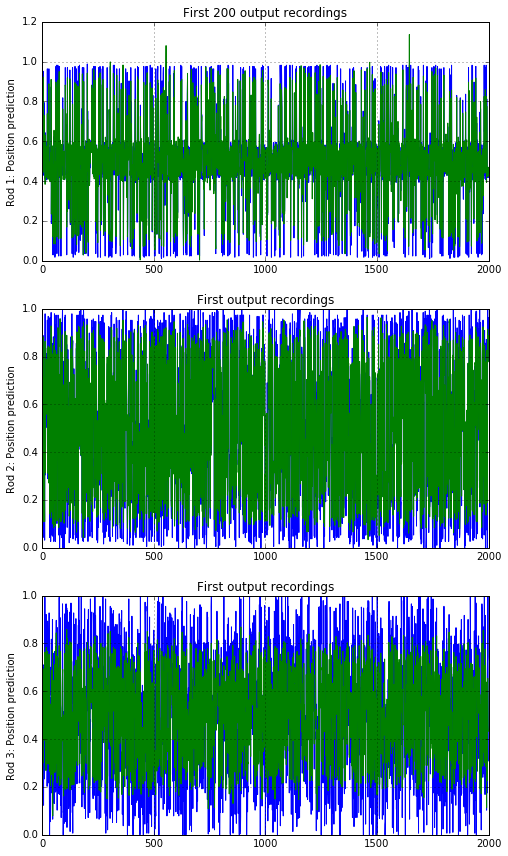

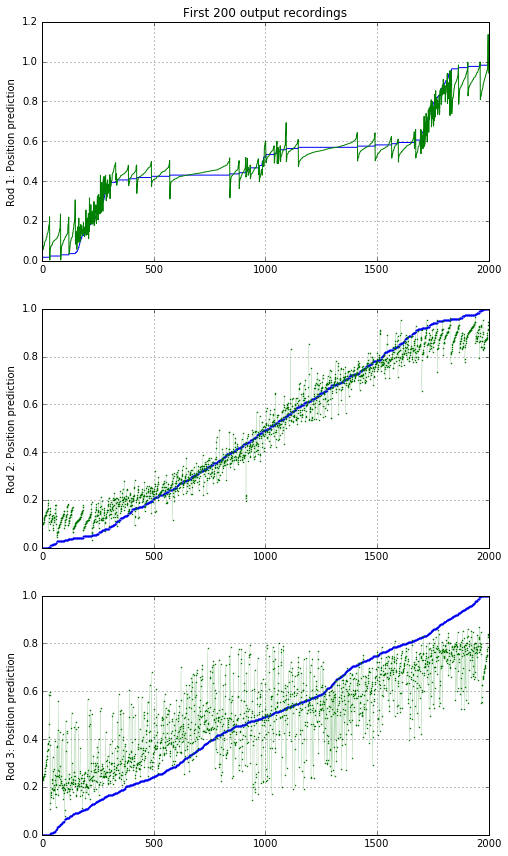

Epoch 12/12
4013/4013 [==============================] - 719s - loss: 0.0201 - mse: 2.0131e-05 - val_loss: 0.0130 - val_mse: 1.2963e-05
Wrote model to pos_cnn_weights_11.hdf
Predicted.
array([[ 0.40606061,  0.78074867,  0.19243987],
       [ 0.56969696,  0.86631018,  0.90034366],
       [ 0.43030304,  0.5026738 ,  0.57731956],
       ..., 
       [ 0.56969696,  0.21925133,  0.        ],
       [ 0.58181816,  0.16042781,  0.28522336],
       [ 0.43030304,  0.96256685,  0.30927834]], dtype=float32)
array([[ 0.47309086,  0.76825893,  0.19275445],
       [ 0.57358557,  0.78734648,  0.75364661],
       [ 0.43794793,  0.48394072,  0.25553805],
       ..., 
       [ 0.58891875,  0.25790226,  0.42315614],
       [ 0.5691579 ,  0.18186477,  0.5353685 ],
       [ 0.46081111,  0.87380147,  0.4857471 ]], dtype=float32)


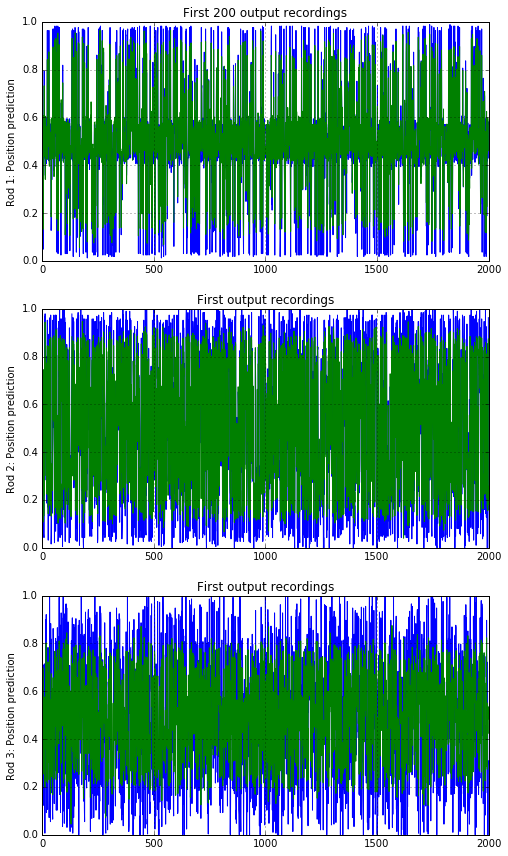

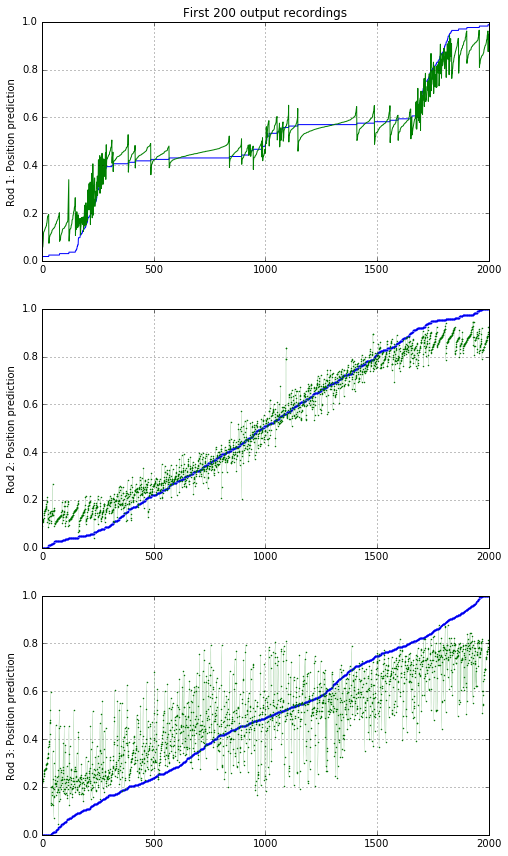

Epoch 13/13
3585/4013 [=========================>....] - ETA: 72s - loss: 0.0214 - mse: 2.1366e-05
User stopped the training.


In [7]:


def mse(y_true, y_pred):
    return K.square(y_pred - y_true)*0.001 # Hackjob so Keras iterations show exponential value of MSE to get precision.




print("Updated learner.")

# Train the model to predict the future position. This is the control signal to the robot AI
WEIGHTS_FNAME = 'pos_cnn_weights_%i.hdf'
MODELS_FNAME = 'pos_cnn_models_%i.h5'


batches_training_per_epoch = int(training.get_training_count() / batch_size)
batches_validation_per_epoch = int(training.get_validation_count() / batch_size)
print("Batch size %i: %i training batches, %i validation batches" % (batch_size, batches_training_per_epoch, batches_validation_per_epoch) )


model.compile(optimizer=keras.optimizers.RMSprop(lr=0.0001),
              loss='mean_squared_error',
              metrics=[mse])

model.reset_states()
for epoch in range(30):
    try:
        model.fit_generator(TrainBatchGen(batch_size, model, training), batches_training_per_epoch, epochs=epoch+1, verbose=1, callbacks=None, class_weight=None, max_q_size=10, workers=10, validation_data=ValidateBatchGen(batch_size, model, training), validation_steps = batches_validation_per_epoch, pickle_safe=False, initial_epoch=epoch)
        model.save_weights(WEIGHTS_FNAME % epoch)
        model.save(MODELS_FNAME % epoch)
        print(("Wrote model to " + WEIGHTS_FNAME )  % epoch)
        plot_validate(ValidateBatchGen(batch_size, model, training), model, 2000, "Position prediction")
    except KeyboardInterrupt:
        print("\r\nUser stopped the training.")
        break

model.compile(optimizer=keras.optimizers.RMSprop(lr=0.00001),
              loss='mean_squared_error',
              metrics=[mse])
        
for epoch in range(300):
    try:
        model.fit_generator(TrainBatchGen(batch_size, model, training), batches_training_per_epoch, epochs=epoch+1, verbose=1, callbacks=None, class_weight=None, max_q_size=10, workers=10, validation_data=ValidateBatchGen(batch_size, model, training), validation_steps = batches_validation_per_epoch, pickle_safe=False, initial_epoch=epoch)
        model.save_weights(WEIGHTS_FNAME % epoch)
        model.save(MODELS_FNAME % epoch)
        print(("Wrote model to " + WEIGHTS_FNAME )  % epoch)
        plot_validate(ValidateBatchGen(batch_size, model, training), model, 2000, "Position prediction")
    except KeyboardInterrupt:
        print("\r\nUser stopped the training.")
        break

In [8]:
model.compile(optimizer=keras.optimizers.RMSprop(lr=0.000001),
              loss='mean_squared_error',
              metrics=[mse])
        
for epoch in range(300):
    try:
        model.fit_generator(TrainBatchGen(batch_size, model, training), batches_training_per_epoch, epochs=epoch+1, verbose=1, callbacks=None, class_weight=None, max_q_size=10, workers=10, validation_data=ValidateBatchGen(batch_size, model, training), validation_steps = batches_validation_per_epoch, pickle_safe=False, initial_epoch=epoch)
        model.save_weights(WEIGHTS_FNAME % epoch)
        model.save(MODELS_FNAME % epoch)
        print(("Wrote model to " + WEIGHTS_FNAME )  % epoch)
        plot_validate(ValidateBatchGen(batch_size, model, training), model, 2000, "Position prediction")
    except KeyboardInterrupt:
        print("\r\nUser stopped the training.")
        break

Epoch 1/1
2468/4013 [=================>............] - ETA: 238s - loss: 0.0199 - mse: 1.9892e-05
User stopped the training.


# Test the best trained model's ability to extract the rod positions

In [9]:

# Load the best model result
epoch = 8
WEIGHTS_FNAME = 'pos_cnn_weights_%i.hdf'
model.load_weights(WEIGHTS_FNAME % epoch, by_name=True)
print("Loaded model.")



Loaded model.


Predicted.
array([[ 0.43030304,  0.36065573,  0.32432431],
       [ 0.43030304,  0.55327868,  0.60000002],
       [ 0.01818182,  0.4057377 ,  0.43783784],
       ..., 
       [ 0.56969696,  0.49180329,  0.51891893],
       [ 0.44242424,  0.31967214,  0.89729732],
       [ 0.5030303 ,  0.61885244,  0.26486486]], dtype=float32)
array([[ 0.47743461,  0.32128593,  0.26763174],
       [ 0.40188792,  0.53125882,  0.59905404],
       [ 0.26300833,  0.35841334,  0.4154861 ],
       ..., 
       [ 0.63950062,  0.46732622,  0.50719237],
       [ 0.43651283,  0.37445989,  0.89740205],
       [ 0.56200999,  0.59806424,  0.22616634]], dtype=float32)


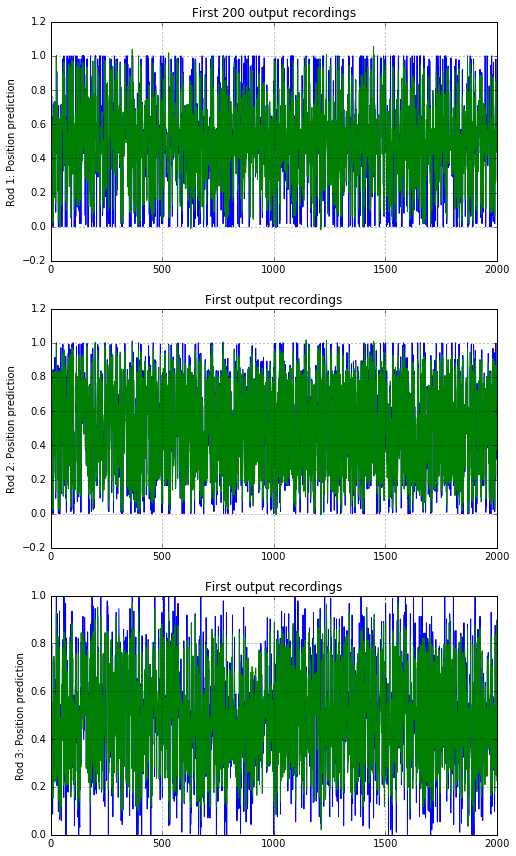

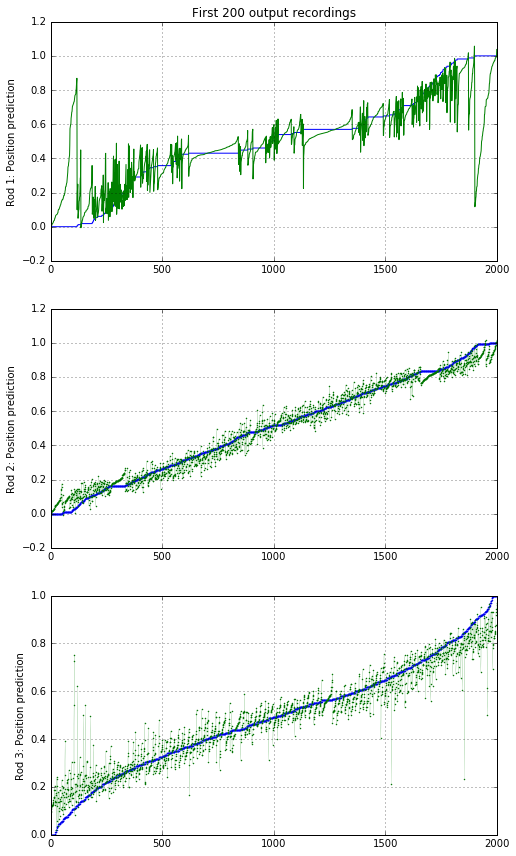

In [10]:
# Plot the real versus predicted values for some of the validation data
plot_validate(ValidateBatchGen(batch_size, model, training), model, 2000, "Position prediction")

# Transfer the model as a base to predict the future change in rod positions
The theory is that the model has designed filters that are able to successfully extract the rod positions. This is important information needed to make a good decision on how the rods should be moved. We take this base model which has learned how to track the rod positions as a base for the real AI that predicts the rod movements that are going to occur next.


In [6]:
# Load the best model result
epoch = 8
WEIGHTS_FNAME = 'pos_cnn_weights_%i.hdf'
model.load_weights(WEIGHTS_FNAME % epoch, by_name=True)
print("Loaded model.")




Loaded model.


Updated learner.
Batch size 10: 4013 training batches, 1001 validation batches
Epoch 1/1
4013/4013 [==============================] - 723s - loss: 0.0048 - mse: 4.8218e-06 - val_loss: 0.0034 - val_mse: 3.4293e-06
Wrote model to dpos_cnn_weights_0.hdf
Predicted.
array([[ 0.        ,  0.02868852,  0.05405406],
       [ 0.        , -0.03688525, -0.02162162],
       [ 0.02424242,  0.05737705,  0.        ],
       ..., 
       [ 0.        ,  0.06967213,  0.05405406],
       [ 0.        ,  0.00409836,  0.01081081],
       [ 0.        ,  0.00409836,  0.00540541]], dtype=float32)
array([[-0.00258443,  0.00950903,  0.02337245],
       [-0.01186013, -0.03523191, -0.03376859],
       [-0.0017163 , -0.00565749, -0.02733653],
       ..., 
       [ 0.00383538,  0.07146543,  0.01474302],
       [-0.00252173, -0.00811494, -0.01452745],
       [-0.00335691, -0.01368524,  0.00622507]], dtype=float32)


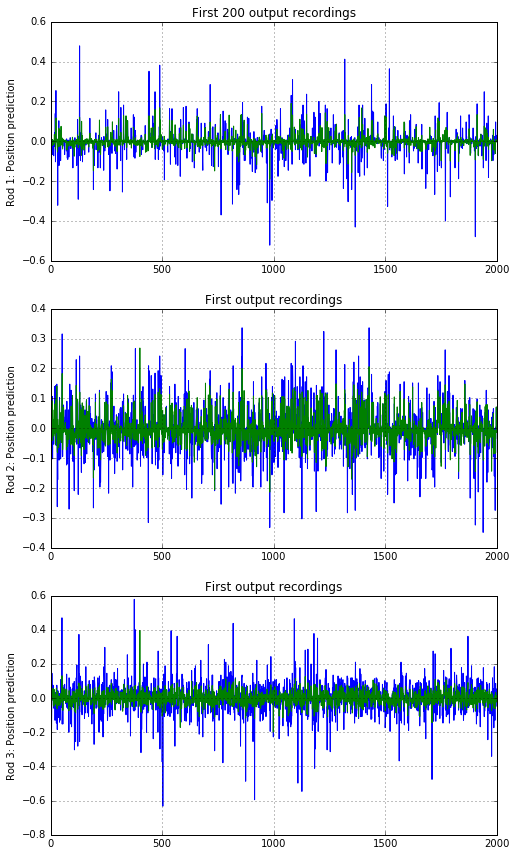

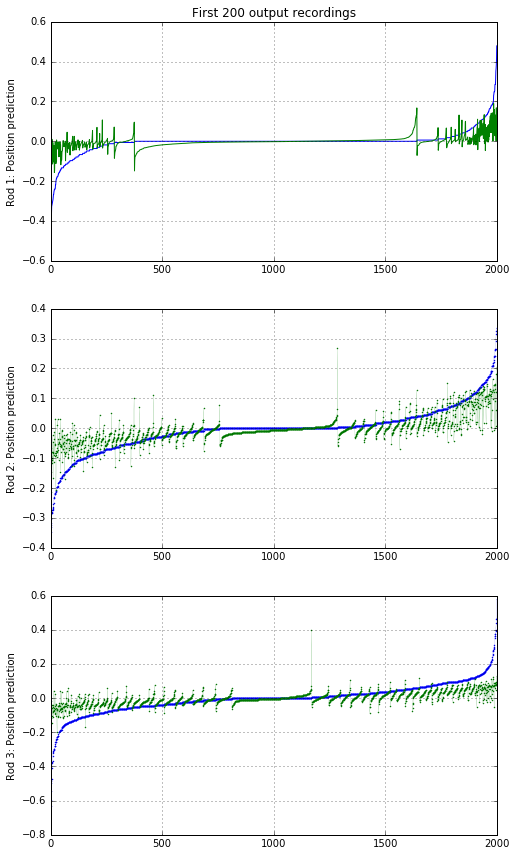

Epoch 2/2
4013/4013 [==============================] - 723s - loss: 0.0037 - mse: 3.7133e-06 - val_loss: 0.0035 - val_mse: 3.4598e-06
Wrote model to dpos_cnn_weights_1.hdf
Epoch 3/3
4013/4013 [==============================] - 720s - loss: 0.0036 - mse: 3.6165e-06 - val_loss: 0.0031 - val_mse: 3.1268e-06
Wrote model to dpos_cnn_weights_2.hdf
Epoch 4/4
4013/4013 [==============================] - 721s - loss: 0.0034 - mse: 3.4218e-06 - val_loss: 0.0032 - val_mse: 3.1649e-06
Wrote model to dpos_cnn_weights_3.hdf
Predicted.
array([[ 0.        ,  0.07792208,  0.06050956],
       [ 0.        ,  0.        ,  0.        ],
       [ 0.34545454,  0.        , -0.04458599],
       ..., 
       [-0.07272727,  0.        , -0.00955414],
       [ 0.        ,  0.        ,  0.        ],
       [-0.09696969,  0.06926407, -0.00636943]], dtype=float32)
array([[ 0.0111374 ,  0.06014331,  0.0323127 ],
       [ 0.00227033,  0.00207485,  0.0052495 ],
       [ 0.23928799, -0.02580128, -0.03837129],
       ..., 

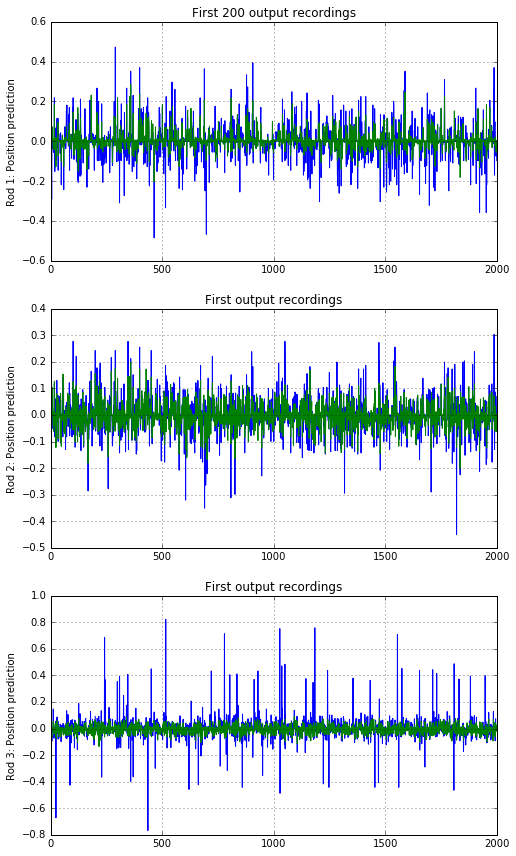

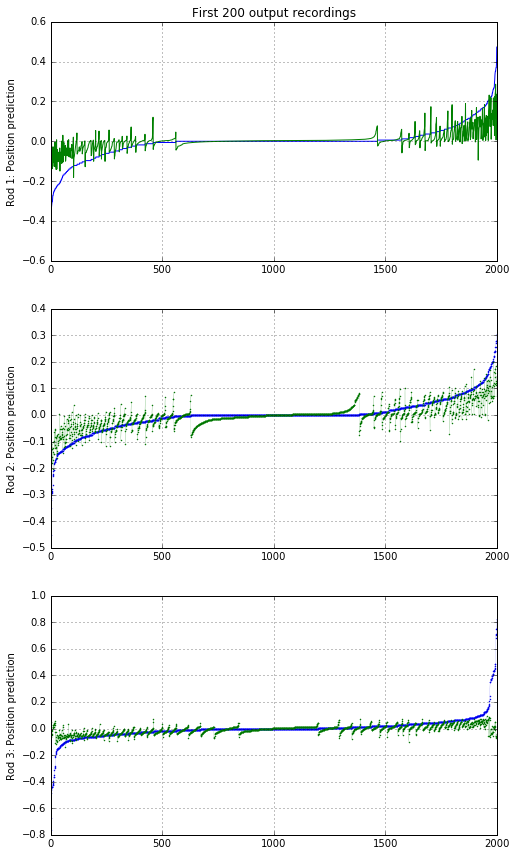

Epoch 5/5
4013/4013 [==============================] - 781s - loss: 0.0034 - mse: 3.3679e-06 - val_loss: 0.0030 - val_mse: 2.9646e-06
Wrote model to dpos_cnn_weights_4.hdf
Epoch 6/6
4013/4013 [==============================] - 725s - loss: 0.0032 - mse: 3.2465e-06 - val_loss: 0.0031 - val_mse: 3.1289e-06
Wrote model to dpos_cnn_weights_5.hdf
Epoch 7/7
4013/4013 [==============================] - 723s - loss: 0.0032 - mse: 3.2350e-06 - val_loss: 0.0034 - val_mse: 3.3808e-06
Wrote model to dpos_cnn_weights_6.hdf
Predicted.
array([[ 0.        ,  0.07792208,  0.06050956],
       [ 0.        ,  0.        ,  0.        ],
       [ 0.34545454,  0.        , -0.04458599],
       ..., 
       [-0.07272727,  0.        , -0.00955414],
       [ 0.        ,  0.        ,  0.        ],
       [-0.09696969,  0.06926407, -0.00636943]], dtype=float32)
array([[ 0.00626373,  0.0272257 ,  0.04956664],
       [-0.00084975,  0.00061764,  0.00321486],
       [ 0.19258825,  0.01808208,  0.00105191],
       ..., 

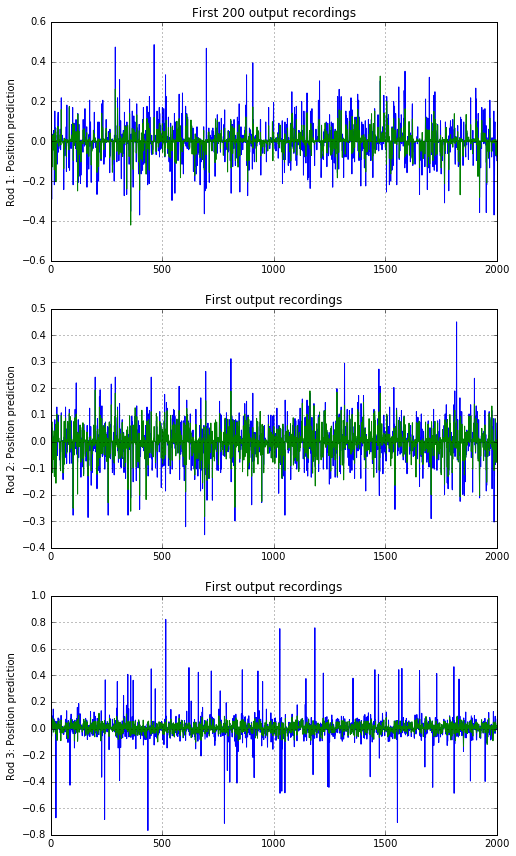

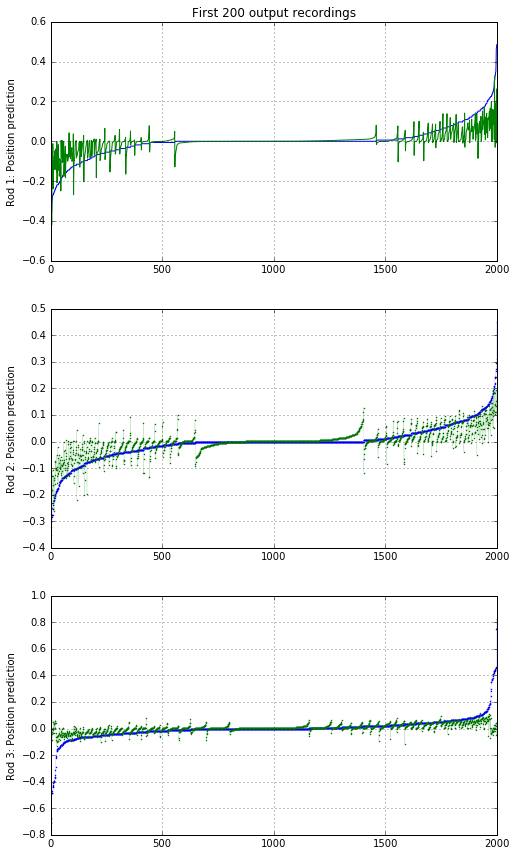

Epoch 8/8
4013/4013 [==============================] - 720s - loss: 0.0032 - mse: 3.2407e-06 - val_loss: 0.0033 - val_mse: 3.2722e-06
Wrote model to dpos_cnn_weights_7.hdf
Epoch 9/9
4013/4013 [==============================] - 721s - loss: 0.0032 - mse: 3.1791e-06 - val_loss: 0.0029 - val_mse: 2.9451e-06
Wrote model to dpos_cnn_weights_8.hdf
Epoch 10/10
4013/4013 [==============================] - 721s - loss: 0.0032 - mse: 3.2450e-06 - val_loss: 0.0029 - val_mse: 2.8807e-06
Wrote model to dpos_cnn_weights_9.hdf
Predicted.
array([[ 0.        , -0.02868852, -0.05405406],
       [ 0.        , -0.03688525, -0.02162162],
       [ 0.02424242,  0.05737705,  0.        ],
       ..., 
       [ 0.        ,  0.06967213,  0.05405406],
       [ 0.        , -0.00409836, -0.01081081],
       [ 0.        , -0.00409836, -0.00540541]], dtype=float32)
array([[ 0.00207991, -0.02900525, -0.03894466],
       [-0.00249847, -0.06898871, -0.03802484],
       [ 0.00778658,  0.00320298, -0.02938896],
       ...

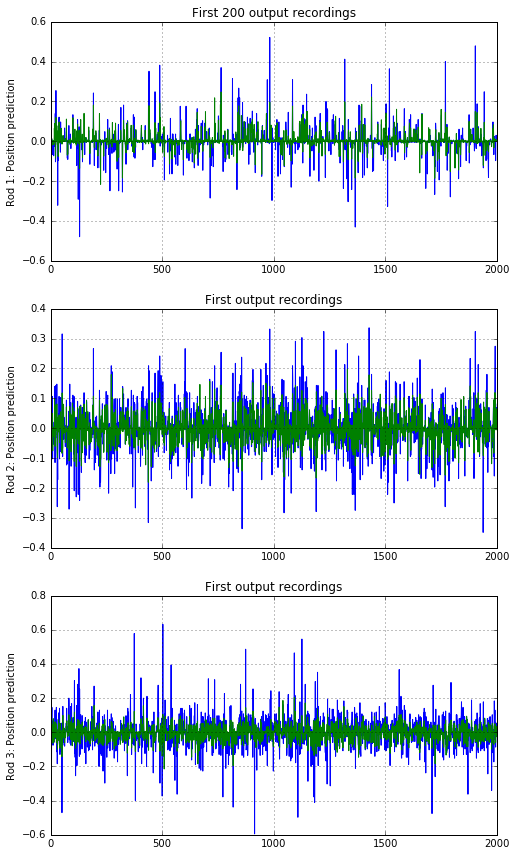

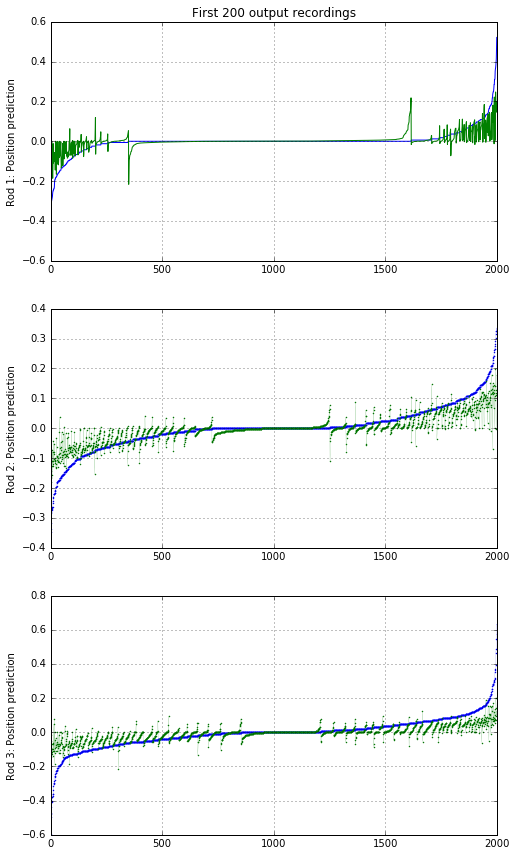

Epoch 11/11
4013/4013 [==============================] - 721s - loss: 0.0032 - mse: 3.1951e-06 - val_loss: 0.0029 - val_mse: 2.9172e-06
Wrote model to dpos_cnn_weights_10.hdf
Epoch 12/12
4013/4013 [==============================] - 721s - loss: 0.0031 - mse: 3.1284e-06 - val_loss: 0.0027 - val_mse: 2.7407e-06
Wrote model to dpos_cnn_weights_11.hdf
Epoch 13/13
4013/4013 [==============================] - 776s - loss: 0.0032 - mse: 3.1886e-06 - val_loss: 0.0027 - val_mse: 2.7332e-06
Wrote model to dpos_cnn_weights_12.hdf
Predicted.
array([[ 0.        ,  0.0855615 , -0.00687285],
       [ 0.        ,  0.05347594,  0.0137457 ],
       [ 0.        ,  0.06951872,  0.05498282],
       ..., 
       [ 0.        , -0.02139037, -0.0137457 ],
       [ 0.        ,  0.        ,  0.00687285],
       [ 0.        ,  0.        , -0.02749141]], dtype=float32)
array([[ 0.00992194,  0.04776107,  0.02038512],
       [ 0.00129157,  0.00677582,  0.00716103],
       [-0.00605678,  0.01889912,  0.04938655],
   

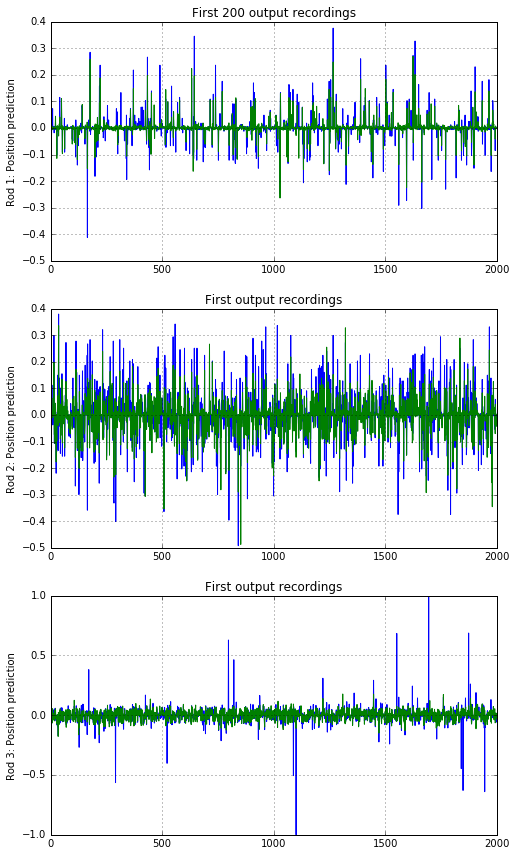

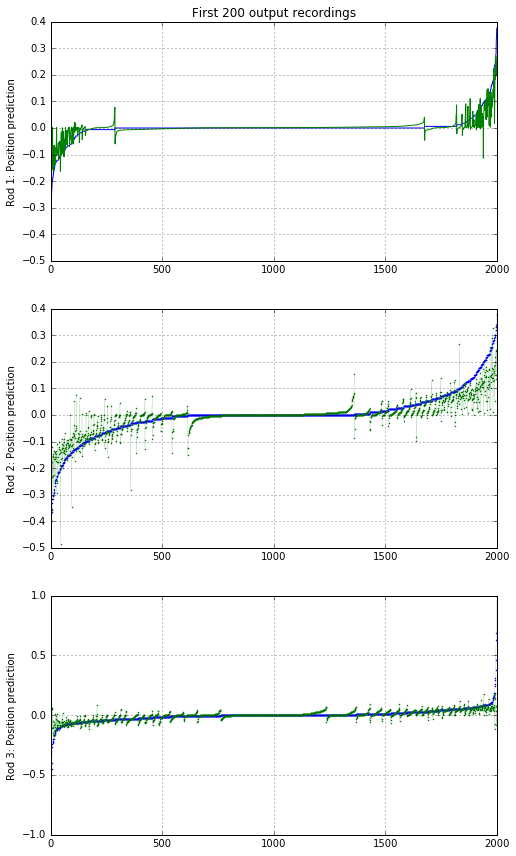

Epoch 14/14
4013/4013 [==============================] - 721s - loss: 0.0032 - mse: 3.1533e-06 - val_loss: 0.0029 - val_mse: 2.8617e-06
Wrote model to dpos_cnn_weights_13.hdf
Epoch 15/15
4013/4013 [==============================] - 721s - loss: 0.0031 - mse: 3.1289e-06 - val_loss: 0.0034 - val_mse: 3.3552e-06
Wrote model to dpos_cnn_weights_14.hdf
Epoch 1/1
4012/4013 [============================>.] - ETA: 0s - loss: 0.1112 - mse: 1.1116e-04
User stopped the training.


In [13]:


def mse(y_true, y_pred):
    return K.square(y_pred - y_true)*0.001 # Hackjob so Keras iterations show exponential value of MSE to get precision.




print("Updated learner.")

# Train the model to predict the future position. This is the control signal to the robot AI
WEIGHTS_FNAME = 'dpos_cnn_weights_%i.hdf'
MODELS_FNAME = 'dpos_cnn_models_%i.h5'


batches_training_per_epoch = int(training.get_training_count() / batch_size)
batches_validation_per_epoch = int(training.get_validation_count() / batch_size)
print("Batch size %i: %i training batches, %i validation batches" % (batch_size, batches_training_per_epoch, batches_validation_per_epoch) )


model.compile(optimizer=keras.optimizers.RMSprop(lr=0.0001),
              loss='mean_squared_error',
              metrics=[mse])

model.reset_states()
for epoch in range(15):
    try:
        model.fit_generator(TrainBatchGenDpos(batch_size, model, training), batches_training_per_epoch, epochs=epoch+1, verbose=1, callbacks=None, class_weight=None, max_q_size=10, workers=10, validation_data=ValidateBatchGenDpos(batch_size, model, training), validation_steps = batches_validation_per_epoch, pickle_safe=False, initial_epoch=epoch)
        model.save_weights(WEIGHTS_FNAME % epoch)
        model.save(MODELS_FNAME % epoch)
        print(("Wrote model to " + WEIGHTS_FNAME )  % epoch)
        
        if epoch % 3 == 0:
            plot_validate(ValidateBatchGenDpos(batch_size, model, training), model, 2000, "Position prediction")
    except KeyboardInterrupt:
        print("\r\nUser stopped the training.")
        break

model.compile(optimizer=keras.optimizers.RMSprop(lr=0.00001),
              loss='mean_squared_error',
              metrics=[mse])
        
for epoch in range(300):
    try:
        model.fit_generator(TrainBatchGenDpos(batch_size, model, training), batches_training_per_epoch, epochs=epoch+1, verbose=1, callbacks=None, class_weight=None, max_q_size=10, workers=10, validation_data=ValidateBatchGenDpos(batch_size, model, training), validation_steps = batches_validation_per_epoch, pickle_safe=False, initial_epoch=epoch)
        model.save_weights(WEIGHTS_FNAME % epoch)
        model.save(MODELS_FNAME % epoch)
        print(("Wrote model to " + WEIGHTS_FNAME )  % epoch)
        
        if epoch % 3 == 0:
            plot_validate(ValidateBatchGenDpos(batch_size, model, training), model, 2000, "Position prediction")
    except KeyboardInterrupt:
        print("\r\nUser stopped the training.")
        break

Loaded model.
Predicted.
array([[ 0.        ,  0.02868852,  0.05405406],
       [ 0.        , -0.03688525, -0.02162162],
       [-0.02424242, -0.05737705,  0.        ],
       ..., 
       [ 0.        ,  0.06967213,  0.05405406],
       [ 0.        , -0.00409836, -0.01081081],
       [ 0.        , -0.00409836, -0.00540541]], dtype=float32)
array([[ -1.99753023e-03,   3.79606523e-02,   3.36619616e-02],
       [ -5.56834100e-04,  -9.26964656e-02,  -3.12245730e-02],
       [ -4.24786424e-03,   8.42134282e-03,   3.89097482e-02],
       ..., 
       [ -2.24825111e-03,   6.31511733e-02,   3.29187438e-02],
       [  4.57085844e-05,   1.33162469e-03,   1.80611212e-03],
       [  2.40027031e-04,  -2.79674516e-03,  -1.04898924e-03]], dtype=float32)


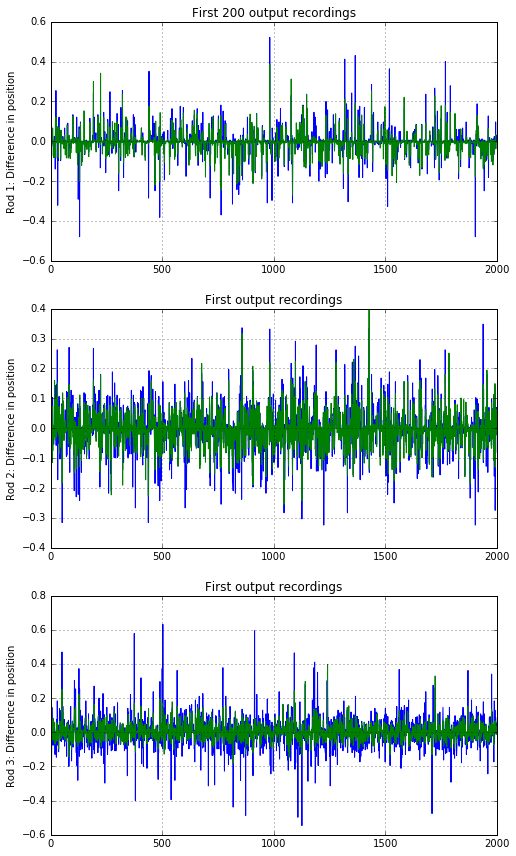

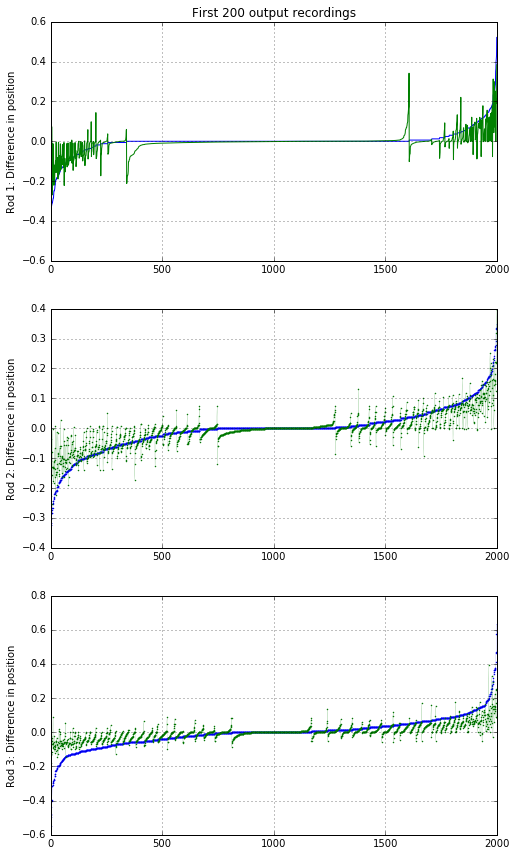

Epoch 1/1
4013/4013 [==============================] - 726s - loss: 0.0030 - mse: 2.9980e-06 - val_loss: 0.0026 - val_mse: 2.6142e-06
Wrote model to dpos_cnn_weights_0.hdf
Predicted.
array([[ 0.        ,  0.07792208,  0.06050956],
       [ 0.        ,  0.        ,  0.        ],
       [-0.34545454,  0.        ,  0.04458599],
       ..., 
       [ 0.07272727,  0.        ,  0.00955414],
       [ 0.        ,  0.        ,  0.        ],
       [ 0.09696969, -0.06926407,  0.00636943]], dtype=float32)
array([[ 0.00703145,  0.05719624,  0.03903398],
       [ 0.00070858,  0.00034498,  0.00159774],
       [-0.09827941, -0.00315805,  0.02419021],
       ..., 
       [ 0.00646145,  0.03434766,  0.02513222],
       [ 0.00069615,  0.00028258,  0.00159497],
       [ 0.00041035, -0.00286257,  0.00045024]], dtype=float32)


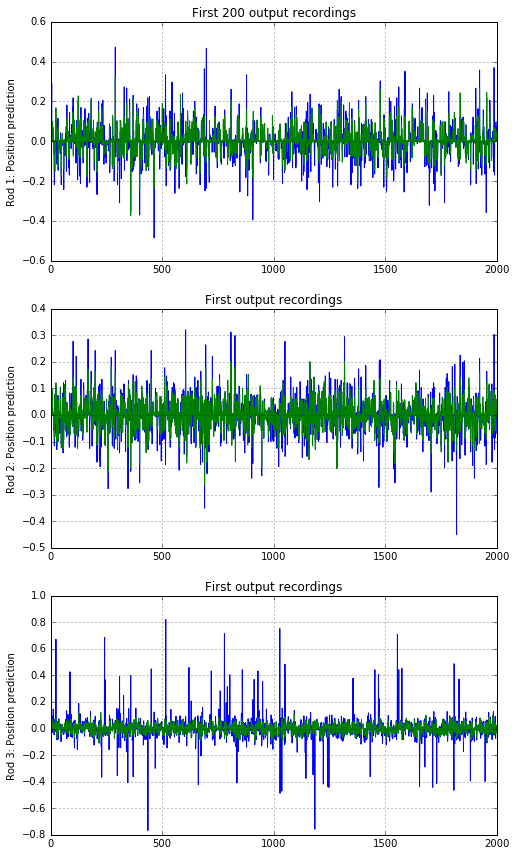

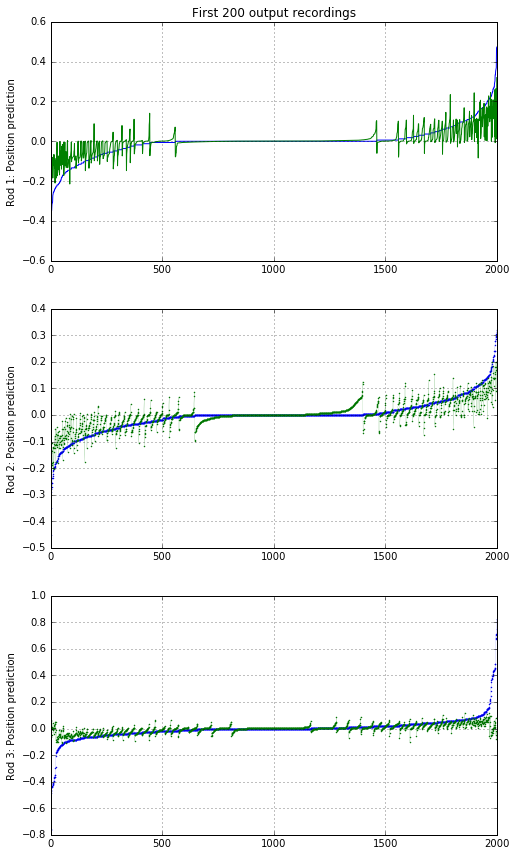

Epoch 2/2
4013/4013 [==============================] - 721s - loss: 0.0029 - mse: 2.9298e-06 - val_loss: 0.0027 - val_mse: 2.6587e-06
Wrote model to dpos_cnn_weights_1.hdf
Epoch 3/3
4013/4013 [==============================] - 721s - loss: 0.0029 - mse: 2.9172e-06 - val_loss: 0.0026 - val_mse: 2.6089e-06
Wrote model to dpos_cnn_weights_2.hdf
Epoch 4/4
4013/4013 [==============================] - 721s - loss: 0.0029 - mse: 2.9445e-06 - val_loss: 0.0026 - val_mse: 2.6357e-06
Wrote model to dpos_cnn_weights_3.hdf
Predicted.
array([[ 0.        , -0.02868852, -0.05405406],
       [ 0.        , -0.03688525, -0.02162162],
       [-0.02424242, -0.05737705,  0.        ],
       ..., 
       [ 0.        ,  0.06967213,  0.05405406],
       [ 0.        ,  0.00409836,  0.01081081],
       [ 0.        ,  0.00409836,  0.00540541]], dtype=float32)
array([[  7.04737249e-05,  -2.56171599e-02,  -4.39230092e-02],
       [ -6.14068611e-03,  -7.84241930e-02,  -3.93936560e-02],
       [ -3.43151465e-02,  -3.

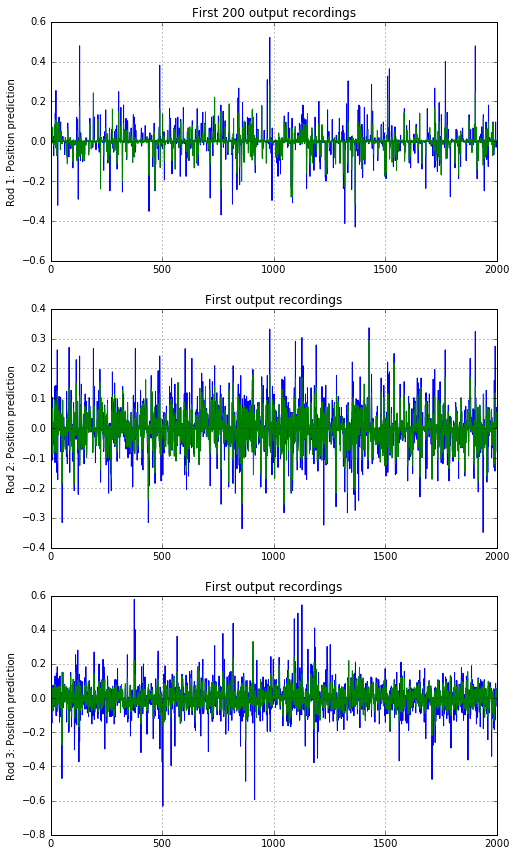

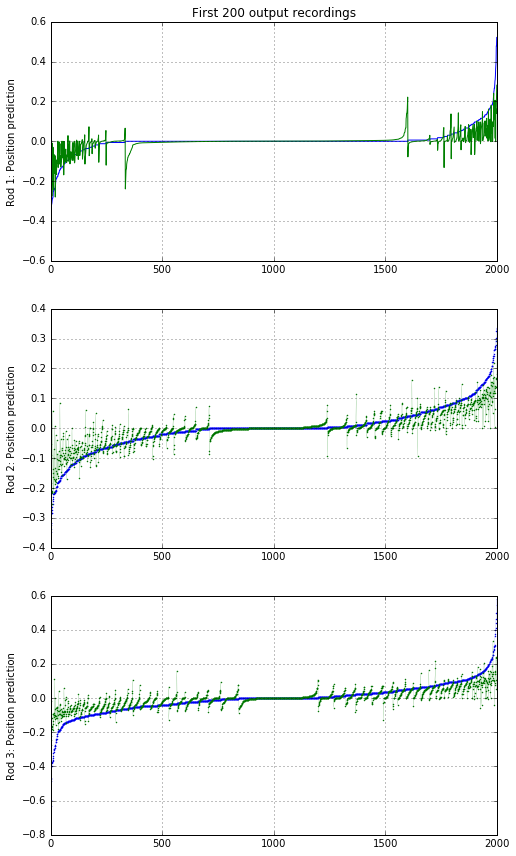

Epoch 5/5
4013/4013 [==============================] - 721s - loss: 0.0029 - mse: 2.8835e-06 - val_loss: 0.0026 - val_mse: 2.6364e-06
Wrote model to dpos_cnn_weights_4.hdf
Epoch 6/6
4013/4013 [==============================] - 721s - loss: 0.0030 - mse: 2.9673e-06 - val_loss: 0.0026 - val_mse: 2.5937e-06
Wrote model to dpos_cnn_weights_5.hdf
Epoch 7/7
4013/4013 [==============================] - 721s - loss: 0.0030 - mse: 2.9864e-06 - val_loss: 0.0026 - val_mse: 2.5663e-06
Wrote model to dpos_cnn_weights_6.hdf
Predicted.
array([[ 0.        ,  0.0855615 , -0.00687285],
       [ 0.        , -0.05347594, -0.0137457 ],
       [ 0.        , -0.06951872, -0.05498282],
       ..., 
       [ 0.        ,  0.02139037,  0.0137457 ],
       [ 0.        ,  0.        , -0.00687285],
       [ 0.        ,  0.        ,  0.02749141]], dtype=float32)
array([[ 0.00574936,  0.06236861,  0.015195  ],
       [-0.00583911, -0.0332    , -0.00184845],
       [-0.00059125, -0.06163831, -0.04540858],
       ..., 

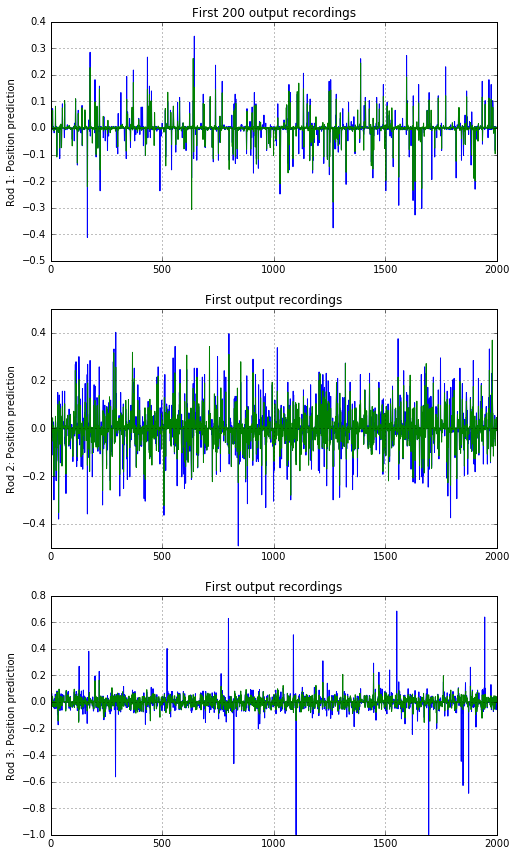

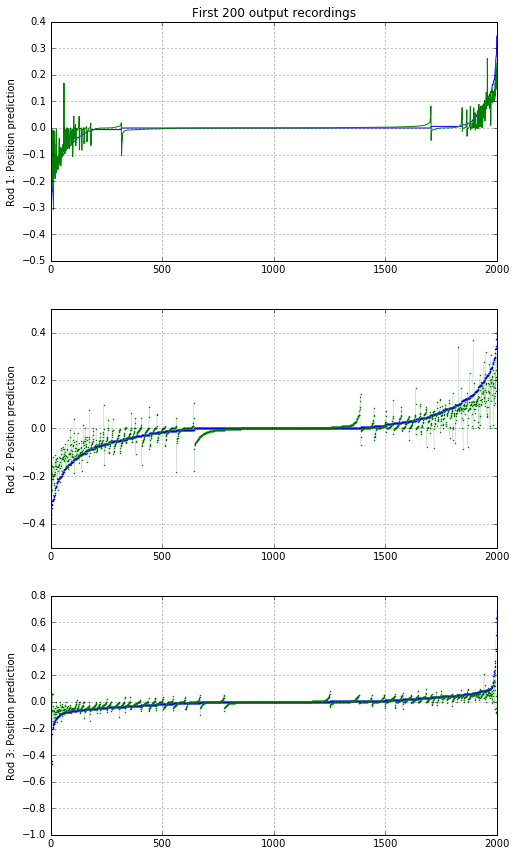

Epoch 8/8
4013/4013 [==============================] - 789s - loss: 0.0028 - mse: 2.8058e-06 - val_loss: 0.0023 - val_mse: 2.3436e-06
Wrote model to dpos_cnn_weights_7.hdf
Epoch 9/9
4013/4013 [==============================] - 1462s - loss: 0.0030 - mse: 2.9510e-06 - val_loss: 0.0026 - val_mse: 2.5745e-06
Wrote model to dpos_cnn_weights_8.hdf
Epoch 10/10
4013/4013 [==============================] - 725s - loss: 0.0029 - mse: 2.8542e-06 - val_loss: 0.0020 - val_mse: 2.0473e-06
Wrote model to dpos_cnn_weights_9.hdf
Predicted.
array([[ 0.        ,  0.0855615 , -0.00687285],
       [ 0.        , -0.05347594, -0.0137457 ],
       [ 0.        , -0.06951872, -0.05498282],
       ..., 
       [ 0.        ,  0.02139037,  0.0137457 ],
       [ 0.        ,  0.        , -0.00687285],
       [ 0.        ,  0.        , -0.02749141]], dtype=float32)
array([[ 0.00130503,  0.05087789, -0.00146897],
       [ 0.00306409, -0.05929659, -0.02049329],
       [-0.00913119, -0.05484598, -0.06207027],
       ..

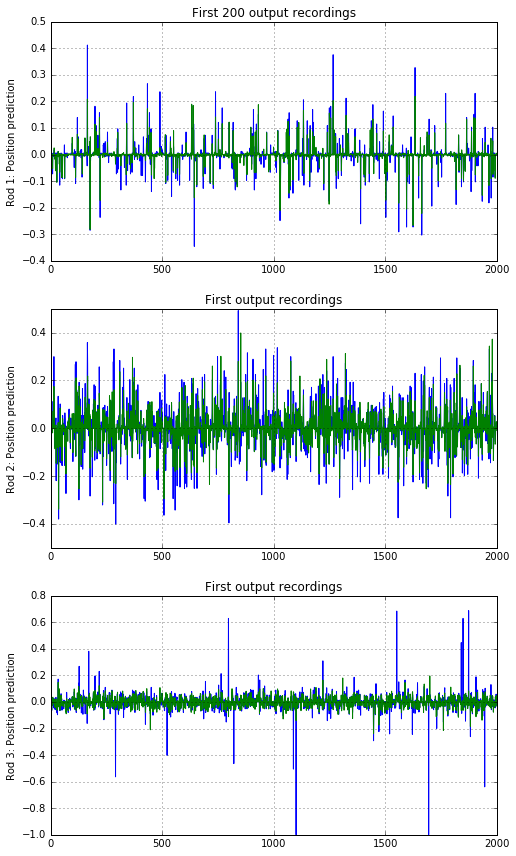

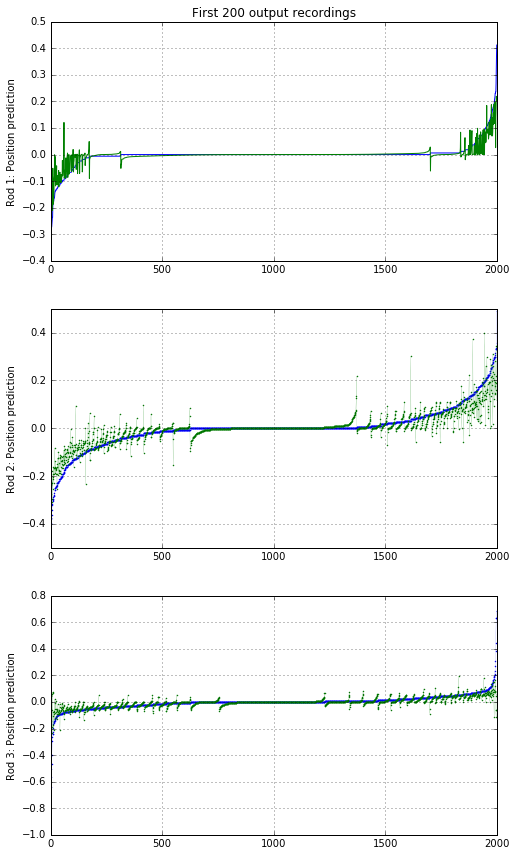

Epoch 11/11
4013/4013 [==============================] - 721s - loss: 0.0029 - mse: 2.9140e-06 - val_loss: 0.0026 - val_mse: 2.5595e-06
Wrote model to dpos_cnn_weights_10.hdf
Epoch 12/12
4013/4013 [==============================] - 722s - loss: 0.0029 - mse: 2.8791e-06 - val_loss: 0.0026 - val_mse: 2.5681e-06
Wrote model to dpos_cnn_weights_11.hdf
Epoch 13/13
4013/4013 [==============================] - 721s - loss: 0.0029 - mse: 2.9251e-06 - val_loss: 0.0026 - val_mse: 2.5736e-06
Wrote model to dpos_cnn_weights_12.hdf
Predicted.
array([[ 0.        ,  0.02868852,  0.05405406],
       [ 0.        ,  0.03688525,  0.02162162],
       [ 0.02424242,  0.05737705,  0.        ],
       ..., 
       [ 0.        ,  0.06967213,  0.05405406],
       [ 0.        ,  0.00409836,  0.01081081],
       [ 0.        , -0.00409836, -0.00540541]], dtype=float32)
array([[  5.90424868e-04,   1.56965759e-02,   5.57356067e-02],
       [  7.39128329e-03,   7.15134591e-02,   4.97303046e-02],
       [  3.11152008e

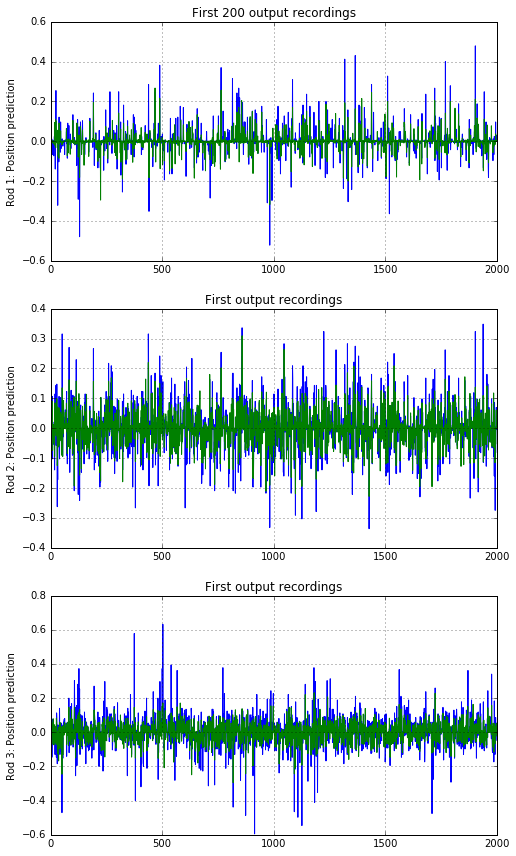

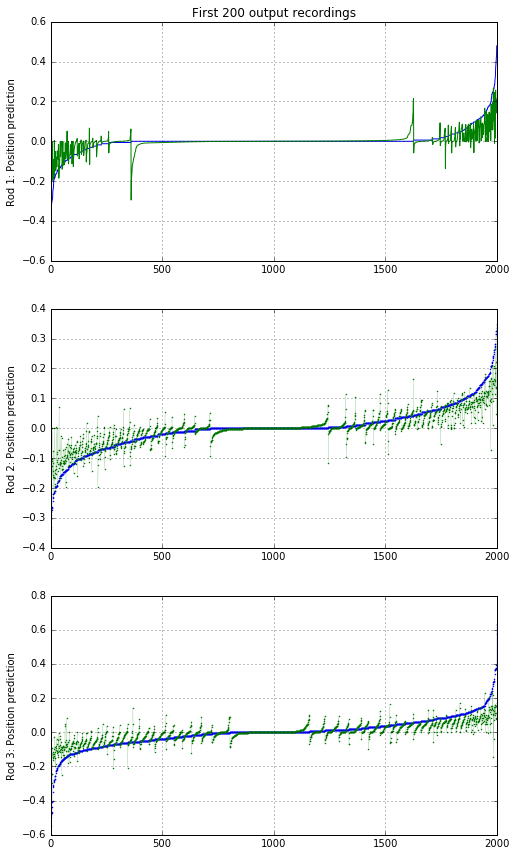

Epoch 14/14
4013/4013 [==============================] - 721s - loss: 0.0028 - mse: 2.8361e-06 - val_loss: 0.0026 - val_mse: 2.6387e-06
Wrote model to dpos_cnn_weights_13.hdf
Epoch 15/15
4013/4013 [==============================] - 721s - loss: 0.0029 - mse: 2.9070e-06 - val_loss: 0.0026 - val_mse: 2.6208e-06
Wrote model to dpos_cnn_weights_14.hdf
Epoch 16/16
4013/4013 [==============================] - 721s - loss: 0.0029 - mse: 2.8550e-06 - val_loss: 0.0026 - val_mse: 2.5795e-06
Wrote model to dpos_cnn_weights_15.hdf
Predicted.
array([[ 0.        ,  0.0855615 , -0.00687285],
       [ 0.        ,  0.05347594,  0.0137457 ],
       [ 0.        , -0.06951872, -0.05498282],
       ..., 
       [ 0.        , -0.02139037, -0.0137457 ],
       [ 0.        ,  0.        ,  0.00687285],
       [ 0.        ,  0.        , -0.02749141]], dtype=float32)
array([[ 0.00300511,  0.05647865,  0.00648243],
       [ 0.00188433,  0.05382955,  0.00866292],
       [-0.00184963, -0.05853857, -0.04913313],
   

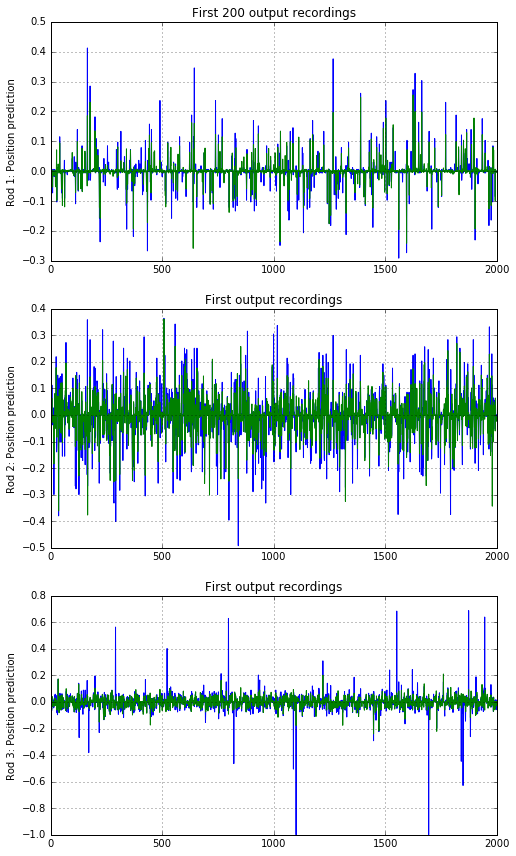

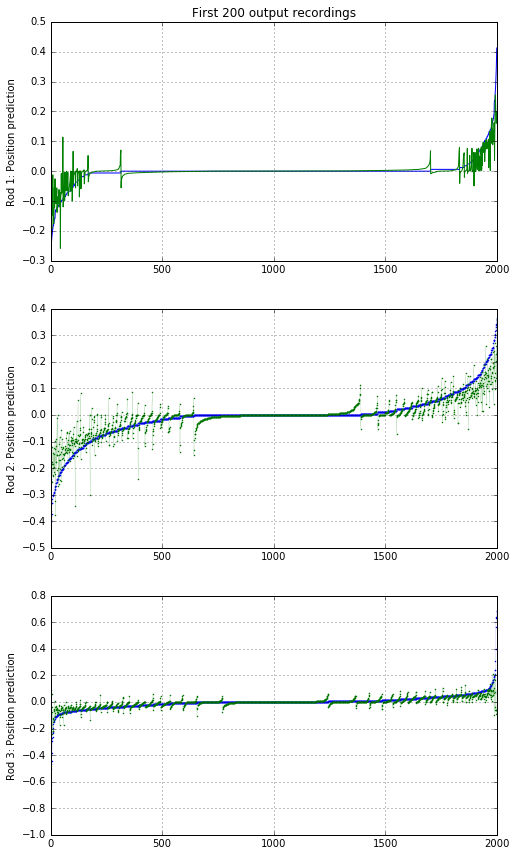

Epoch 17/17
3236/4013 [=======================>......] - ETA: 127s - loss: 0.0029 - mse: 2.8986e-06
User stopped the training.


In [14]:
# Load the best position prediction model as the starting point
epoch = 14
WEIGHTS_FNAME = 'dpos_cnn_weights_%i.hdf'
model.load_weights(WEIGHTS_FNAME % epoch)
print("Loaded model.")


# Plot the real versus predicted values for some of the validation data
plot_validate(ValidateBatchGenDpos(batch_size, model, training), model, 2000, "Difference in position")

model.compile(optimizer=keras.optimizers.RMSprop(lr=0.00001),
              loss='mean_squared_error',
              metrics=[mse])
        
for epoch in range(300):
    try:
        model.fit_generator(TrainBatchGenDpos(batch_size, model, training), batches_training_per_epoch, epochs=epoch+1, verbose=1, callbacks=None, class_weight=None, max_q_size=10, workers=10, validation_data=ValidateBatchGenDpos(batch_size, model, training), validation_steps = batches_validation_per_epoch, pickle_safe=False, initial_epoch=epoch)
        model.save_weights(WEIGHTS_FNAME % epoch)
        model.save(MODELS_FNAME % epoch)
        print(("Wrote model to " + WEIGHTS_FNAME )  % epoch)
        
        if epoch % 3 == 0:
            plot_validate(ValidateBatchGenDpos(batch_size, model, training), model, 2000, "Position prediction")
    except KeyboardInterrupt:
        print("\r\nUser stopped the training.")
        break

Predicted.
array([[ 0.        , -0.07792208, -0.06050956],
       [ 0.        ,  0.        ,  0.        ],
       [ 0.34545454,  0.        , -0.04458599],
       ..., 
       [-0.07272727,  0.        , -0.00955414],
       [ 0.        ,  0.        ,  0.        ],
       [ 0.09696969, -0.06926407,  0.00636943]], dtype=float32)
array([[-0.0053846 , -0.06123699, -0.03613362],
       [ 0.0003117 , -0.00038067,  0.00087305],
       [ 0.1455543 ,  0.06974202, -0.01502369],
       ..., 
       [-0.00088589, -0.00692523, -0.02254099],
       [ 0.00032977, -0.00059682,  0.00068905],
       [ 0.00026388, -0.00172802,  0.0010019 ]], dtype=float32)


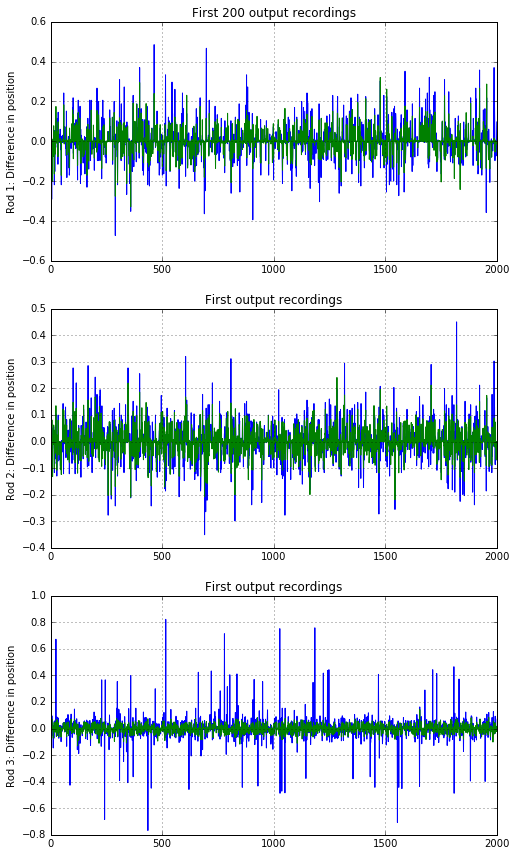

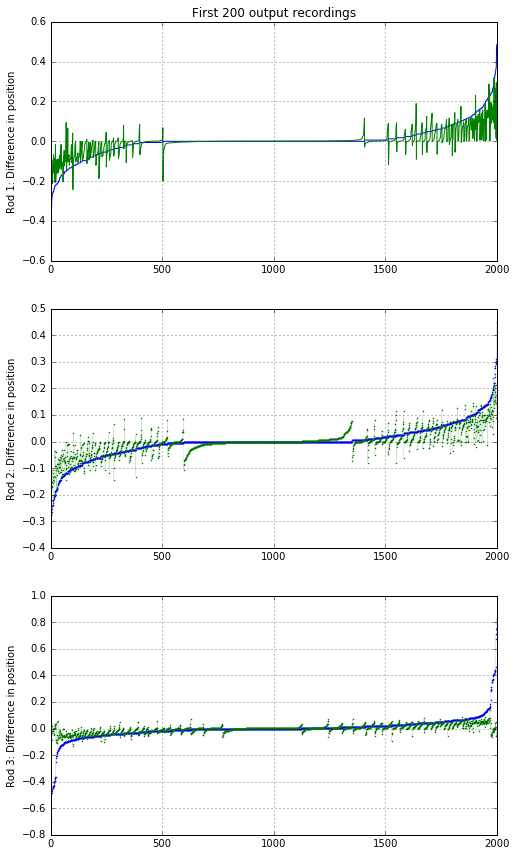

In [15]:



# Plot the real versus predicted values for some of the validation data
plot_validate(ValidateBatchGenDpos(batch_size, model, training), model, 2000, "Difference in position")

Epoch 17/17
4013/4013 [==============================] - 724s - loss: 0.0028 - mse: 2.8225e-06 - val_loss: 0.0026 - val_mse: 2.5905e-06
Wrote model to dpos_cnn_weights_16.hdf
Epoch 18/18
4013/4013 [==============================] - 723s - loss: 0.0028 - mse: 2.8443e-06 - val_loss: 0.0026 - val_mse: 2.5783e-06
Wrote model to dpos_cnn_weights_17.hdf
Epoch 19/19
4013/4013 [==============================] - 797s - loss: 0.0029 - mse: 2.9103e-06 - val_loss: 0.0026 - val_mse: 2.5764e-06
Wrote model to dpos_cnn_weights_18.hdf
Predicted.
array([[ 0.        ,  0.07792208,  0.06050956],
       [ 0.        ,  0.        ,  0.        ],
       [ 0.34545454,  0.        , -0.04458599],
       ..., 
       [ 0.07272727,  0.        ,  0.00955414],
       [ 0.        ,  0.        ,  0.        ],
       [-0.09696969,  0.06926407, -0.00636943]], dtype=float32)
array([[  8.13354552e-03,   5.12343161e-02,   4.65705320e-02],
       [  2.29397032e-04,  -2.13355292e-04,   1.09376293e-03],
       [  1.47603810e

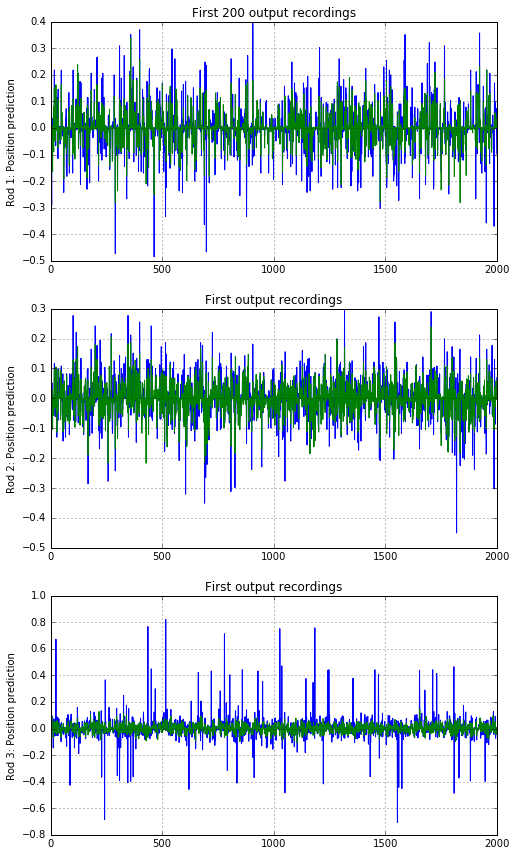

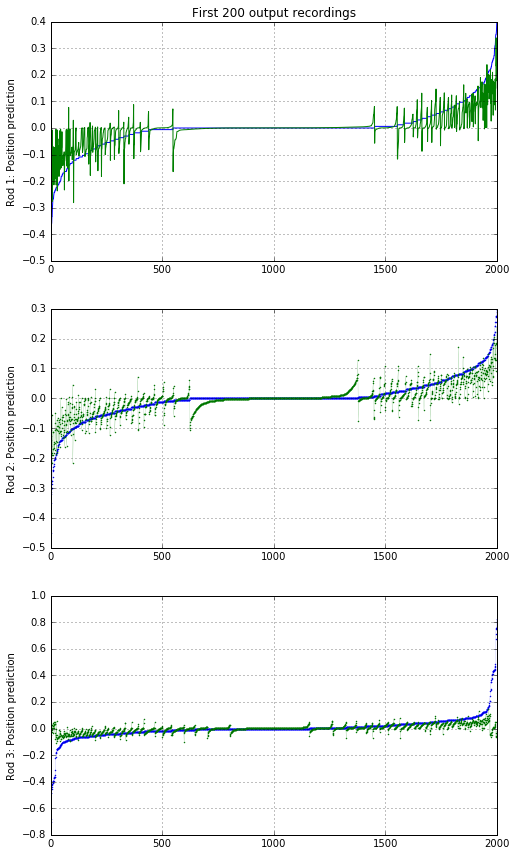

Epoch 20/20
2397/4013 [================>.............] - ETA: 477s - loss: 0.0029 - mse: 2.8721e-06
User stopped the training.


In [16]:

model.compile(optimizer=keras.optimizers.RMSprop(lr=0.000001),
              loss='mean_squared_error',
              metrics=[mse])
        
for epoch in range(epoch,300):
    try:
        model.fit_generator(TrainBatchGenDpos(batch_size, model, training), batches_training_per_epoch, epochs=epoch+1, verbose=1, callbacks=None, class_weight=None, max_q_size=10, workers=10, validation_data=ValidateBatchGenDpos(batch_size, model, training), validation_steps = batches_validation_per_epoch, pickle_safe=False, initial_epoch=epoch)
        model.save_weights(WEIGHTS_FNAME % epoch)
        model.save(MODELS_FNAME % epoch)
        print(("Wrote model to " + WEIGHTS_FNAME )  % epoch)
        
        if epoch % 6 == 0:
            plot_validate(ValidateBatchGenDpos(batch_size, model, training), model, 2000, "Position prediction")
    except KeyboardInterrupt:
        print("\r\nUser stopped the training.")
        break

In [17]:

model.compile(optimizer=keras.optimizers.RMSprop(lr=0.000005),
              loss='mean_squared_error',
              metrics=[mse])
        
for epoch in range(epoch,300):
    try:
        model.fit_generator(TrainBatchGenDpos(batch_size, model, training), batches_training_per_epoch, epochs=epoch+1, verbose=1, callbacks=None, class_weight=None, max_q_size=10, workers=10, validation_data=ValidateBatchGenDpos(batch_size, model, training), validation_steps = batches_validation_per_epoch, pickle_safe=False, initial_epoch=epoch)
        model.save_weights(WEIGHTS_FNAME % epoch)
        model.save(MODELS_FNAME % epoch)
        print(("Wrote model to " + WEIGHTS_FNAME )  % epoch)
        
        if epoch % 6 == 0:
            plot_validate(ValidateBatchGenDpos(batch_size, model, training), model, 2000, "Position prediction")
    except KeyboardInterrupt:
        print("\r\nUser stopped the training.")
        break

Epoch 20/20
4013/4013 [==============================] - 727s - loss: 0.0029 - mse: 2.8612e-06 - val_loss: 0.0030 - val_mse: 2.9555e-06
Wrote model to dpos_cnn_weights_19.hdf
Epoch 21/21
4013/4013 [==============================] - 724s - loss: 0.0030 - mse: 2.9600e-06 - val_loss: 0.0026 - val_mse: 2.5864e-06
Wrote model to dpos_cnn_weights_20.hdf
Epoch 22/22
 647/4013 [===>..........................] - ETA: 524s - loss: 0.0030 - mse: 2.9571e-06
User stopped the training.


In [ ]:
batch_size = 40
batches_training_per_epoch = int(training.get_training_count() / batch_size)
batches_validation_per_epoch = int(training.get_validation_count() / batch_size)
print("%i training batches, %i validation batches" % (batches_training_per_epoch, batches_validation_per_epoch) )



model.compile(optimizer=keras.optimizers.RMSprop(lr=0.00005),
              loss='mean_squared_error',
              metrics=[mse])
        
for epoch in range(epoch,300):
    try:
        model.fit_generator(TrainBatchGenDpos(batch_size, model, training), batches_training_per_epoch, epochs=epoch+1, verbose=1, callbacks=None, class_weight=None, max_q_size=10, workers=10, validation_data=ValidateBatchGenDpos(batch_size, model, training), validation_steps = batches_validation_per_epoch, pickle_safe=False, initial_epoch=epoch)
        model.save_weights(WEIGHTS_FNAME % epoch)
        model.save(MODELS_FNAME % epoch)
        print(("Wrote model to " + WEIGHTS_FNAME )  % epoch)
        
        if epoch % 6 == 0:
            plot_validate(ValidateBatchGenDpos(batch_size, model, training), model, 2000, "Position prediction")
    except KeyboardInterrupt:
        print("\r\nUser stopped the training.")
        break

1003 training batches, 250 validation batches
Epoch 22/22
1003/1003 [==============================] - 2103s - loss: 0.0029 - mse: 2.8819e-06 - val_loss: 0.0026 - val_mse: 2.6171e-06
Wrote model to dpos_cnn_weights_21.hdf
Epoch 23/23
1003/1003 [==============================] - 2069s - loss: 0.0028 - mse: 2.8104e-06 - val_loss: 0.0027 - val_mse: 2.7311e-06
Wrote model to dpos_cnn_weights_22.hdf
Epoch 24/24
 145/1003 [===>..........................] - ETA: 1493s - loss: 0.0029 - mse: 2.8834e-06

Loaded model.
1003 training batches, 250 validation batches
Epoch 23/23
1003/1003 [==============================] - 686s - loss: 0.0030 - mse: 2.9970e-06 - val_loss: 0.0025 - val_mse: 2.5248e-06
Wrote model to dpos_cnn_weights_22.hdf
Epoch 24/24
1003/1003 [==============================] - 680s - loss: 0.0029 - mse: 2.9023e-06 - val_loss: 0.0026 - val_mse: 2.5573e-06
Wrote model to dpos_cnn_weights_23.hdf
Epoch 25/25
1003/1003 [==============================] - 682s - loss: 0.0029 - mse: 2.8635e-06 - val_loss: 0.0026 - val_mse: 2.6238e-06
Wrote model to dpos_cnn_weights_24.hdf
Predicted.
array([[-0.03636364, -0.02459016,  0.07567567],
       [ 0.12121212,  0.05737705, -0.01621622],
       [ 0.        ,  0.21721311,  0.1027027 ],
       ..., 
       [ 0.        ,  0.13114753, -0.02702703],
       [ 0.        ,  0.        ,  0.        ],
       [ 0.        ,  0.        ,  0.11351351]], dtype=float32)
array([[-0.00411136,  0.00607211,  0.10282493],
       [-0.00175311, -0.00236443,  0.00

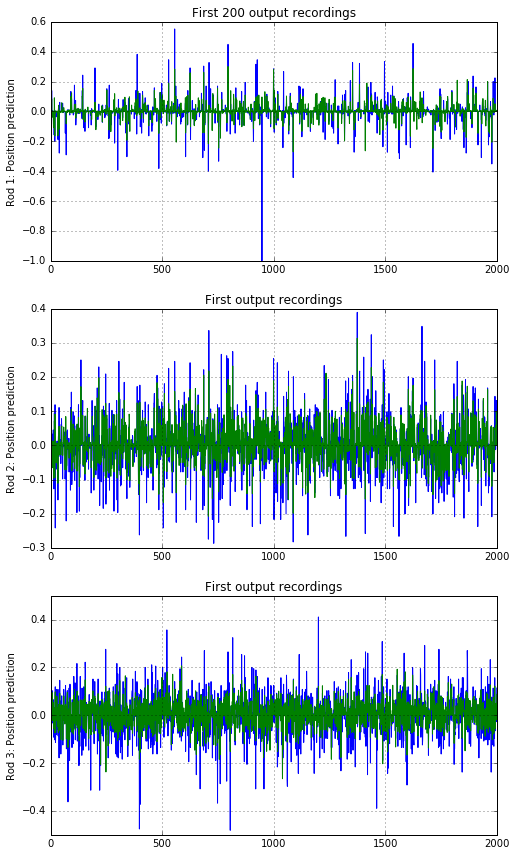

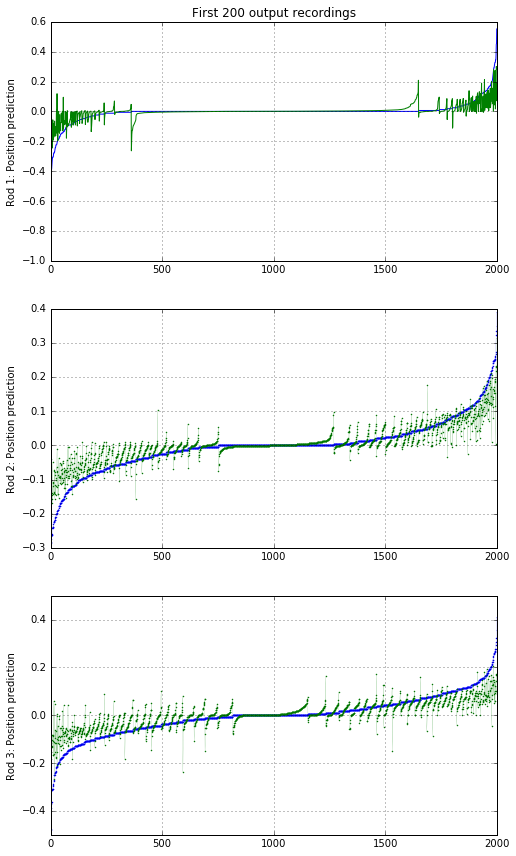

Epoch 26/26
1003/1003 [==============================] - 685s - loss: 0.0029 - mse: 2.8742e-06 - val_loss: 0.0028 - val_mse: 2.7631e-06
Wrote model to dpos_cnn_weights_25.hdf
Epoch 27/27
1003/1003 [==============================] - 682s - loss: 0.0029 - mse: 2.8704e-06 - val_loss: 0.0025 - val_mse: 2.4849e-06
Wrote model to dpos_cnn_weights_26.hdf
Epoch 28/28
1003/1003 [==============================] - 699s - loss: 0.0029 - mse: 2.8640e-06 - val_loss: 0.0027 - val_mse: 2.6853e-06
Wrote model to dpos_cnn_weights_27.hdf
Epoch 29/29
1003/1003 [==============================] - 679s - loss: 0.0029 - mse: 2.9405e-06 - val_loss: 0.0025 - val_mse: 2.5165e-06
Wrote model to dpos_cnn_weights_28.hdf
Epoch 30/30
1003/1003 [==============================] - 678s - loss: 0.0029 - mse: 2.8848e-06 - val_loss: 0.0025 - val_mse: 2.4570e-06
Wrote model to dpos_cnn_weights_29.hdf
Epoch 31/31
1003/1003 [==============================] - 678s - loss: 0.0028 - mse: 2.8207e-06 - val_loss: 0.0028 - val_mse: 

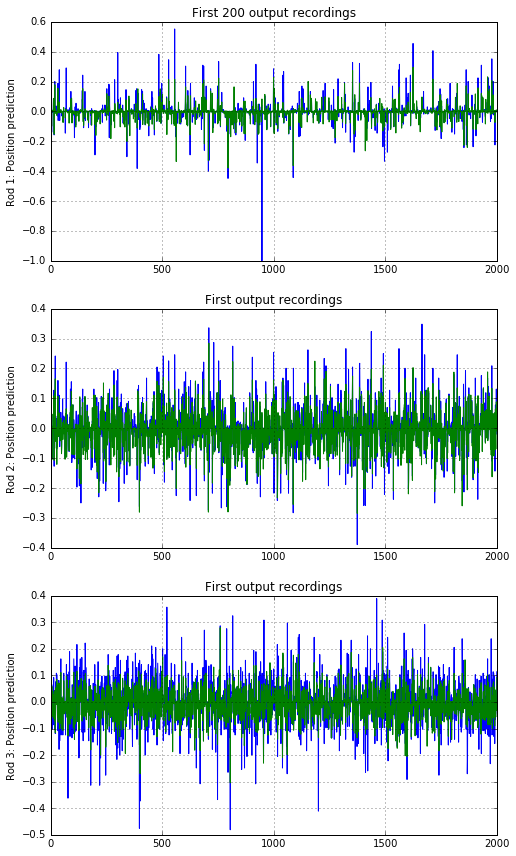

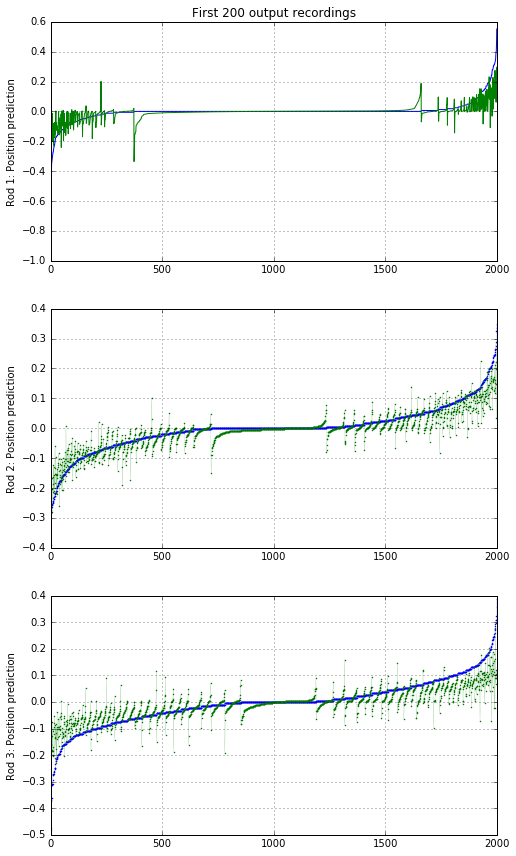

Epoch 32/32
1003/1003 [==============================] - 678s - loss: 0.0029 - mse: 2.9168e-06 - val_loss: 0.0026 - val_mse: 2.6140e-06
Wrote model to dpos_cnn_weights_31.hdf
Epoch 33/33
1003/1003 [==============================] - 678s - loss: 0.0029 - mse: 2.8519e-06 - val_loss: 0.0028 - val_mse: 2.7501e-06
Wrote model to dpos_cnn_weights_32.hdf
Epoch 34/34
1003/1003 [==============================] - 678s - loss: 0.0029 - mse: 2.8557e-06 - val_loss: 0.0021 - val_mse: 2.1175e-06
Wrote model to dpos_cnn_weights_33.hdf
Epoch 35/35
1003/1003 [==============================] - 678s - loss: 0.0029 - mse: 2.8698e-06 - val_loss: 0.0025 - val_mse: 2.5268e-06
Wrote model to dpos_cnn_weights_34.hdf
Epoch 36/36
1003/1003 [==============================] - 678s - loss: 0.0028 - mse: 2.7701e-06 - val_loss: 0.0033 - val_mse: 3.2729e-06
Wrote model to dpos_cnn_weights_35.hdf
Epoch 37/37
1003/1003 [==============================] - 678s - loss: 0.0028 - mse: 2.8419e-06 - val_loss: 0.0025 - val_mse: 

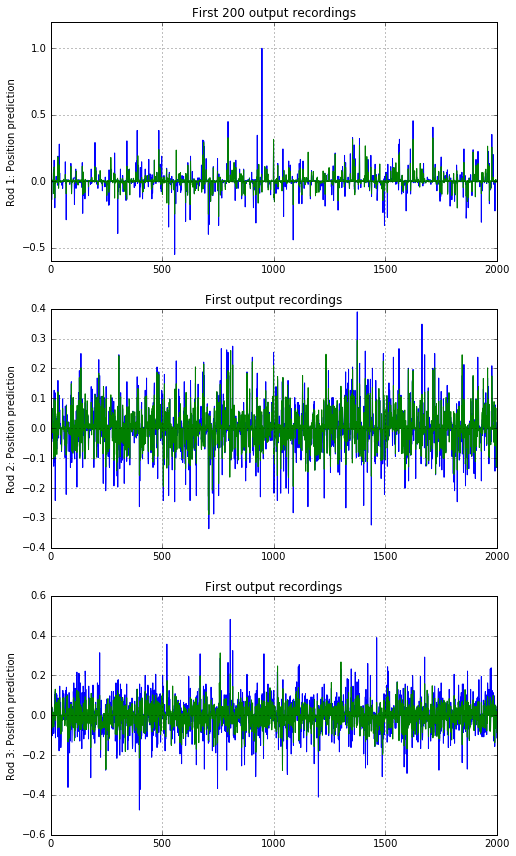

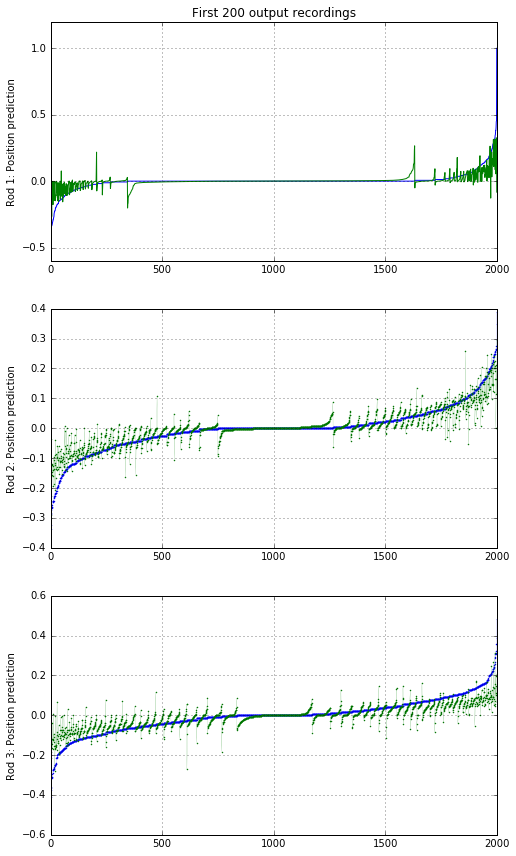

Epoch 38/38
1003/1003 [==============================] - 678s - loss: 0.0029 - mse: 2.8661e-06 - val_loss: 0.0026 - val_mse: 2.6440e-06
Wrote model to dpos_cnn_weights_37.hdf
Epoch 39/39
1003/1003 [==============================] - 678s - loss: 0.0028 - mse: 2.8260e-06 - val_loss: 0.0022 - val_mse: 2.2238e-06
Wrote model to dpos_cnn_weights_38.hdf
Epoch 40/40
1003/1003 [==============================] - 678s - loss: 0.0028 - mse: 2.8159e-06 - val_loss: 0.0026 - val_mse: 2.5685e-06
Wrote model to dpos_cnn_weights_39.hdf
Epoch 41/41
1003/1003 [==============================] - 677s - loss: 0.0029 - mse: 2.8682e-06 - val_loss: 0.0025 - val_mse: 2.4670e-06
Wrote model to dpos_cnn_weights_40.hdf
Epoch 42/42
1003/1003 [==============================] - 678s - loss: 0.0029 - mse: 2.8685e-06 - val_loss: 0.0021 - val_mse: 2.1075e-06
Wrote model to dpos_cnn_weights_41.hdf
Epoch 43/43
1003/1003 [==============================] - 678s - loss: 0.0028 - mse: 2.7918e-06 - val_loss: 0.0027 - val_mse: 

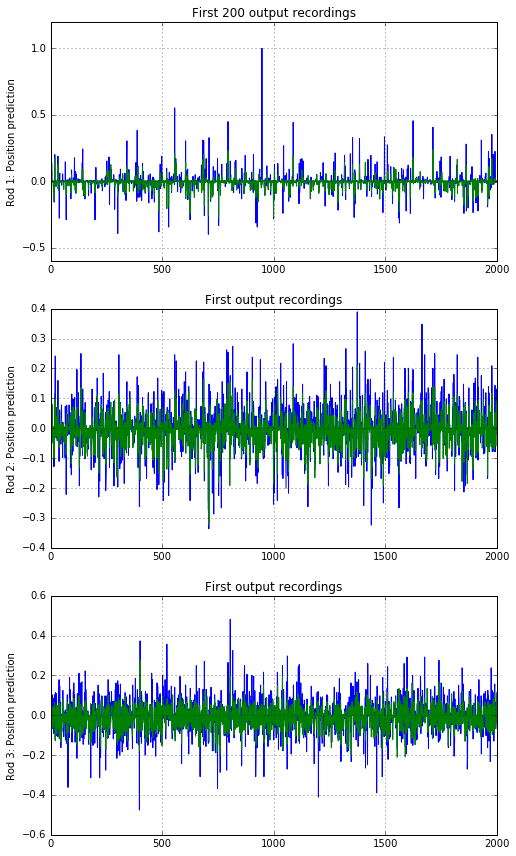

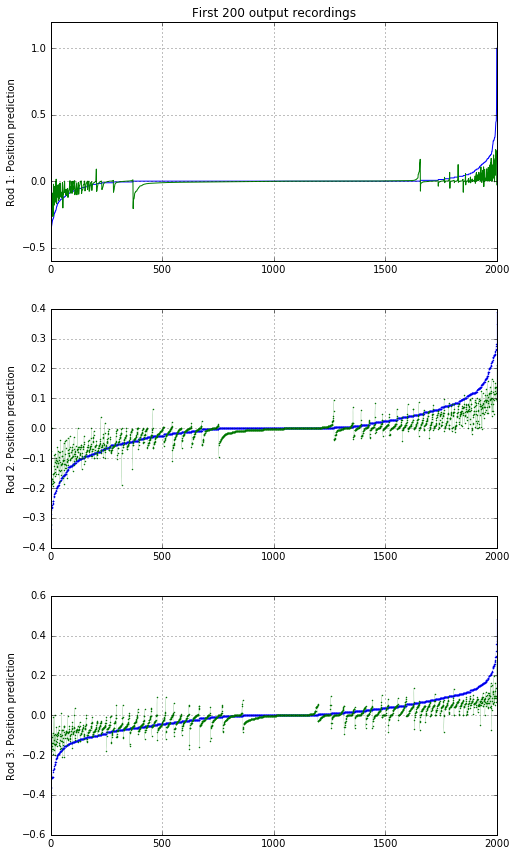

Epoch 44/44
1003/1003 [==============================] - 678s - loss: 0.0028 - mse: 2.7907e-06 - val_loss: 0.0022 - val_mse: 2.1706e-06
Wrote model to dpos_cnn_weights_43.hdf
Epoch 45/45
1003/1003 [==============================] - 678s - loss: 0.0028 - mse: 2.8440e-06 - val_loss: 0.0026 - val_mse: 2.5795e-06
Wrote model to dpos_cnn_weights_44.hdf
Epoch 46/46
1003/1003 [==============================] - 678s - loss: 0.0027 - mse: 2.7475e-06 - val_loss: 0.0026 - val_mse: 2.5546e-06
Wrote model to dpos_cnn_weights_45.hdf
Epoch 47/47
1003/1003 [==============================] - 678s - loss: 0.0028 - mse: 2.8143e-06 - val_loss: 0.0029 - val_mse: 2.8981e-06
Wrote model to dpos_cnn_weights_46.hdf
Epoch 48/48
1003/1003 [==============================] - 678s - loss: 0.0029 - mse: 2.8684e-06 - val_loss: 0.0021 - val_mse: 2.1250e-06
Wrote model to dpos_cnn_weights_47.hdf
Epoch 49/49
1003/1003 [==============================] - 678s - loss: 0.0028 - mse: 2.8383e-06 - val_loss: 0.0027 - val_mse: 

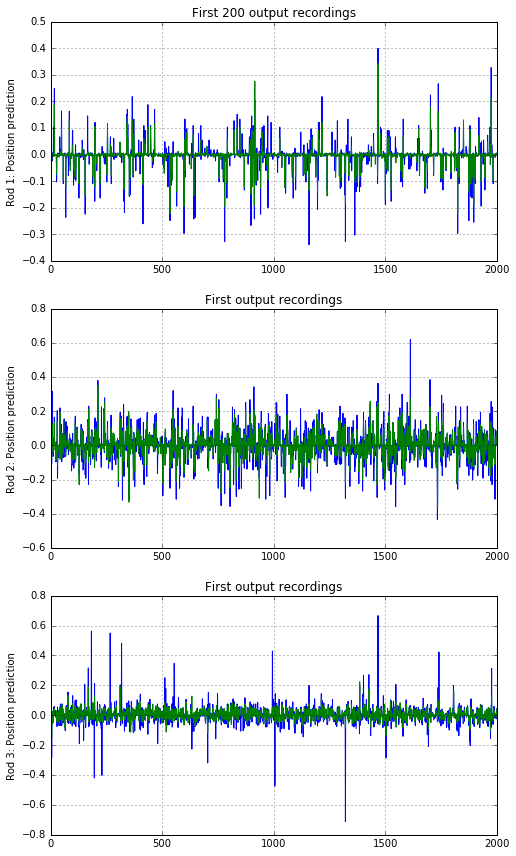

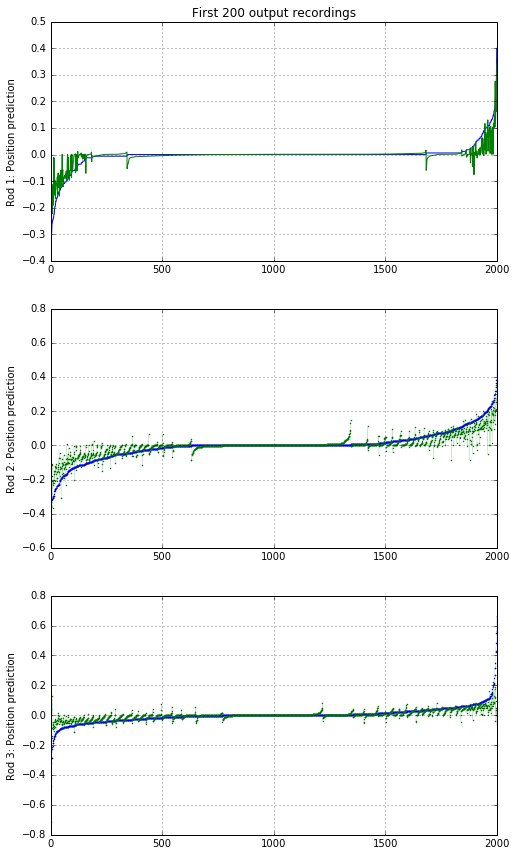

Epoch 50/50
1003/1003 [==============================] - 678s - loss: 0.0028 - mse: 2.7938e-06 - val_loss: 0.0021 - val_mse: 2.0906e-06
Wrote model to dpos_cnn_weights_49.hdf
Epoch 51/51
1003/1003 [==============================] - 678s - loss: 0.0029 - mse: 2.8935e-06 - val_loss: 0.0021 - val_mse: 2.0829e-06
Wrote model to dpos_cnn_weights_50.hdf
Epoch 52/52
1003/1003 [==============================] - 678s - loss: 0.0029 - mse: 2.8812e-06 - val_loss: 0.0018 - val_mse: 1.8300e-06
Wrote model to dpos_cnn_weights_51.hdf
Epoch 53/53
1003/1003 [==============================] - 678s - loss: 0.0028 - mse: 2.8122e-06 - val_loss: 0.0025 - val_mse: 2.5253e-06
Wrote model to dpos_cnn_weights_52.hdf
Epoch 54/54
1003/1003 [==============================] - 678s - loss: 0.0029 - mse: 2.8506e-06 - val_loss: 0.0022 - val_mse: 2.1796e-06
Wrote model to dpos_cnn_weights_53.hdf
Epoch 55/55
1003/1003 [==============================] - 678s - loss: 0.0028 - mse: 2.7632e-06 - val_loss: 0.0023 - val_mse: 

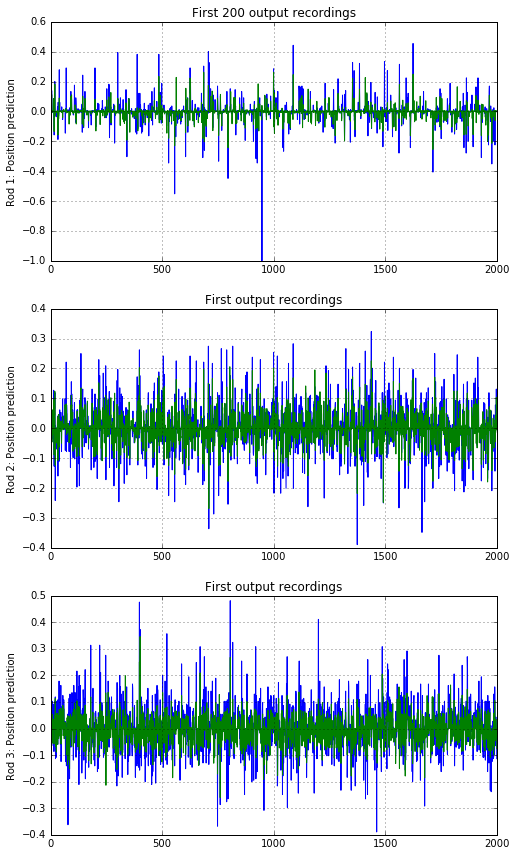

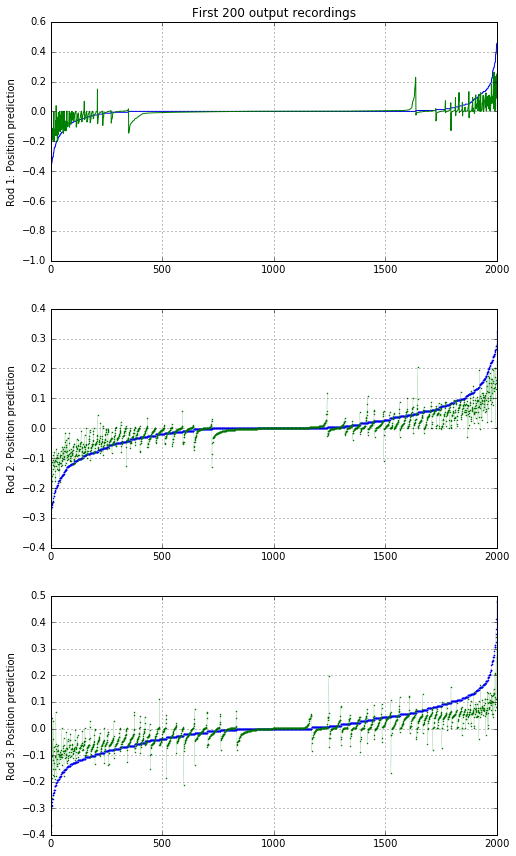

Epoch 56/56
1003/1003 [==============================] - 678s - loss: 0.0028 - mse: 2.8034e-06 - val_loss: 0.0020 - val_mse: 1.9679e-06
Wrote model to dpos_cnn_weights_55.hdf
Epoch 57/57
1003/1003 [==============================] - 678s - loss: 0.0028 - mse: 2.7792e-06 - val_loss: 0.0021 - val_mse: 2.1231e-06
Wrote model to dpos_cnn_weights_56.hdf
Epoch 58/58
1003/1003 [==============================] - 678s - loss: 0.0028 - mse: 2.8156e-06 - val_loss: 0.0026 - val_mse: 2.5748e-06
Wrote model to dpos_cnn_weights_57.hdf
Epoch 59/59
1003/1003 [==============================] - 678s - loss: 0.0028 - mse: 2.7560e-06 - val_loss: 0.0026 - val_mse: 2.5902e-06
Wrote model to dpos_cnn_weights_58.hdf
Epoch 60/60
1003/1003 [==============================] - 680s - loss: 0.0028 - mse: 2.8034e-06 - val_loss: 0.0025 - val_mse: 2.5433e-06
Wrote model to dpos_cnn_weights_59.hdf
Epoch 61/61
1003/1003 [==============================] - 678s - loss: 0.0029 - mse: 2.9029e-06 - val_loss: 0.0024 - val_mse: 

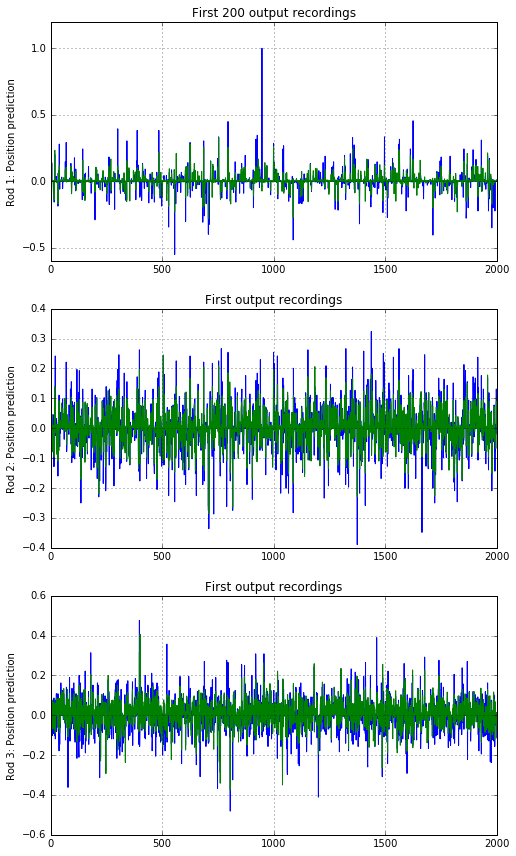

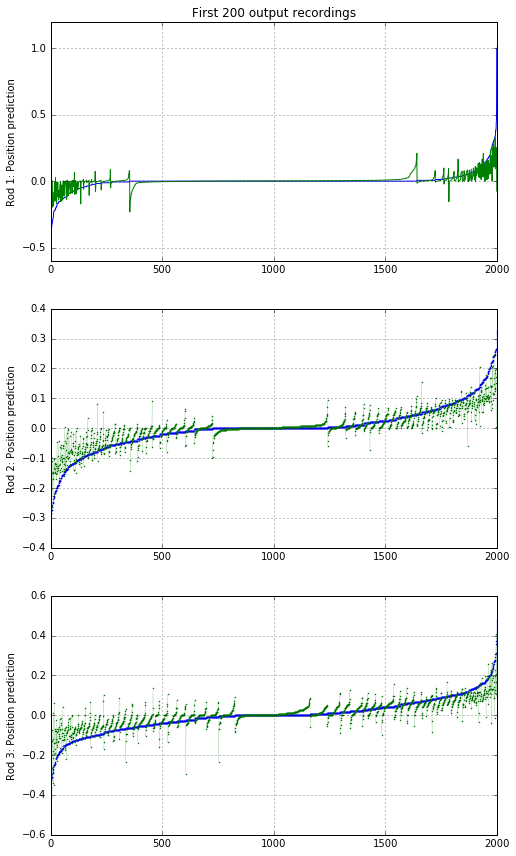

Epoch 62/62
1003/1003 [==============================] - 678s - loss: 0.0029 - mse: 2.8979e-06 - val_loss: 0.0026 - val_mse: 2.5719e-06
Wrote model to dpos_cnn_weights_61.hdf
Epoch 63/63
1003/1003 [==============================] - 678s - loss: 0.0028 - mse: 2.8293e-06 - val_loss: 0.0025 - val_mse: 2.5405e-06
Wrote model to dpos_cnn_weights_62.hdf
Epoch 64/64
1003/1003 [==============================] - 678s - loss: 0.0029 - mse: 2.8701e-06 - val_loss: 0.0021 - val_mse: 2.0878e-06
Wrote model to dpos_cnn_weights_63.hdf
Epoch 65/65
1003/1003 [==============================] - 678s - loss: 0.0027 - mse: 2.7381e-06 - val_loss: 0.0026 - val_mse: 2.5683e-06
Wrote model to dpos_cnn_weights_64.hdf
Epoch 66/66
1003/1003 [==============================] - 678s - loss: 0.0028 - mse: 2.7801e-06 - val_loss: 0.0029 - val_mse: 2.8831e-06
Wrote model to dpos_cnn_weights_65.hdf
Epoch 67/67
1003/1003 [==============================] - 678s - loss: 0.0028 - mse: 2.8166e-06 - val_loss: 0.0018 - val_mse: 

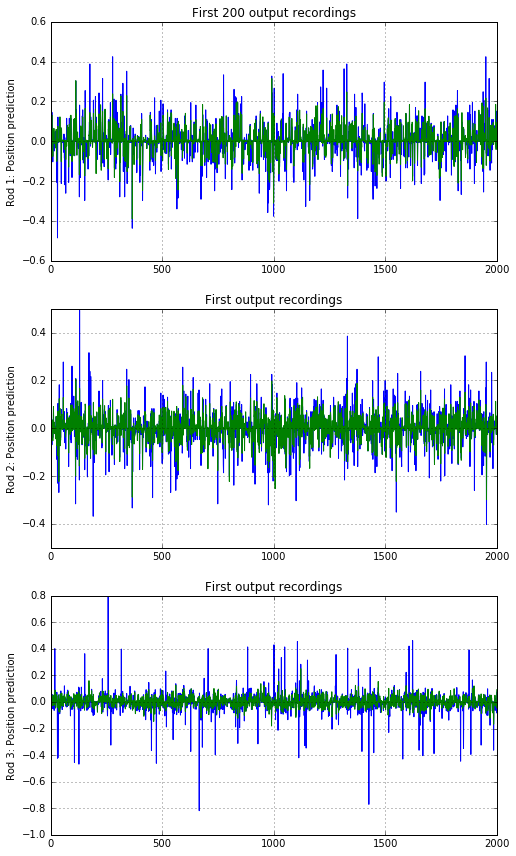

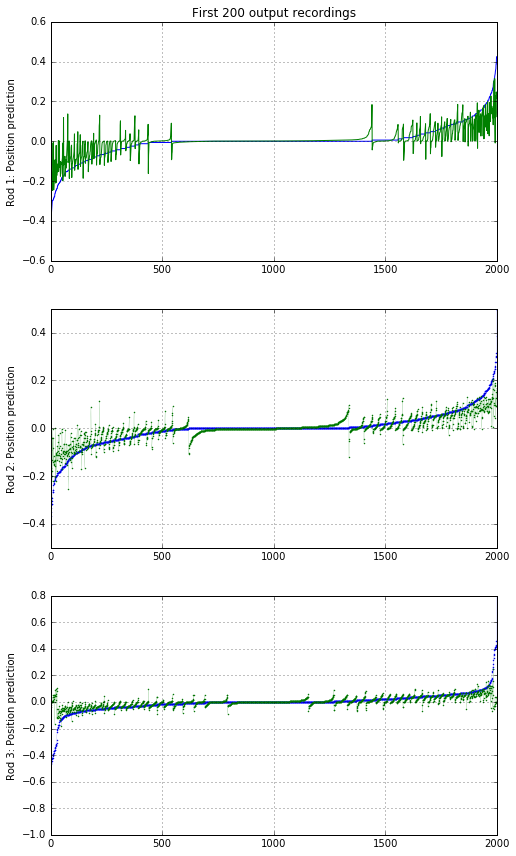

Epoch 68/68
1003/1003 [==============================] - 678s - loss: 0.0028 - mse: 2.8093e-06 - val_loss: 0.0029 - val_mse: 2.9066e-06
Wrote model to dpos_cnn_weights_67.hdf
Epoch 69/69
1003/1003 [==============================] - 678s - loss: 0.0028 - mse: 2.7970e-06 - val_loss: 0.0025 - val_mse: 2.5414e-06
Wrote model to dpos_cnn_weights_68.hdf
Epoch 70/70
1003/1003 [==============================] - 678s - loss: 0.0028 - mse: 2.8405e-06 - val_loss: 0.0024 - val_mse: 2.4079e-06
Wrote model to dpos_cnn_weights_69.hdf
Epoch 71/71
1003/1003 [==============================] - 678s - loss: 0.0028 - mse: 2.7900e-06 - val_loss: 0.0026 - val_mse: 2.5780e-06
Wrote model to dpos_cnn_weights_70.hdf
Epoch 72/72
1003/1003 [==============================] - 678s - loss: 0.0028 - mse: 2.7501e-06 - val_loss: 0.0030 - val_mse: 2.9585e-06
Wrote model to dpos_cnn_weights_71.hdf
Epoch 73/73
1003/1003 [==============================] - 678s - loss: 0.0028 - mse: 2.7607e-06 - val_loss: 0.0025 - val_mse: 

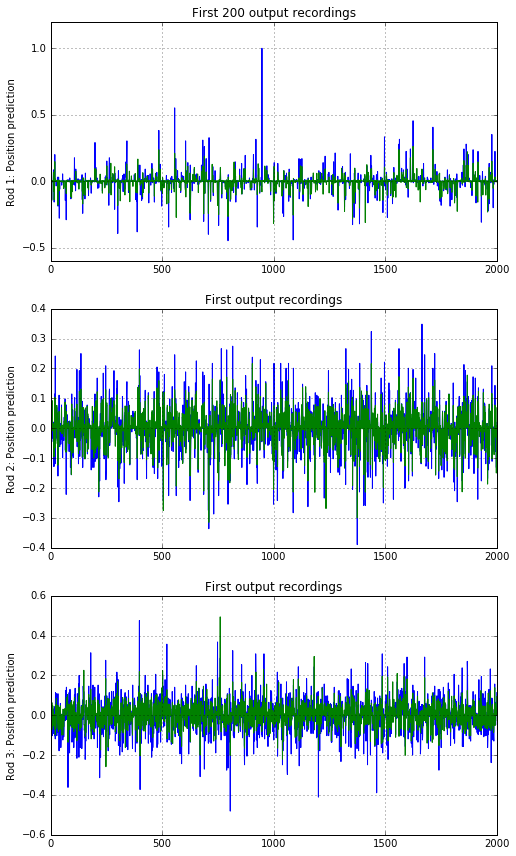

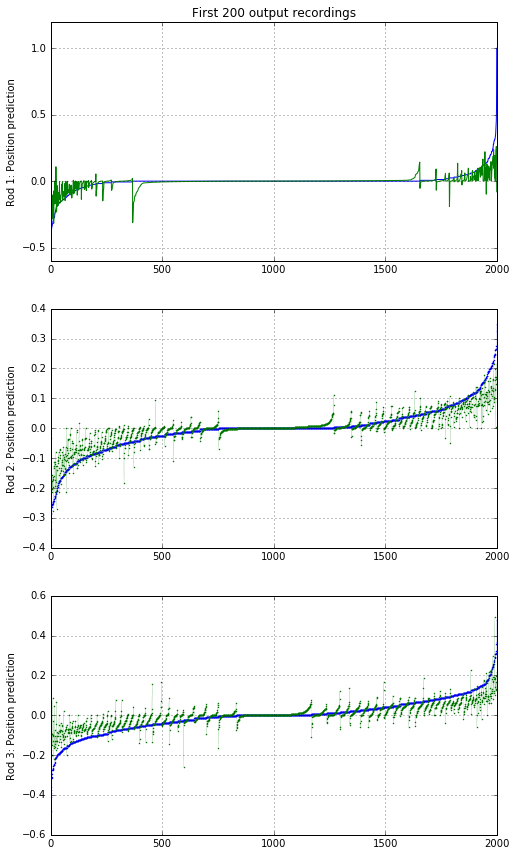

Epoch 74/74
1003/1003 [==============================] - 678s - loss: 0.0027 - mse: 2.7173e-06 - val_loss: 0.0025 - val_mse: 2.5287e-06
Wrote model to dpos_cnn_weights_73.hdf
Epoch 75/75
1003/1003 [==============================] - 679s - loss: 0.0028 - mse: 2.7627e-06 - val_loss: 0.0028 - val_mse: 2.8163e-06
Wrote model to dpos_cnn_weights_74.hdf
Epoch 76/76
1003/1003 [==============================] - 679s - loss: 0.0028 - mse: 2.8121e-06 - val_loss: 0.0025 - val_mse: 2.5140e-06
Wrote model to dpos_cnn_weights_75.hdf
Epoch 77/77
1003/1003 [==============================] - 679s - loss: 0.0028 - mse: 2.7802e-06 - val_loss: 0.0025 - val_mse: 2.5308e-06
Wrote model to dpos_cnn_weights_76.hdf
Epoch 78/78
1003/1003 [==============================] - 678s - loss: 0.0027 - mse: 2.7186e-06 - val_loss: 0.0022 - val_mse: 2.2162e-06
Wrote model to dpos_cnn_weights_77.hdf
Epoch 79/79
1003/1003 [==============================] - 678s - loss: 0.0028 - mse: 2.7706e-06 - val_loss: 0.0026 - val_mse: 

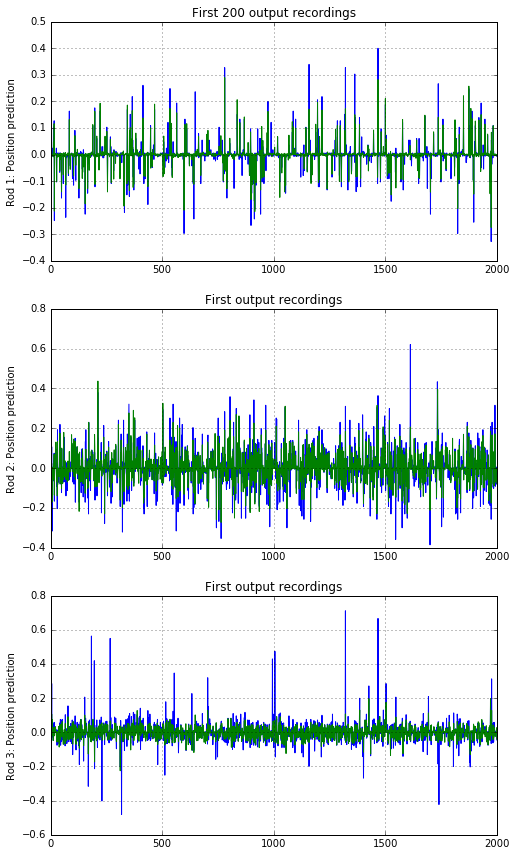

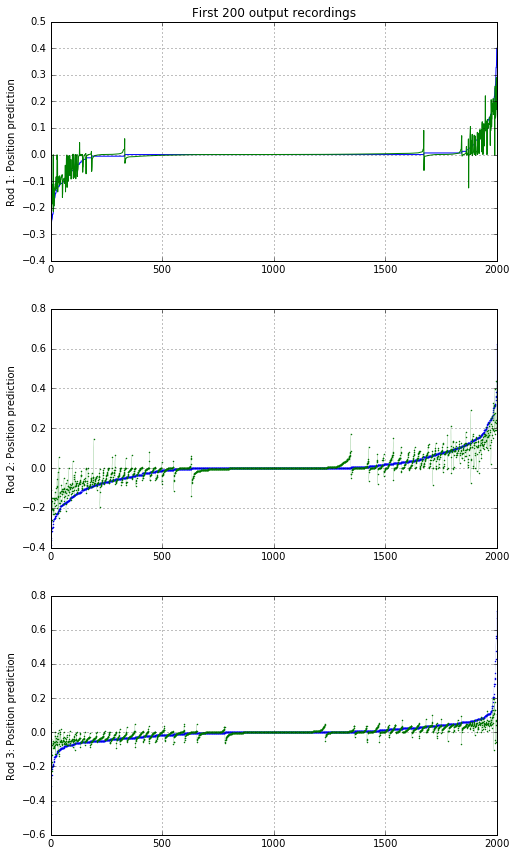

Epoch 80/80
1003/1003 [==============================] - 678s - loss: 0.0028 - mse: 2.7686e-06 - val_loss: 0.0024 - val_mse: 2.3908e-06
Wrote model to dpos_cnn_weights_79.hdf
Epoch 81/81
1003/1003 [==============================] - 679s - loss: 0.0028 - mse: 2.8203e-06 - val_loss: 0.0025 - val_mse: 2.4692e-06
Wrote model to dpos_cnn_weights_80.hdf
Epoch 82/82
1003/1003 [==============================] - 678s - loss: 0.0028 - mse: 2.7985e-06 - val_loss: 0.0025 - val_mse: 2.4892e-06
Wrote model to dpos_cnn_weights_81.hdf
Epoch 83/83
1003/1003 [==============================] - 678s - loss: 0.0028 - mse: 2.7947e-06 - val_loss: 0.0025 - val_mse: 2.4720e-06
Wrote model to dpos_cnn_weights_82.hdf
Epoch 84/84
1003/1003 [==============================] - 678s - loss: 0.0028 - mse: 2.7953e-06 - val_loss: 0.0026 - val_mse: 2.5667e-06
Wrote model to dpos_cnn_weights_83.hdf
Epoch 85/85
1003/1003 [==============================] - 679s - loss: 0.0028 - mse: 2.8188e-06 - val_loss: 0.0024 - val_mse: 

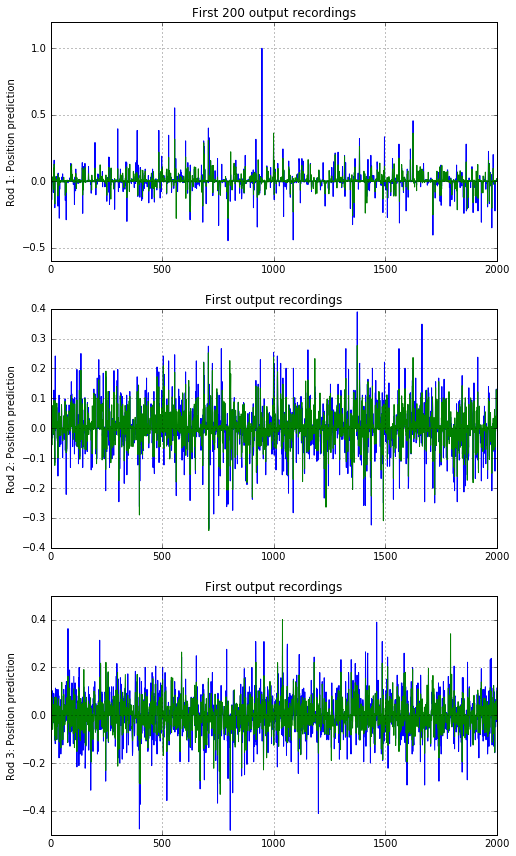

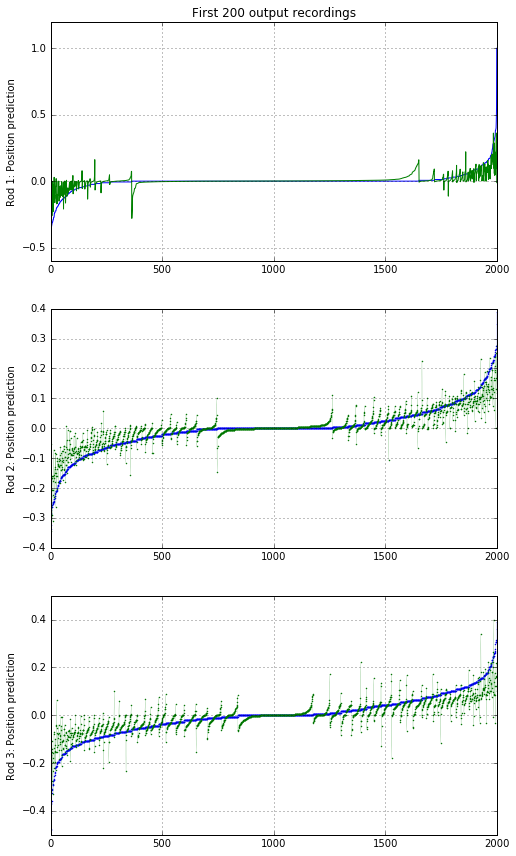

Epoch 86/86
1003/1003 [==============================] - 678s - loss: 0.0028 - mse: 2.8232e-06 - val_loss: 0.0025 - val_mse: 2.4558e-06
Wrote model to dpos_cnn_weights_85.hdf
Epoch 87/87
1003/1003 [==============================] - 678s - loss: 0.0028 - mse: 2.7762e-06 - val_loss: 0.0025 - val_mse: 2.5167e-06
Wrote model to dpos_cnn_weights_86.hdf
Epoch 88/88
1003/1003 [==============================] - 678s - loss: 0.0028 - mse: 2.7843e-06 - val_loss: 0.0027 - val_mse: 2.6603e-06
Wrote model to dpos_cnn_weights_87.hdf
Epoch 89/89
 478/1003 [=============>................] - ETA: 300s - loss: 0.0028 - mse: 2.7860e-06

In [ ]:
# Load the best model result
epoch = 22
WEIGHTS_FNAME = 'dpos_cnn_weights_%i.hdf'
MODELS_FNAME = 'dpos_cnn_models_%i.h5'
model.load_weights(WEIGHTS_FNAME % epoch, by_name=True)
print("Loaded model.")

batch_size = 40
batches_training_per_epoch = int(training.get_training_count() / batch_size)
batches_validation_per_epoch = int(training.get_validation_count() / batch_size)
print("%i training batches, %i validation batches" % (batches_training_per_epoch, batches_validation_per_epoch) )



model.compile(optimizer=keras.optimizers.RMSprop(lr=0.00005),
              loss='mean_squared_error',
              metrics=[mse])
        
for epoch in range(epoch,300):
    try:
        model.fit_generator(TrainBatchGenDpos(batch_size, model, training), batches_training_per_epoch, epochs=epoch+1, verbose=1, callbacks=None, class_weight=None, max_q_size=10, workers=10, validation_data=ValidateBatchGenDpos(batch_size, model, training), validation_steps = batches_validation_per_epoch, pickle_safe=False, initial_epoch=epoch)
        model.save_weights(WEIGHTS_FNAME % epoch)
        model.save(MODELS_FNAME % epoch)
        print(("Wrote model to " + WEIGHTS_FNAME )  % epoch)
        
        if epoch % 6 == 0:
            plot_validate(ValidateBatchGenDpos(batch_size, model, training), model, 2000, "Position prediction")
    except KeyboardInterrupt:
        print("\r\nUser stopped the training.")
        break

In [ ]:
model.compile(optimizer=keras.optimizers.RMSprop(lr=0.000005),
              loss='mean_squared_error',
              metrics=[mse])

print("Updated learner.")

# Train the model to predict the future position. This is the control signal to the robot AI
WEIGHTS_FNAME = 'dpos_cnn_weights_%i.hdf'
MODELS_FNAME = 'dpos_cnn_models_%i.h5'

start_epoch = epoch+1

batches_training_per_epoch = int(training.get_training_count() / batch_size)
batches_validation_per_epoch = int(training.get_validation_count() / batch_size)
print("%i training batches, %i validation batches" % (batches_training_per_epoch, batches_validation_per_epoch) )

for epoch in range(start_epoch,1000):
    try:
        model.fit_generator(TrainBatchGenDpos(batch_size, model, training), batches_training_per_epoch, epochs=epoch+1, verbose=1, callbacks=None, class_weight=None, max_q_size=10, workers=1, validation_data=ValidateBatchGenDpos(batch_size, model, training), validation_steps = batches_validation_per_epoch, pickle_safe=False, initial_epoch=epoch)
        model.save_weights(WEIGHTS_FNAME % epoch)
        model.save(MODELS_FNAME % epoch)
        print(("Wrote model to " + WEIGHTS_FNAME )  % epoch)
    except KeyboardInterrupt:
        print("\r\nUser stopped the training.")
        break

Updated learner.
13001 training batches, 3250 validation batches
Epoch 65/65
   22/13001 [..............................] - ETA: 8147s - loss: 1.3444e-05 - mse: 1.3444e-08

Loaded model.
Predicted.
array([[ 0.27878788,  0.18032786,  0.08108108],
       [ 0.27878788,  0.2090164 ,  0.09189189],
       [ 0.21212122,  0.20491803,  0.08648649],
       ..., 
       [ 0.00606061,  0.0204918 ,  0.        ],
       [-0.02424242, -0.00819672,  0.        ],
       [-0.06060606, -0.04918033,  0.        ]], dtype=float32)
array([[ 0.02229243,  0.01349058,  0.0011873 ],
       [ 0.02725087,  0.01673627,  0.00143984],
       [ 0.02477199,  0.0150937 ,  0.00130292],
       ..., 
       [ 0.01144697,  0.00635366,  0.00058881],
       [ 0.01400868,  0.00803001,  0.00072528],
       [ 0.01272326,  0.00719898,  0.00066527]], dtype=float32)


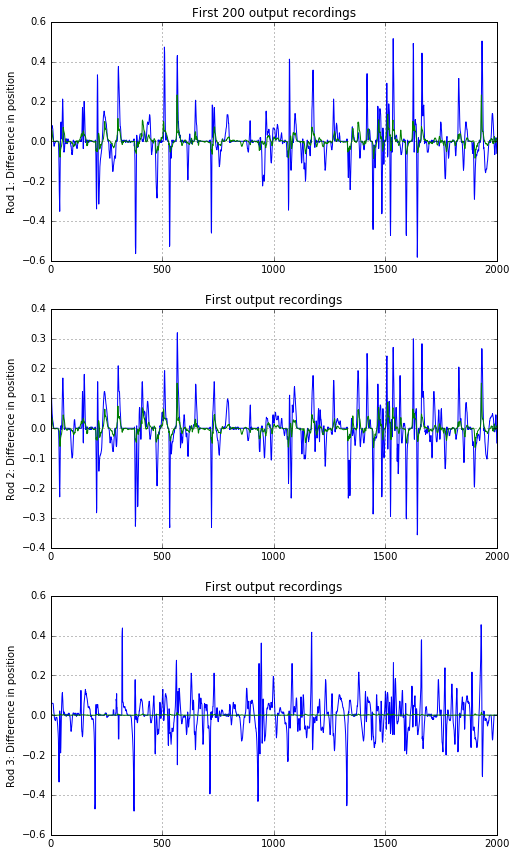

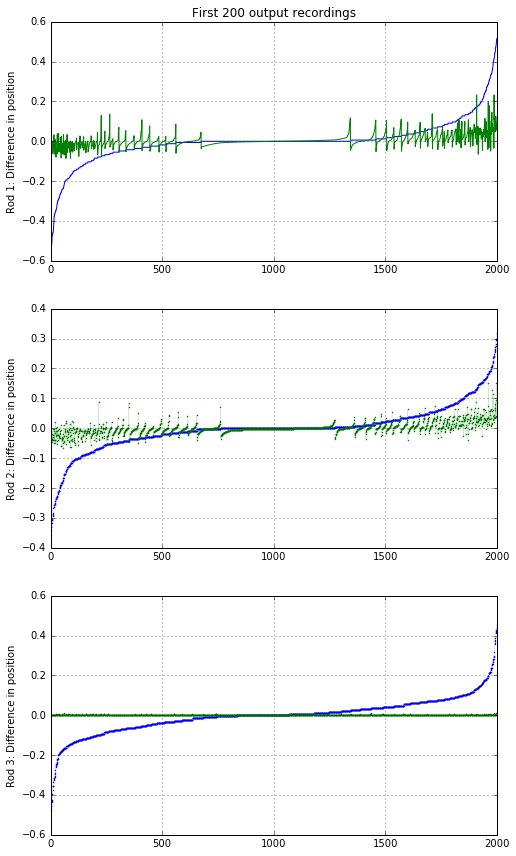

In [5]:
# Load the best position prediction model as the starting point
epoch = 65
WEIGHTS_FNAME = 'dpos_cnn_weights_%i.hdf'
model.load_weights(WEIGHTS_FNAME % epoch)
print("Loaded model.")


# Plot the real versus predicted values for some of the validation data
plot_validate(ValidateBatchGenDpos(batch_size, model, training), model, 2000, "Difference in position")

In [7]:
def mse(y_true, y_pred):
    return K.square(y_pred - y_true)*0.001 # Hackjob so Keras iterations show exponential value of MSE to get precision.


model.compile(optimizer=keras.optimizers.RMSprop(lr=0.000005),
              loss='mean_squared_error',
              metrics=[mse])

print("Updated learner.")
# Plot the real versus predicted values for some of the validation data
plot_validate(ValidateBatchGenDpos(batch_size, model, training), model, 2000, "Difference in position")

# Train the model to predict the future position. This is the control signal to the robot AI
WEIGHTS_FNAME = 'dpos_cnn_weights_%i.hdf'
MODELS_FNAME = 'dpos_cnn_models_%i.h5'

start_epoch = epoch+1

batches_training_per_epoch = int(training.get_training_count() / batch_size)
batches_validation_per_epoch = int(training.get_validation_count() / batch_size)
print("%i training batches, %i validation batches" % (batches_training_per_epoch, batches_validation_per_epoch) )

for epoch in range(start_epoch,1000):
    try:
        model.fit_generator(TrainBatchGenDpos(batch_size, model, training), batches_training_per_epoch, epochs=epoch+1, verbose=1, callbacks=None, class_weight=None, max_q_size=10, workers=1, validation_data=ValidateBatchGenDpos(batch_size, model, training), validation_steps = batches_validation_per_epoch, pickle_safe=False, initial_epoch=epoch)
        model.save_weights(WEIGHTS_FNAME % epoch)
        model.save(MODELS_FNAME % epoch)
        print(("Wrote model to " + WEIGHTS_FNAME )  % epoch)
    except KeyboardInterrupt:
        print("\r\nUser stopped the training.")
        break

Updated learner.
13001 training batches, 3250 validation batches
Epoch 67/67
13001/13001 [==============================] - 5323s - loss: 0.2048 - mse: 2.0478e-04 - val_loss: 0.0776 - val_mse: 7.7579e-05
Wrote model to dpos_cnn_weights_66.hdf
Epoch 68/68
13001/13001 [==============================] - 5309s - loss: 0.2048 - mse: 2.0477e-04 - val_loss: 0.0774 - val_mse: 7.7411e-05
Wrote model to dpos_cnn_weights_67.hdf
Epoch 69/69
13001/13001 [==============================] - 5316s - loss: 0.2047 - mse: 2.0470e-04 - val_loss: 0.0773 - val_mse: 7.7272e-05
Wrote model to dpos_cnn_weights_68.hdf
Epoch 70/70
13001/13001 [==============================] - 5320s - loss: 0.2050 - mse: 2.0500e-04 - val_loss: 0.0774 - val_mse: 7.7436e-05
Wrote model to dpos_cnn_weights_69.hdf
Epoch 71/71
13001/13001 [==============================] - 5324s - loss: 0.2046 - mse: 2.0461e-04 - val_loss: 0.0771 - val_mse: 7.7052e-05
Wrote model to dpos_cnn_weights_70.hdf
Epoch 72/72
13001/13001 [====================

Predicted.
array([[ 0.27878788,  0.18032786,  0.08108108],
       [ 0.27878788,  0.2090164 ,  0.09189189],
       [ 0.21212122,  0.20491803,  0.08648649],
       ..., 
       [ 0.00606061,  0.0204918 ,  0.        ],
       [-0.02424242, -0.00819672,  0.        ],
       [-0.06060606, -0.04918033,  0.        ]], dtype=float32)
array([[-0.00047428,  0.02268423,  0.00596448],
       [-0.000603  ,  0.03013376,  0.00790049],
       [-0.0006315 ,  0.03177239,  0.00832323],
       ..., 
       [-0.00038064,  0.0173836 ,  0.00459988],
       [-0.00052151,  0.02541526,  0.00668655],
       [-0.00051625,  0.02500132,  0.00655897]], dtype=float32)


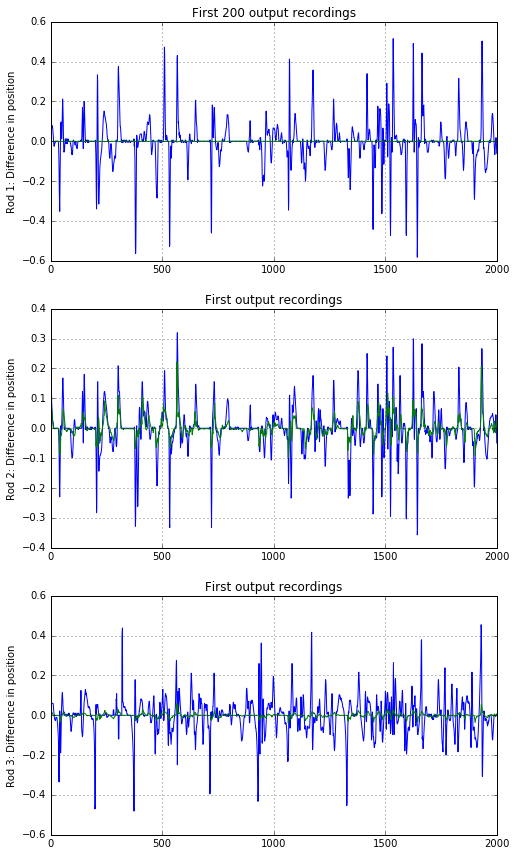

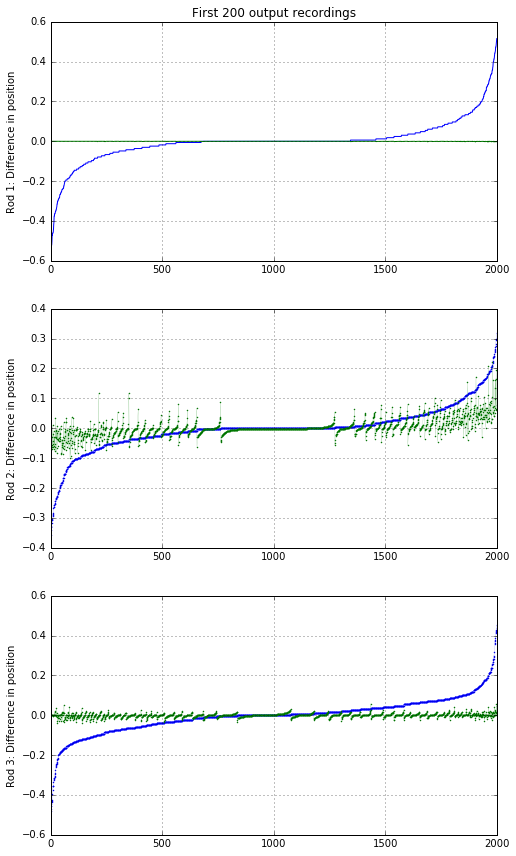

In [8]:

# Plot the real versus predicted values for some of the validation data
plot_validate(ValidateBatchGenDpos(batch_size, model, training), model, 2000, "Difference in position")